<a href="https://colab.research.google.com/github/gdmeyerp/Analisis_de_bases_de_Datos/blob/main/Proyecto_Entrega_Final.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# ***Implementación y análisis de bases de datos relacionales para un hotel.***


##1.  **Introduccion**




En este proyecto, nos centraremos en la creación de una base de datos completa para la gestión de un hotel, esta gestionara la administración de sus operaciones,ademas esta también se enriquecerá con la recopilación y análisis de datos relacionados con el turismo y el flujo de personas en áreas específicas. Además, exploraremos la posibilidad de integrar la inteligencia artificial de manera experimental, a través de técnicas de aprendizaje automático utilizando TensorFlow y Keras, con el objetivo de generar predicciones que puedan respaldar la toma de decisiones estratégicas.



###1.1 **Objetivos del proyecto**





* **Diseño de la Base de Datos del Hotel**: Comenzaremos
con la creación de una base de datos para gestionar todos los aspectos de la operación del hotel, incluyendo información de huéspedes, reservas, habitaciones, personal y servicios. Se implementarán relaciones y restricciones para garantizar la integridad de los datos.
* **Recopilación de Datos Públicos Relacionados con el
Turismo**: se llevara a cabo la extracción de datos públicos disponibles en línea, como estadísticas de turismo,
eventos locales y atracciones turísticas. Estos datos se
integrarán en nuestra base de datos para obtener una visión más completa del entorno turístico
* **Análisis de Datos**: Utilizaremos técnicas estadísticas
avanzadas para analizar los datos recopilados, identificar tendencias y patrones relevantes, y comprender
mejor los factores que influyen en la demanda de habitaciones y la rentabilidad del hotel.
* **Predicciones con Aprendizaje Automático (Exploratorio)**: Experimentaremos con modelos de aprendizaje automático utilizando TensorFlow y Keras para explorar la capacidad de generar predicciones sobre variables cruciales para el negocio hotelero, como la ocupación del hotel, el precio óptimo de las habitaciones y la satisfacción del cliente.

###1.1 **librerias usadas en el proyecto**


* import sqlite3
* import pandas as pd
* faker
* selenium
* matplotlib



##2. Diseño de la Base de Datos del Hotel





###2.1 Tablas


* Clientes(Dni_Cliente, Nombre, Apellido, Direccion, Telefono, Email, Fecha_nacimiento)
* Habitaciones(Id_habitacion, Id_sede, Tipo, Precio_noche, Estado, Capacidad, Numero_habitacion)
* Reservas(Id_reserva, Dni_Cliente, Id_habitacion, Fecha_inicio, Fecha_fin, Numero_personas, fecha_nacimiento, Id_registro)
* Empleados(Dni_empleado, Id_sede, Nombre, Apellido, Id_cargo, fecha_contratacion, email)
* Servicios(Id_servicio, Descripcion, Precio, Categoria)
* Servicios_Reservas(Id_servicio_reserva, Id_reserva, Id_servicio, Id_registro)
* Proveedores(Id_proveedor, Nombre, Telefono, Direccion, Email)
* Inventario(Id_inventario, Id_proveedor, Producto, Cantidad, Fecha_ingreso, Precio_unitario, Fecha_vencimiento, Id_registro)
* Mantenimiento(Id_mantenimiento, Id_habitacion, Id_inventario, Fecha, Descripcion, Costo, Id_registro)
* Menu(Id_menu, descripcion, precio)
* Ordenes_Menu(Id_orden, Id_reserva, Id_menu, Dni_Cliente, Fecha, Precio, Id_registro)
* Contabilidad(Id_registro, Fecha, Descripción, Monto, Tipo_transaccion, Categoria)
* Gastos_operativos(Id_gasto, Fecha, Descripcion, Monto, Id_registro)
* Presupuestos(Id_presupuesto, Descripcion, Monto_estimado, Fecha_inicio, Fecha_fin, Estado)  [Sin relación directa con Contabilidad]
* Facturas_Clientes(Id_factura, Dni_Cliente, Id_reserva, Fecha, Monto_total, Metodo_pago, Estado, Id_registro)
* Cargos(Id_cargo, Puesto, Salario)
* Salarios_empleados(Id_cargo, Fecha_pago, Monto, Método_pago, Id_registro)
* Sedes(Id_sede, Nombre, Direccion, Ciudad, Telefono, Email, Num_empleados)
* Afiliaciones_Clientes(Id_afiliacion, Dni_Cliente, Id_tipo, Fecha_inicio, Fecha_fin)
* Tipo_Afiliacion(Id_tipo, Categoria, Costo)
* Promociones_Ofertas(Id_promocion, Id_tipo, Descripcion, Fecha_inicio, Fecha_fin, Descuento)
* Feedback_Clientes(Id_feedback, Id_cliente, Fecha, Comentario, Valoracion)
* Programas_beneficios(Id_beneficios, Id_tipo, Id_servicio)




###2.2 Relaciones entre tablas

* Sedes: No depende de ninguna otra tabla.
* Tipo_Afiliacion: No tiene dependencias.
* Cargos: No tiene dependencias.
* Habitaciones: Depende de Sedes.
* Proveedores: No tiene dependencias.
* Inventario: Depende de Proveedores.
* Clientes: No tiene dependencias.
* Afiliaciones_Clientes: Depende de Clientes y Tipo_Afiliacion.
* Empleados: Depende de Sedes y Cargos.
* Salarios_empleados: Depende de Cargos.
* Servicios: No tiene dependencias.
* Reservas: Depende de Clientes y Habitaciones.
* Servicios_Reservas: Depende de Reservas y Servicios.
* Mantenimiento: Depende de Habitaciones y Inventario.
* Menu: No tiene dependencias.
* Ordenes_Menu: Depende de Reservas, Menu y Clientes.
* Promociones_Ofertas: Depende de Tipo_Afiliacion.
* Facturas_Clientes: Depende de Clientes y Reservas.
* Gastos_operativos: No tiene dependencias.
* Presupuestos: No tiene dependencias, aunque podría relacionarse con Gastos_operativos si se desea.
* Feedback_Clientes: Depende de Clientes.
* Programas_beneficios: Depende de Tipo_Afiliacion y Servicios.
* Contabilidad: Esta tabla registrará movimientos financieros, por lo que se llenará a medida que se generen datos en tablas que representen movimientos financieros (como Reservas, Ordenes_Menu, Mantenimiento, Facturas_Clientes, Gastos_operativos, entre otros).

###2.3 Diagrama esquema relacional



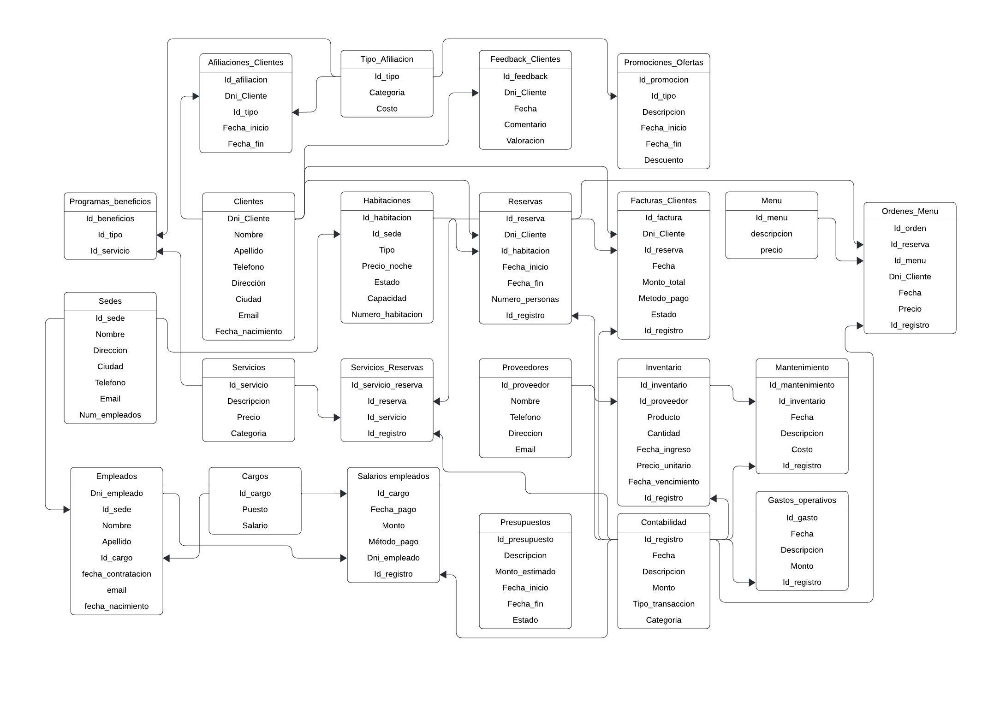

##3. Implementacion base de datos en SQL


###3.1 Creacion base de datos SQLite

In [ ]:
import sqlite3  #importamos la base de datos
from sqlite3 import Error
from datetime import datetime   #fechas y tiempos

def conexion_db():  #Crea Base de datos y conexion con la base de datos
    try:
        con = sqlite3.connect('AnalisisBD.db')
        return con
    except Error:
        print(Error)

def CrearTablaClientes(con):
    cursorObj = con.cursor()
    cadena = '''CREATE TABLE Clientes (
            Dni_Cliente INTEGER,
            Nombre TEXT,
            Apellido TEXT,
            Direccion TEXT,
            Telefono TEXT,
            Email TEXT,
            Fecha_nacimiento TEXT,
            PRIMARY KEY (Dni_Cliente)
        )'''
    cursorObj.execute(cadena)  # Ejecutar cadena de comandos SQL
    con.commit()  # Guardar persistencia en el disco

def CrearTablaHabitaciones(con):
    cursorObj = con.cursor()
    cadena = '''CREATE TABLE Habitaciones (
            Id_habitacion INTEGER,
            Id_sede INTEGER,
            Tipo TEXT,
            Precio_noche INTEGER,
            Estado TEXT,
            Capacidad INTEGER,
            Numero_habitacion INTEGER,
            PRIMARY KEY (Id_habitacion),
            FOREIGN KEY (Id_sede) REFERENCES Sedes (Id_sede)
        )'''
    cursorObj.execute(cadena)  # Ejecutar cadena de comandos SQL
    con.commit()  # Guardar persistencia en el disco

def CrearTablaReservas(con):
    cursorObj = con.cursor()
    cadena = '''CREATE TABLE Reservas (
            Id_reserva INTEGER,
            Dni_Cliente INTEGER,
            Id_habitacion INTEGER,
            Fecha_inicio TEXT,
            Fecha_fin TEXT,
            Numero_personas INTEGER,
            PRIMARY KEY (Id_reserva),
            FOREIGN KEY (Dni_Cliente) REFERENCES Clientes (Dni_Cliente),
            FOREIGN KEY (Id_habitacion) REFERENCES Habitaciones (Id_habitacion)
        )'''
    cursorObj.execute(cadena)  # Ejecutar cadena de comandos SQL
    con.commit()  # Guardar persistencia en el disco


def CrearTablaEmpleados(con):
    cursorObj = con.cursor()
    cadena = '''CREATE TABLE Empleados (
            Dni_empleado INTEGER,
            Id_sede INTEGER,
            Nombre TEXT,
            Apellido TEXT,
            Id_cargo INTEGER,
            fecha_contratacion TEXT,
            email TEXT,
            fecha_nacimiento TEXT,
            PRIMARY KEY (Dni_empleado),
            FOREIGN KEY (Id_sede) REFERENCES Sedes (Id_sede)
        )'''
    cursorObj.execute(cadena)  # Ejecutar cadena de comandos SQL
    con.commit()  # Guardar persistencia en el disco

def CrearTablaServicios(con):
    cursorObj = con.cursor()
    cadena = '''CREATE TABLE Servicios (
            Id_servicio INTEGER,
            Descripcion TEXT,
            Precio INTEGER,
            Categoria TEXT,
            PRIMARY KEY (Id_servicio)
        )'''
    cursorObj.execute(cadena)  # Ejecutar cadena de comandos SQL
    con.commit()  # Guardar persistencia en el disco

def CrearTablaServiciosReservas(con):
    cursorObj = con.cursor()
    cadena = '''CREATE TABLE Servicios_Reservas (
            Id_servicio_reserva INTEGER,
            Id_reserva INTEGER,
            Id_servicio INTEGER,
            PRIMARY KEY (Id_servicio_reserva),
            FOREIGN KEY (Id_reserva) REFERENCES Reservas (Id_reserva),
            FOREIGN KEY (Id_servicio) REFERENCES Servicios (Id_servicio)
        )'''
    cursorObj.execute(cadena)  # Ejecutar cadena de comandos SQL
    con.commit()  # Guardar persistencia en el disco

def CrearTablaProveedores(con):
    cursorObj = con.cursor()
    cadena = '''CREATE TABLE Proveedores (
            Id_proveedor INTEGER,
            Nombre TEXT,
            Telefono TEXT,
            Direccion TEXT,
            Email TEXT,
            PRIMARY KEY (Id_proveedor)
        )'''
    cursorObj.execute(cadena)  # Ejecutar cadena de comandos SQL
    con.commit()  # Guardar persistencia en el disco

def CrearTablaInventario(con):
    cursorObj = con.cursor()
    cadena = '''CREATE TABLE Inventario (
            Id_inventario INTEGER,
            Id_proveedor INTEGER,
            Producto TEXT,
            Cantidad INTEGER,
            Fecha_ingreso TEXT,
            Precio_unitario INTEGER,
            Fecha_vencimiento TEXT,
            PRIMARY KEY (Id_inventario),
            FOREIGN KEY (Id_proveedor) REFERENCES Proveedores (Id_proveedor)
        )'''
    cursorObj.execute(cadena)  # Ejecutar cadena de comandos SQL
    con.commit()  # Guardar persistencia en el disco

def CrearTablaMantenimiento(con):
    cursorObj = con.cursor()
    cadena = '''CREATE TABLE Mantenimiento (
            Id_mantenimiento INTEGER,
            Id_inventario INTEGER,
            Fecha TEXT,
            Descripcion TEXT,
            Costo INTEGER,
            PRIMARY KEY (Id_inventario),
            FOREIGN KEY (Id_inventario) REFERENCES Inventario (Id_inventario)
        )'''
    cursorObj.execute(cadena)  # Ejecutar cadena de comandos SQL
    con.commit()  # Guardar persistencia en el disco

def CrearTablaMenu(con):
    cursorObj = con.cursor()
    cadena = '''CREATE TABLE Menu (
            Id_menu INTEGER,
            descripcion TEXT,
            precio INTEGER,
            PRIMARY KEY (Id_menu)
        )'''
    cursorObj.execute(cadena)  # Ejecutar cadena de comandos SQL
    con.commit()  # Guardar persistencia en el disco

def CrearTablaOrdenesMenu(con):
    cursorObj = con.cursor()
    cadena = '''CREATE TABLE Ordenes_Menu (
            Id_orden INTEGER,
            Id_reserva INTEGER,
            Id_menu INTEGER,
            Dni_Cliente TEXT,
            Fecha TEXT,
            Precio INTEGER,
            PRIMARY KEY (Id_orden),
            FOREIGN KEY (Id_reserva) REFERENCES Reservas (Id_reserva),
            FOREIGN KEY (Id_menu) REFERENCES Menu (Id_menu)
        )'''
    cursorObj.execute(cadena)  # Ejecutar cadena de comandos SQL
    con.commit()  # Guardar persistencia en el disco

def CrearTablaContabilidad(con):
    cursorObj = con.cursor()
    cadena = '''CREATE TABLE Contabilidad (
            Id_registro INTEGER,
            Fecha TEXT,
            Descripcion TEXT,
            Monto INTEGER,
            Tipo_transaccion TEXT,
            Categoria TEXT,
            PRIMARY KEY (Id_registro)
        )'''
    cursorObj.execute(cadena)  # Ejecutar cadena de comandos SQL
    con.commit()  # Guardar persistencia en el disco

def CrearTablaGastosOperativos(con):
    cursorObj = con.cursor()
    cadena = '''CREATE TABLE Gastos_operativos (
            Id_gasto INTEGER,
            Fecha TEXT,
            Descripcion TEXT,
            Monto INTEGER,
            PRIMARY KEY (Id_gasto)
        )'''
    cursorObj.execute(cadena)  # Ejecutar cadena de comandos SQL
    con.commit()  # Guardar persistencia en el disco

def CrearTablaPresupuestos(con):
    cursorObj = con.cursor()
    cadena = '''CREATE TABLE Presupuestos (
            Id_presupuesto INTEGER,
            Descripcion TEXT,
            Monto_estimado INTEGER,
            Fecha_inicio TEXT,
            Fecha_fin TEXT,
            Estado TEXT,
            PRIMARY KEY (Id_presupuesto)
        )'''
    cursorObj.execute(cadena)  # Ejecutar cadena de comandos SQL
    con.commit()  # Guardar persistencia en el disco

def CrearTablaFacturasClientes(con):
    cursorObj = con.cursor()
    cadena = '''CREATE TABLE Facturas_Clientes (
            Id_factura INTEGER,
            Dni_Cliente TEXT,
            Id_reserva INTEGER,
            Fecha TEXT,
            Monto_total INTEGER,
            Metodo_pago TEXT,
            Estado TEXT,
            PRIMARY KEY (Id_factura),
            FOREIGN KEY (Id_reserva) REFERENCES Reservas (Id_reserva),
            FOREIGN KEY (Dni_Cliente) REFERENCES Clientes (Dni_Cliente)
        )'''
    cursorObj.execute(cadena)  # Ejecutar cadena de comandos SQL
    con.commit()  # Guardar persistencia en el disco

def CrearTablaCargos(con):
    cursorObj = con.cursor()
    cadena = '''CREATE TABLE Cargos (
            Id_cargo INTEGER,
            Puesto TEXT,
            Salario INTEGER,
            PRIMARY KEY (Id_cargo)
        )'''
    cursorObj.execute(cadena)  # Ejecutar cadena de comandos SQL
    con.commit()  # Guardar persistencia en el disco

def CrearTablaSalariosempleados(con):
    cursorObj = con.cursor()   #Recorremos la BD con el objeto de conexion
    cadena = '''CREATE TABLE IF NOT EXISTS Salariosempleados(
                Id_cargo INTEGER NOT NULL,
                Fecha_pago DATE,
                Monto INTEGER NOT NULL,
                Método_pago INTEGER NOT NULL,
                Dni_empleado INTEGER NOT NULL,
                FOREIGN KEY (Id_cargo) REFERENCES Cargos (Id_cargo),
                FOREIGN KEY (Dni_empleado) REFERENCES Empleados (Dni_empleado)
                )'''
    cursorObj.execute(cadena)  #Ejecutar cadena de comandos sql
    con.commit()  #Guardar persistencia en el disco

def CrearTablaSedes(con):
    cursorObj = con.cursor()
    cadena = '''CREATE TABLE Sedes (
            Id_sede INTEGER,
            Nombre TEXT,
            Direccion TEXT,
            Ciudad TEXT,
            Telefono TEXT,
            Email TEXT,
            Num_empleados INTEGER,
            PRIMARY KEY (Id_sede)
        )'''
    cursorObj.execute(cadena)  #Ejecutar cadena de comandos sql
    con.commit()  #Guardar persistencia en el disco

def CrearTablaAfiliacionesClientes(con):
    cursorObj = con.cursor()
    cadena = '''CREATE TABLE Afiliaciones_Clientes (
            Id_afiliacion INTEGER,
            Dni_Cliente TEXT,
            Id_tipo INTEGER,
            Fecha_inicio DATE,
            Fecha_fin DATE,
            PRIMARY KEY (Id_afiliacion),
            FOREIGN KEY (Dni_Cliente) REFERENCES Clientes (Dni_Cliente)
        )'''
    cursorObj.execute(cadena)  # Ejecutar cadena de comandos SQL
    con.commit()  # Guardar persistencia en el disco

def CrearTablaTipoAfiliacion(con):
    cursorObj = con.cursor()
    cadena = '''CREATE TABLE Tipo_Afiliacion (
            Id_tipo INTEGER,
            Categoria TEXT,
            Costo INTEGER,
            PRIMARY KEY (Id_tipo)
        )'''
    cursorObj.execute(cadena)  # Ejecutar cadena de comandos SQL
    con.commit()  # Guardar persistencia en el disco

def CrearTablaPromocionesOfertas(con):
    cursorObj = con.cursor()
    cadena = '''CREATE TABLE Promociones_Ofertas (
            Id_promocion INTEGER,
            Id_tipo INTEGER,
            Descripcion TEXT,
            Fecha_inicio DATE,
            Fecha_fin DATE,
            Descuento INTEGER,
            PRIMARY KEY (Id_promocion),
            FOREIGN KEY (Id_tipo) REFERENCES Tipo_Afiliacion (Id_tipo)
        )'''
    cursorObj.execute(cadena)  # Ejecutar cadena de comandos SQL
    con.commit()  # Guardar persistencia en el disco

def CrearTablaFeedbackClientes(con):
    cursorObj = con.cursor()
    cadena = '''CREATE TABLE Feedback_Clientes (
            Id_feedback INTEGER,
            Id_cliente INTEGER,
            Fecha DATE,
            Comentario TEXT,
            Valoracion INTEGER,
            PRIMARY KEY (Id_feedback),
            FOREIGN KEY (Id_cliente) REFERENCES Clientes (Dni_Cliente)
        )'''
    cursorObj.execute(cadena)  # Ejecutar cadena de comandos SQL
    con.commit()  # Guardar persistencia en el disco

def CrearTablaProgramasBeneficios(con):
    cursorObj = con.cursor()
    cadena = '''CREATE TABLE Programas_beneficios (
            Id_beneficios INTEGER,
            Id_tipo INTEGER,
            Id_servicio INTEGER,
            PRIMARY KEY (Id_beneficios),
            FOREIGN KEY (Id_tipo) REFERENCES Tipo_Afiliacion (Id_tipo),
            FOREIGN KEY (Id_servicio) REFERENCES Servicios (Id_servicio)
        )'''
    cursorObj.execute(cadena)  # Ejecutar cadena de comandos SQL
    con.commit()  # Guardar persistencia en el disco

def cerrarConexionBD(con):  #En esta funcion cerraremos la conexion con la base de datos
    con.close()

def crearTodasTablas():
    conex=conexion_db()
    CrearTablaClientes(conex)
    CrearTablaHabitaciones(conex)
    CrearTablaReservas(conex)
    CrearTablaEmpleados(conex)
    CrearTablaServicios(conex)
    CrearTablaServiciosReservas(conex)
    CrearTablaProveedores(conex)
    CrearTablaInventario(conex)
    CrearTablaMantenimiento(conex)
    CrearTablaMenu(conex)
    CrearTablaOrdenesMenu(conex)
    CrearTablaContabilidad(conex)
    CrearTablaGastosOperativos(conex)
    CrearTablaPresupuestos(conex)
    CrearTablaFacturasClientes(conex)
    CrearTablaCargos(conex)
    CrearTablaSalariosempleados(conex)
    CrearTablaSedes(conex)
    CrearTablaAfiliacionesClientes(conex)
    CrearTablaTipoAfiliacion(conex)
    CrearTablaPromocionesOfertas(conex)
    CrearTablaFeedbackClientes(conex)
    CrearTablaProgramasBeneficios(conex)
    cerrarConexionBD(conex)

def main():  #Aca definimos que se va a ejecutar
    crearTodasTablas()
main()  #Ejecutamos el main


###3.2 Generacion de datos

In [ ]:
!pip install faker

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 12.9 MB/s eta 0:00:00


In [ ]:
unique_registro_ids = set()

####3.2.1 Sedes

In [ ]:
import pandas as pd
from faker import Faker
import random

# Adjusting the code to ensure each city is unique for each sede

# Re-initializing Faker with the correct locale
fake = Faker('es_CO')

# Principales ciudades de Colombia
ciudades_colombia = ["Bogotá", "Medellín", "Cartagena", "Santa Marta", "San Andres"]

# Número de sedes
num_sedes = 5

# Lista para almacenar datos
sedes_data = []

# Generando IDs aleatorios únicos
ids_unicos = random.sample(range(1000, 9999), num_sedes)  # Números aleatorios de 4 dígitos

# Conjuntos para evitar repeticiones
nombres_usados, direcciones_usadas, telefonos_usados, emails_usados = set(), set(), set(), set()

# Mezclando las ciudades para asignarlas de manera única
ciudades_aleatorias = random.sample(ciudades_colombia, len(ciudades_colombia))

for i in range(num_sedes):
    nombre = fake.unique.company()
    while nombre in nombres_usados:
        nombre = fake.unique.company()
    nombres_usados.add(nombre)

    direccion = fake.unique.address().replace("\n", ", ")
    while direccion in direcciones_usadas:
        direccion = fake.unique.address().replace("\n", ", ")
    direcciones_usadas.add(direccion)

    telefono = fake.unique.phone_number()
    while telefono in telefonos_usados:
        telefono = fake.unique.phone_number()
    telefonos_usados.add(telefono)

    email = fake.unique.company_email()
    while email in emails_usados:
        email = fake.unique.company_email()
    emails_usados.add(email)

    sede = {
        "Id_sede": ids_unicos[i],
        "Nombre": nombre,
        "Direccion": direccion,
        "Ciudad": ciudades_aleatorias[i],  # Asignar una ciudad única
        "Telefono": telefono,
        "Email": email,
        "Num_empleados": random.randint(24, 26)
    }
    sedes_data.append(sede)

sedes = pd.DataFrame(sedes_data)
sedes.head(10)



,Id_sede,Nombre,Direccion,Ciudad,Telefono,Email,Num_empleados
0,2316,Hernández-Gómez,"Cl. 75 # 1-4 Sur, 153113, Caldas, Boyacá",Cartagena,573166859050,ypinzon@lopez.org,25
1,5695,Vargas-Soto,"Cl. 51 # 9-4 Este, Apartamento 40, 185188, Flo...",Medellín,(+57)3206604746,carmen19@jaramillo-garcia.info,25
2,1860,"Ceballos, Ramos and Cruz","Cr. 158 # 31N-51, 762728, Versalles, Valle del...",Santa Marta,573235901290,marlenymelo@sanabria.info,26
3,6450,Obando-Gutiérrez,"Carrera 163 # 2X-68, 504357, Cumaral, Meta",San Andres,+576083356616,bluna@osorio.com,24
4,7230,"Luna, Pacheco and Sánchez","Carrera 159G Bis # 8-2, Apartamento 145, 50419...",Bogotá,3251401481,scontreras@camacho.net,25


In [ ]:
import sqlite3
import pandas as pd
import faker
import random

# Inicializar Faker
fake = Faker('es_CO')

# Principales ciudades de Colombia
ciudades_colombia = ["Bogotá", "Medellín", "Cali", "Barranquilla", "Cartagena", "Cúcuta", "Bucaramanga",
                     "Pereira", "Santa Marta", "Ibagué", "Pasto", "Manizales", "Neiva", "Armenia", "Villavicencio"]

# Conectar a la base de datos
conn = sqlite3.connect('AnalisisBD.db')

# Crear un cursor
cursor = conn.cursor()

# Número de sedes
num_sedes = 5

# Lista para almacenar datos simulados de las sedes
sedes_data = []

# Generando IDs aleatorios únicos
ids_unicos = random.sample(range(1000, 9999), num_sedes)  # Números aleatorios de 4 dígitos

for i in range(num_sedes):
    sede = {
        "Id_sede": ids_unicos[i],  # Asignando ID aleatorio
        "Nombre": fake.company(),
        "Direccion": fake.address().replace("\n", ", "),  # Reemplazando saltos de línea
        "Ciudad": random.choice(ciudades_colombia),  # Seleccionando una ciudad aleatoria de la lista
        "Telefono": fake.phone_number(),
        "Email": fake.company_email(),
        "Num_empleados": random.randint(10, 24)
    }
    sedes_data.append(sede)

# DataFrame de las sedes
sedes_df = pd.DataFrame(sedes_data)
print(sedes_df)

# Insertar los datos de las sedes en la tabla "Sedes"
for sede in sedes_data:
    consulta = '''
    INSERT INTO Sedes (Id_sede, Nombre, Direccion, Ciudad, Telefono, Email, Num_empleados)
    VALUES (?, ?, ?, ?, ?, ?, ?)
    '''
    cursor.execute(consulta, (sede['Id_sede'], sede['Nombre'], sede['Direccion'], sede['Ciudad'], sede['Telefono'], sede['Email'], sede['Num_empleados']))

# Guardar los cambios en la base de datos
conn.commit()

# Cerrar la conexión a la base de datos
conn.close()


####3.2.2 Tipos de afiliacion


In [ ]:
# Lista de tipos de afiliaciones posibles con categorías y costos
tipos_afiliacion = [
    {"Categoria": "Platino", "Costo": 500000},
    {"Categoria": "Oro", "Costo": 300000},
    {"Categoria": "Plata", "Costo": 200000},
    {"Categoria": "Bronce", "Costo": 100000},
    {"Categoria": "Básico", "Costo": 50000}
]

# Lista para almacenar datos simulados
tipo_afiliacion_data = []

# Generando IDs aleatorios únicos
ids_unicos_afiliacion = random.sample(range(100, 999), len(tipos_afiliacion))  # Números aleatorios de 3 dígitos

for i, tipo in enumerate(tipos_afiliacion):
    afiliacion = {
        "Id_tipo": ids_unicos_afiliacion[i],
        "Categoria": tipo["Categoria"],
        "Costo": tipo["Costo"]
    }
    tipo_afiliacion_data.append(afiliacion)

tipo_afiliacion = pd.DataFrame(tipo_afiliacion_data)
tipo_afiliacion.head()


,Id_tipo,Categoria,Costo
0,188,Platino,500000
1,969,Oro,300000
2,759,Plata,200000
3,241,Bronce,100000
4,959,Básico,50000


In [ ]:
import sqlite3
import pandas as pd
import random

# Conectar a la base de datos
conn = sqlite3.connect('AnalisisBD.db')

# Crear un cursor
cursor = conn.cursor()

# Lista para almacenar datos simulados
tipo_afiliacion_data = []
# Insertar los datos de tipos de afiliación en la tabla "TiposAfiliacion"
for afiliacion in tipo_afiliacion_data:
    consulta = '''
    INSERT INTO Tipo_Afiliacion (Id_tipo, Categoria, Costo)
    VALUES (?, ?, ?)
    '''
    cursor.execute(consulta, (afiliacion['Id_tipo'], afiliacion['Categoria'], afiliacion['Costo']))

# Guardar los cambios en la base de datos
conn.commit()

# Cerrar la conexión a la base de datos
conn.close()


####3.2.3 Cargos

In [ ]:
# Lista de posibles cargos en un hotel con una estructura jerárquica
# Lista de posibles cargos en un hotel con una estructura jerárquica
cargos_listado = [
    {"Puesto": "Gerente General", "Salario": random.randint(5000000, 7000000), "Cantidad": 1},
    {"Puesto": "Subgerente", "Salario": random.randint(4000000, 5000000), "Cantidad": 5},
    {"Puesto": "Jefe de Recepción", "Salario": random.randint(3000000, 4000000), "Cantidad": 5},
    {"Puesto": "Recepcionista", "Salario": random.randint(1500000, 2500000), "Cantidad": 10},
    {"Puesto": "Jefe de Mantenimiento", "Salario": random.randint(2500000, 3500000), "Cantidad": 5},
    {"Puesto": "Técnico de Mantenimiento", "Salario": random.randint(1500000, 2500000), "Cantidad": 10},
    {"Puesto": "Jefe de Limpieza", "Salario": random.randint(2000000, 3000000), "Cantidad": 5},
    {"Puesto": "Personal de Limpieza", "Salario": random.randint(1000000, 2000000), "Cantidad": 30},
    {"Puesto": "Jefe de Cocina", "Salario": random.randint(3000000, 4000000), "Cantidad": 5},
    {"Puesto": "Cocinero", "Salario": random.randint(1500000, 2500000), "Cantidad": 14},
    {"Puesto": "Mesero", "Salario": random.randint(1000000, 1500000), "Cantidad": 16},
    {"Puesto": "Barman", "Salario": random.randint(1500000, 2500000), "Cantidad": 10},
    {"Puesto": "Jefe de Seguridad", "Salario": random.randint(2500000, 3500000), "Cantidad": 5},
    {"Puesto": "Guardia de Seguridad", "Salario": random.randint(1500000, 2000000), "Cantidad": 10}
]

# Lista para almacenar datos simulados
cargos_data = []
unique_cargo_ids = set()  # Conjunto para garantizar IDs únicos de cargos

# Generar datos para cargos
for cargo in cargos_listado:
    # Generar ID único para el cargo
    while True:
        id_cargo = fake.unique.random_int(min=1000, max=9999)
        if id_cargo not in unique_cargo_ids:
            unique_cargo_ids.add(id_cargo)
            break

    cargo_data = {
        "Id_cargo": id_cargo,
        "Puesto": cargo["Puesto"],
        "Salario": cargo["Salario"],
        "Cantidad": cargo["Cantidad"]  # Ahora incluimos la cantidad
    }
    cargos_data.extend([cargo_data] * cargo["Cantidad"])  # Extendemos la lista por la cantidad de veces

# Convertimos la lista en un DataFrame y eliminamos duplicados de 'Id_cargo' manteniendo la 'Cantidad'
cargos = pd.DataFrame(cargos_data).drop_duplicates(subset=['Id_cargo'])
cargos.head(10)


,Id_cargo,Puesto,Salario,Cantidad
0,5690,Gerente General,6933236,1
1,5827,Subgerente,4585299,5
6,4132,Jefe de Recepción,3247805,5
11,6754,Recepcionista,1984839,10
21,3564,Jefe de Mantenimiento,2957600,5
26,1340,Técnico de Mantenimiento,2244662,10
36,8052,Jefe de Limpieza,2405072,5
41,1732,Personal de Limpieza,1053106,30
71,5390,Jefe de Cocina,3321709,5
76,5686,Cocinero,2375391,14


####3.2.4 Habitaciones

In [ ]:
# Variables de apoyo
tipos_habitaciones = {
    "Individual": {"capacidad": 1, "rango_precio": (50000, 70000)},
    "Doble": {"capacidad": 2, "rango_precio": (120000, 140000)},
    "Suite": {"capacidad": 4, "rango_precio": (250000, 400000)},
    "Suite Deluxe": {"capacidad": 6, "rango_precio": (450000, 600000)}
}

estados = ["Disponible", "Ocupada", "Mantenimiento"]

# Número de habitaciones por sede que quieres simular
num_habitaciones_por_sede = 120

# Lista para almacenar datos simulados
habitaciones_data = []

# Conjunto para almacenar ID de habitaciones y garantizar que sean únicos
ids_usados = set()

# Distribuir las habitaciones de manera uniforme entre las sedes
habitaciones_por_sede = num_habitaciones_por_sede // len(sedes_data)

for sede in sedes_data:
    for _ in range(habitaciones_por_sede):
        # Generar ID aleatorio y único para la habitación
        id_habitacion = random.randint(1000, 9999)
        while id_habitacion in ids_usados:
            id_habitacion = random.randint(1000, 9999)
        ids_usados.add(id_habitacion)

        # Seleccionar un tipo de habitación aleatorio
        tipo = random.choice(list(tipos_habitaciones.keys()))
        capacidad = tipos_habitaciones[tipo]["capacidad"]
        precio = random.randint(tipos_habitaciones[tipo]["rango_precio"][0], tipos_habitaciones[tipo]["rango_precio"][1])

        habitacion = {
            "Id_habitacion": id_habitacion,
            "Id_sede": sede["Id_sede"],  # Asociar la habitación con una sede existente
            "Tipo": tipo,
            "Precio_noche": precio,
            "Estado": random.choice(estados),
            "Capacidad": capacidad,
            "Numero_habitacion": random.randint(100, 500)  # Asignando un número aleatorio a la habitación
        }
        habitaciones_data.append(habitacion)

habitaciones = pd.DataFrame(habitaciones_data)
habitaciones.head(500)


,Id_habitacion,Id_sede,Tipo,Precio_noche,Estado,Capacidad,Numero_habitacion
0,2698,2316,Suite,299789,Disponible,4,500
1,6409,2316,Suite Deluxe,533970,Disponible,6,182
2,7865,2316,Doble,131228,Disponible,2,335
3,4946,2316,Suite,303414,Mantenimiento,4,226
4,4192,2316,Doble,121719,Mantenimiento,2,145
...,...,...,...,...,...,...,...
115,1014,7230,Suite Deluxe,549995,Ocupada,6,429
116,5613,7230,Doble,127751,Disponible,2,351
117,7927,7230,Individual,62677,Mantenimiento,1,456
118,5851,7230,Suite,264452,Disponible,4,155


In [ ]:
import sqlite3
import random

# Conectar a la base de datos
conn = sqlite3.connect('AnalisisBD.db')

# Crear un cursor
cursor = conn.cursor()

# Variables de apoyo
tipos_habitaciones = {
    "Individual": {"capacidad": 1, "rango_precio": (50000, 100000)},
    "Doble": {"capacidad": 2, "rango_precio": (120000, 200000)},
    "Suite": {"capacidad": 4, "rango_precio": (250000, 400000)},
    "Suite Deluxe": {"capacidad": 6, "rango_precio": (450000, 600000)}
}

estados = ["Disponible", "Ocupada", "Mantenimiento"]

# Número de habitaciones que quieres simular
num_habitaciones = 400

# Lista para almacenar datos simulados
habitaciones_data = []

# Conjunto para almacenar ID de habitaciones y garantizar que sean únicos
ids_usados = set()

# Distribuir las habitaciones de manera uniforme entre las sedes (asumiendo que tienes la lista "sedes_data" definida)
# Supongamos que "sedes_data" es una lista de sedes con su ID

# Generar datos simulados para las habitaciones
for _ in range(num_habitaciones):
    # Generar ID aleatorio y único para la habitación
    id_habitacion = random.randint(1000, 9999)
    while id_habitacion in ids_usados:
        id_habitacion = random.randint(1000, 9999)
    ids_usados.add(id_habitacion)

    # Seleccionar un tipo de habitación aleatorio
    tipo = random.choice(list(tipos_habitaciones.keys()))
    capacidad = tipos_habitaciones[tipo]["capacidad"]
    precio = random.randint(tipos_habitaciones[tipo]["rango_precio"][0], tipos_habitaciones[tipo]["rango_precio"][1])

    habitacion = {
        "Id_habitacion": id_habitacion,
        "Id_sede": random.choice(sedes_data)["Id_sede"],  # Asociar la habitación con una sede existente
        "Tipo": tipo,
        "Precio_noche": precio,
        "Estado": random.choice(estados),
        "Capacidad": capacidad,
        "Numero_habitacion": random.randint(100, 500)  # Asignando un número aleatorio a la habitación
    }
    habitaciones_data.append(habitacion)

# Insertar los datos de las habitaciones en la tabla "Habitaciones"
for habitacion in habitaciones_data:
    consulta = '''
    INSERT INTO Habitaciones (Id_habitacion, Id_sede, Tipo, Precio_noche, Estado, Capacidad, Numero_habitacion)
    VALUES (?, ?, ?, ?, ?, ?, ?)
    '''
    cursor.execute(consulta, (habitacion['Id_habitacion'], habitacion['Id_sede'], habitacion['Tipo'], habitacion['Precio_noche'], habitacion['Estado'], habitacion['Capacidad'], habitacion['Numero_habitacion']))

# Guardar los cambios en la base de datos
conn.commit()

# Cerrar la conexión a la base de datos
conn.close()


####3.2.5 Proveedores

In [ ]:
# Número de proveedores
num_proveedores = 20

# Lista para almacenar datos simulados
proveedores_data = []

# Conjunto para garantizar IDs únicos
unique_proveedor_ids = set()

# Generar datos para proveedores
for _ in range(num_proveedores):
    # Generar ID único
    while True:
        id_proveedor = random.randint(1000, 9999)
        if id_proveedor not in unique_proveedor_ids:
            unique_proveedor_ids.add(id_proveedor)
            break

    proveedor = {
        "Id_proveedor": id_proveedor,
        "Nombre": fake.company(),
        "Telefono": fake.phone_number(),
        "Direccion": fake.address(),
        "Email": fake.company_email()
    }
    proveedores_data.append(proveedor)

proveedores = pd.DataFrame(proveedores_data)
proveedores.head(10)


,Id_proveedor,Nombre,Telefono,Direccion,Email
0,9211,Suárez PLC,609 438 51 45,Av. calle 81 # 68-36 Este\n155387\nChiquinquir...,oortega@quiroga.com
1,2412,"Quintero, Salamanca and Castro",(+57)3156499640,"Cl. 76 # 6C-70 Sur\n448935\nDibulla, La Guajira",srodriguez@cano.com
2,4452,Gaitán-Arango,573296754783,Cr. 124 Este # 1-4 Este\n251059\nCarmen de Car...,acastaneda@garcia.net
3,2838,Morales-Vargas,3055621113,"Calle 41 # 4-6 Sur\n254637\nVergara, Cundinamarca",mario82@torres-gomez.com
4,5703,"Ordóñez, Londoño and Blanco",3238744634,"Diagonal 80 Bis # 59-3\n257209\nTocancipá, Cun...",alexanderzapata@pena-sanchez.info
5,6647,Sanabria-Gómez,(+57)3081143495,Cr. 132J # 4H-44 Este\nApto. 30\n185117\nLa Mo...,paolaavila@medina.com
6,2354,García and Sons,+57 606 204 42 15,Cl. 37 # 1Q-5 Sur\nApartamento 16\n231248\nTie...,ramirezwilber@olaya-torres.com
7,8922,Montoya Ltd,(+57) 305 679 05 18,"Cl. 5 Bis L # 20-5 Sur\n707504\nGaleras, Sucre",wlopez@lopez.com
8,8297,Prieto Group,(+57)3101853801,Av. calle 8ª # 26-72\nLocal 17\n683885\nEnciso...,lmeza@lopez-correa.biz
9,8086,Rodríguez-Cruz,576076724330,"Cl. 99 # 57-8 Sur\nApto. 5\n762276\nRiofrío, V...",alberto33@zapata.com


####3.2.6 Inventario

In [ ]:
# Número de productos por proveedor
num_productos_por_proveedor = 5

# Lista de posibles productos
productos_lista = [
    "Sábanas", "Toallas", "Jabones", "Shampoo", "Acondicionador", "Papel higiénico",
    "Lámparas", "Almohadas", "TVs", "Aire acondicionado", "Minibar", "Cafetera",
    "Vino", "Snacks", "Baterías", "Control remoto", "Cubiertos", "Platos", "Vasos"
]

# Lista para almacenar datos simulados
inventario_data = []

# Conjunto para garantizar IDs únicos
unique_inventario_ids = set()

for id_proveedor in unique_proveedor_ids:  # Utilizamos los IDs de proveedores generados anteriormente
    for _ in range(num_productos_por_proveedor):
        # Generar ID único
        while True:
            id_inventario = random.randint(10000, 99999)  # ID de 5 dígitos para inventario
            if id_inventario not in unique_inventario_ids:
                unique_inventario_ids.add(id_inventario)
                break

        producto = random.choice(productos_lista)
        productos_lista.remove(producto)  # Para evitar repetir productos para un mismo proveedor

        inventario = {
            "Id_inventario": id_inventario,
            "Id_proveedor": id_proveedor,
            "Producto": producto,
            "Cantidad": random.randint(10, 1000),
            "Fecha_ingreso": fake.date_between(start_date="-3y", end_date="today"),
            "Precio_unitario": random.randint(5000, 50000),  # Precios aproximados en COP
            "Fecha_vencimiento": fake.date_between(start_date="today", end_date="+2y")
        }
        inventario_data.append(inventario)

    # Restablecer la lista de productos para el siguiente proveedor
    productos_lista = [
        "Sábanas", "Toallas", "Jabones", "Shampoo", "Acondicionador", "Papel higiénico",
        "Lámparas", "Almohadas", "TVs", "Aire acondicionado", "Minibar", "Cafetera",
        "Vino", "Snacks", "Baterías", "Control remoto", "Cubiertos", "Platos", "Vasos"
    ]

inventario = pd.DataFrame(inventario_data)
inventario.head(10)


,Id_inventario,Id_proveedor,Producto,Cantidad,Fecha_ingreso,Precio_unitario,Fecha_vencimiento
0,93939,8069,Shampoo,476,2021-01-24,11092,2025-09-21
1,48036,8069,Snacks,270,2021-04-14,35126,2024-06-15
2,17100,8069,Lámparas,49,2021-12-09,45246,2024-06-03
3,28018,8069,Control remoto,314,2022-07-21,6265,2025-02-07
4,57983,8069,Minibar,144,2022-01-16,39233,2025-09-30
5,59968,5511,Toallas,967,2023-09-07,13175,2025-09-29
6,10687,5511,Papel higiénico,819,2022-04-24,38378,2024-05-15
7,88692,5511,Shampoo,579,2021-03-17,6211,2025-09-16
8,28523,5511,Snacks,394,2022-08-11,31930,2025-01-23
9,16073,5511,Cafetera,541,2022-03-03,23440,2025-09-10


####3.2.7 Clientes

In [ ]:

# Número de clientes
num_clientes = 1000

# Lista para almacenar datos simulados
clientes_data = []

# Conjunto para garantizar DNIs únicos
unique_dni_clientes = set()

# Generar datos para clientes
for _ in range(num_clientes):
    # Generar DNI único
    while True:
        dni_cliente = random.randint(10000000, 99999999)  # DNI de 8 dígitos
        if dni_cliente not in unique_dni_clientes:
            unique_dni_clientes.add(dni_cliente)
            break

    cliente = {
        "Dni_Cliente": dni_cliente,
        "Nombre": fake.first_name(),
        "Apellido": fake.last_name(),
        "Direccion": fake.address(),
        "Telefono": fake.phone_number(),
        "Email": fake.email(),
        "Fecha_nacimiento": fake.date_of_birth(tzinfo=None, minimum_age=18, maximum_age=90)
    }
    clientes_data.append(cliente)

clientes = pd.DataFrame(clientes_data)
clientes.head(100)

,Dni_Cliente,Nombre,Apellido,Direccion,Telefono,Email,Fecha_nacimiento
0,20039773,Jairo,González,"Calle 194D # 6-97\nApto. 52\n155665\nTinjacá, ...",6014002831,xcampo@example.com,1974-11-13
1,99892204,Heriberto,Figueroa,Avenida Andrés Yeison Álvarez # 7M-61\n667021\...,(+57) 308 824 55 29,cristianramirez@example.org,1940-07-26
2,75940099,Edith,Meza,Calle 120 Sur # 78-35 Sur\nEtapa 9 apartamento...,304 921 70 85,wmorales@example.net,1958-01-09
3,29106983,Gladys,Guzmán,Calle 8Z # 63-29 Sur\nApartamento 658\n686376\...,3200073943,magdalena19@example.org,1994-08-13
4,33776243,Rodrigo,Bermúdez,"Carrera 10 # 2-4 Sur\n479420\nAracataca, Magda...",+57 603 470 63 85,ortizalberto@example.net,1971-07-04
...,...,...,...,...,...,...,...
95,86948611,Marco,Ríos,Avenida calle 47 # 60-2 Sur\nApto. 57\n055255\...,+57 606 965 44 05,barbosastiven@example.org,1992-08-20
96,83555904,José,Páez,Cr. 119 # 7-2 Este\nApartamento 7\n767569\nTru...,01 8006 141 019,nestor37@example.org,2004-02-03
97,88247496,Sebastián,Fuentes,"Dg. 8ª # 3-2\n059668\nBetania, Antioquia",3209250293,jairo73@example.net,1937-08-14
98,44011273,José,Luna,Avenida carrera 5ª # 67K-6 Este\nCasa 8\n25092...,57 301 381 12 34,manuelmunoz@example.org,1946-09-29


In [ ]:
import sqlite3
import random
import pandas as pd
from faker import Faker

# Conectar a la base de datos
conn = sqlite3.connect('AnalisisBD.db')

# Crear un cursor
cursor = conn.cursor()

# Número de clientes
num_clientes = 200

# Lista para almacenar datos simulados
clientes_data = []

# Conjunto para garantizar DNIs únicos
unique_dni_clientes = set()

fake = Faker()

# Generar datos para clientes
for _ in range(num_clientes):
    # Generar DNI único
    while True:
        dni_cliente = random.randint(10000000, 99999999)  # DNI de 8 dígitos
        if dni_cliente not in unique_dni_clientes:
            unique_dni_clientes.add(dni_cliente)
            break

    cliente = {
        "Dni_Cliente": dni_cliente,
        "Nombre": fake.first_name(),
        "Apellido": fake.last_name(),
        "Direccion": fake.address(),
        "Telefono": fake.phone_number(),
        "Email": fake.email(),
        "Fecha_nacimiento": fake.date_of_birth(tzinfo=None, minimum_age=18, maximum_age=90)
    }
    clientes_data.append(cliente)

    consulta = '''
    INSERT INTO Clientes (Dni_Cliente, Nombre, Apellido, Direccion, Telefono, Email, Fecha_nacimiento)
    VALUES (?, ?, ?, ?, ?, ?, ?)
    '''
    cursor.execute(consulta, (cliente["Dni_Cliente"], cliente["Nombre"], cliente["Apellido"], cliente["Direccion"], cliente["Telefono"], cliente["Email"], cliente["Fecha_nacimiento"]))

# Guardar los cambios en la base de datos
conn.commit()

# Cerrar la conexión a la base de datos
conn.close()


OperationalError: ignored

####3.2.8 Afiliaciones_clientes

In [ ]:
# Número de afiliaciones
num_afiliaciones = int(num_clientes * 0.2)  # Supondremos que el 30% de los clientes tienen afiliaciones

# Lista para almacenar datos simulados
afiliaciones_data = []

# Conjunto para garantizar IDs únicos para las afiliaciones
unique_afiliacion_ids = set()

# Generar datos para afiliaciones
for _ in range(num_afiliaciones):
    # Generar ID único
    while True:
        id_afiliacion = random.randint(10000, 99999)  # ID de 5 dígitos para afiliación
        if id_afiliacion not in unique_afiliacion_ids:
            unique_afiliacion_ids.add(id_afiliacion)
            break

    # Seleccionar un cliente y tipo de afiliación al azar
    dni_cliente_random = random.choice(list(unique_dni_clientes))
    ids_unicos_r = random.choice(list(ids_unicos_afiliacion))

    afiliacion = {
        "Id_afiliacion": id_afiliacion,
        "Dni_Cliente": dni_cliente_random,
        "Id_tipo": ids_unicos_r,
        "Fecha_inicio": fake.date_between(start_date="-3y", end_date="today"),
        "Fecha_fin": fake.date_between(start_date="today", end_date="+1y")
    }
    afiliaciones_data.append(afiliacion)

afiliaciones_clientes = pd.DataFrame(afiliaciones_data)
afiliaciones_clientes.head(10)

,Id_afiliacion,Dni_Cliente,Id_tipo,Fecha_inicio,Fecha_fin
0,27899,99892204,241,2021-04-19,2024-11-27
1,84115,69296665,241,2023-06-15,2024-03-16
2,38916,48651313,188,2021-04-18,2024-03-17
3,29647,30107535,759,2021-04-18,2024-09-17
4,23557,47436840,188,2022-03-29,2024-06-09
5,72984,86359857,188,2021-04-12,2024-10-28
6,60294,79141251,759,2021-06-12,2024-04-30
7,87615,18169638,969,2022-03-22,2024-07-12
8,91444,52370762,759,2022-11-16,2023-12-21
9,11933,48824851,241,2023-07-19,2024-01-27


####3.2.9 Empleados

In [ ]:
# Lista de posibles cargos en un hotel con una estructura jerárquica y la cantidad de empleados por cargo
# Lista para almacenar la cantidad de empleados que se necesitan por cada cargo
cargos_cantidad = {}
for cargo in cargos_listado:
    cargos_cantidad[cargo["Puesto"]] = cargo["Cantidad"]

# Lista para almacenar datos simulados
empleados_data = []

# Generando DNI aleatorios únicos para empleados
unique_dni_empleados = set()

# Generamos empleados asegurándonos de no exceder la cantidad por cargo
for puesto, cantidad in cargos_cantidad.items():
    for _ in range(cantidad):
        dni_empleado = fake.unique.random_int(min=10000000, max=99999999)  # DNI de 8 dígitos
        id_sede_random = random.choice(sedes["Id_sede"].tolist())
        id_cargo = cargos[cargos["Puesto"] == puesto]["Id_cargo"].iloc[0]

        empleado = {
            "Dni_empleado": dni_empleado,
            "Id_sede": id_sede_random,
            "Nombre": fake.first_name(),
            "Apellido": fake.last_name(),
            "Id_cargo": id_cargo,
            "fecha_contratacion": fake.date_between(start_date="-3y", end_date="today"),
            "email": fake.email()
        }
        empleados_data.append(empleado)

# Convertimos la lista en un DataFrame
empleados = pd.DataFrame(empleados_data)
empleados.head(100)


,Dni_empleado,Id_sede,Nombre,Apellido,Id_cargo,fecha_contratacion,email
0,48757750,2316,Duván,Alzate,5690,2022-01-15,adriangutierrez@example.com
1,81077251,5695,Patricia,Castrillón,5827,2021-09-19,mejiaisabel@example.com
2,33664250,7230,Irma,Ardila,5827,2022-11-08,nmartinez@example.org
3,54793301,2316,Andrés,Bonilla,5827,2022-05-20,jonathan64@example.net
4,77815345,6450,Gabriel,Martínez,5827,2021-05-15,andrescarvajal@example.net
...,...,...,...,...,...,...,...
95,18634287,5695,José,Méndez,3783,2022-07-25,carmonaesther@example.com
96,95215413,7230,Gustavo,Murcia,3783,2022-06-13,perezduvan@example.net
97,12619107,6450,Lucila,Muñoz,3783,2021-08-02,alozano@example.org
98,53243313,7230,Heidy,Flórez,3783,2022-02-26,castrofrancisco@example.org


####3.2.10 Salarios empleados

In [ ]:
salarios_empleados_data = []
unique_salarios_ids = set()

# Variables para variar un poco los salarios
min_variacion = -0.1  # -10%
max_variacion = 0.1   # 10%

# Generar datos para salarios de empleados desde la fecha de contratación
for index, empleado in empleados.iterrows():
    id_cargo_empleado = empleado["Id_cargo"]
    fecha_contratacion = empleado["fecha_contratacion"]
    salario_base = cargos[cargos["Id_cargo"] == id_cargo_empleado]["Salario"].iloc[0]

    # Calcular salario desde la fecha de contratación hasta hoy, mes a mes
    meses_trabajados = pd.date_range(start=fecha_contratacion, end=pd.Timestamp('today'), freq='MS')  # 'MS' es el inicio de cada mes
    for fecha_pago in meses_trabajados:
        # Variar un poco el salario
        variacion = random.uniform(min_variacion, max_variacion)
        salario_variado = salario_base * (1 + variacion)

        # Generar ID único para registro contable
        while True:
            id_registro = random.randint(100000, 999999)
            if id_registro not in unique_registro_ids:
                unique_registro_ids.add(id_registro)
                break

        # Generar ID único para el salario
        while True:
            id_salario = random.randint(10000, 99999)  # ID de 5 dígitos
            if id_salario not in unique_salarios_ids:
                unique_salarios_ids.add(id_salario)
                break

        salario_empleado = {
            "Id_salario": id_salario,
            "Dni_empleado": empleado["Dni_empleado"],
            "Id_cargo": id_cargo_empleado,
            "Fecha_pago": fecha_pago.strftime('%Y-%m-%d'),
            "Monto": round(salario_variado),
            "Método_pago": random.choice(["Transferencia bancaria", "Cheque", "Efectivo"]),
            "Id_registro": id_registro
        }
        salarios_empleados_data.append(salario_empleado)

salarios_empleados = pd.DataFrame(salarios_empleados_data)
salarios_empleados.head(100)


,Id_salario,Dni_empleado,Id_cargo,Fecha_pago,Monto,Método_pago,Id_registro
0,72310,48757750,5690,2022-02-01,7076356,Transferencia bancaria,852051
1,79005,48757750,5690,2022-03-01,6637157,Efectivo,246592
2,87700,48757750,5690,2022-04-01,6997127,Cheque,880840
3,10165,48757750,5690,2022-05-01,7238536,Cheque,884190
4,83860,48757750,5690,2022-06-01,6360644,Cheque,702541
...,...,...,...,...,...,...,...
95,68789,77815345,5827,2022-11-01,4412560,Cheque,153859
96,46990,77815345,5827,2022-12-01,4554482,Cheque,878223
97,87608,77815345,5827,2023-01-01,4280116,Efectivo,387094
98,35860,77815345,5827,2023-02-01,4215530,Cheque,457934


####3.2.11 Servicios

In [ ]:
# Número de servicios
num_servicios = 20

# Lista de posibles servicios
servicios_descripciones = [
    "Masaje relajante", "Desayuno buffet", "Transporte aeropuerto-hotel", "Tour turístico",
    "Lavandería", "Gimnasio", "Spa", "Piscina climatizada", "Cena romántica", "Alquiler de coches",
    "Room service", "Conexión Wi-Fi premium", "Conferencias y eventos", "Cursos de buceo",
    "Reserva en restaurantes premium", "Actividades para niños", "Cine en la habitación", "Minibar premium",
    "Experiencias gastronómicas", "Clases de yoga"
]

# Categorías para los servicios
categorias_servicios = ["Relajación", "Alimentación", "Transporte", "Turismo", "Conveniencia", "Deporte", "Entretenimiento"]

# Lista para almacenar datos simulados
servicios_data = []

# Conjunto para garantizar IDs únicos
unique_servicio_ids = set()

# Generar datos para servicios
for _ in range(num_servicios):
    # Generar ID único
    while True:
        id_servicio = random.randint(10000, 99999)  # ID de 5 dígitos
        if id_servicio not in unique_servicio_ids:
            unique_servicio_ids.add(id_servicio)
            break

    descripcion = random.choice(servicios_descripciones)
    servicios_descripciones.remove(descripcion)  # Para evitar repetir descripciones

    servicio = {
        "Id_servicio": id_servicio,
        "Descripcion": descripcion,
        "Precio": random.randint(5000, 150000),  # Precio en COP
        "Categoria": random.choice(categorias_servicios)
    }
    servicios_data.append(servicio)

servicios = pd.DataFrame(servicios_data)
servicios.head(10)

,Id_servicio,Descripcion,Precio,Categoria
0,76768,Conferencias y eventos,11348,Conveniencia
1,95421,Piscina climatizada,121363,Turismo
2,57180,Tour turístico,33487,Transporte
3,91541,Lavandería,31667,Alimentación
4,15299,Transporte aeropuerto-hotel,53706,Transporte
5,76560,Masaje relajante,22836,Relajación
6,37207,Cursos de buceo,145753,Transporte
7,90982,Clases de yoga,98667,Entretenimiento
8,55070,Spa,123469,Alimentación
9,11946,Experiencias gastronómicas,29467,Relajación


####3.2.12 Reservas

In [ ]:
# Número de reservas
num_reservas = 10000

# Lista para almacenar datos simulados
reservas_data = []

# Conjunto para garantizar IDs únicos para las reservas
unique_reserva_ids = set()

# Generar datos para reservas
for _ in range(num_reservas):
    # Generar ID único
    while True:
        id_reserva = random.randint(100000, 999999)  # ID de 6 dígitos
        if id_reserva not in unique_reserva_ids:
            unique_reserva_ids.add(id_reserva)
            break

    dni_cliente_random = random.choice(clientes["Dni_Cliente"].tolist())
    id_habitacion_random = random.choice(habitaciones["Id_habitacion"].tolist())

    fecha_inicio = fake.date_between(start_date="-3y", end_date="today")
    fecha_fin = fecha_inicio + pd.Timedelta(days=random.randint(1, 7))  # Duración entre 1 y 7 días
            # Generar ID único para registro contable
    while True:
        id_registro = random.randint(100000, 999999)
        if id_registro not in unique_registro_ids:
            unique_registro_ids.add(id_registro)
            break
    reserva = {
        "Id_reserva": id_reserva,
        "Dni_Cliente": dni_cliente_random,
        "Id_habitacion": id_habitacion_random,
        "Fecha_inicio": fecha_inicio,
        "Fecha_fin": fecha_fin,
        "Numero_personas": random.randint(1, 4),  # Asumimos un máximo de 4 personas por reserva
        "fecha_nacimiento": fake.date_of_birth(tzinfo=None, minimum_age=18, maximum_age=90),
        "Id_registro": id_registro
    }
    reservas_data.append(reserva)

reservas = pd.DataFrame(reservas_data)
reservas.head(10)

,Id_reserva,Dni_Cliente,Id_habitacion,Fecha_inicio,Fecha_fin,Numero_personas,fecha_nacimiento,Id_registro
0,817756,57574360,5613,2022-01-30,2022-02-04,4,1995-08-08,826330
1,580630,31083706,4495,2023-03-09,2023-03-16,3,1996-10-18,730853
2,781704,31380499,4495,2023-06-07,2023-06-12,1,2000-07-18,518881
3,804140,99466278,9636,2022-03-08,2022-03-13,3,1948-04-21,880483
4,445136,65575754,8640,2021-05-02,2021-05-07,3,1936-02-21,233641
5,397546,57162083,4818,2023-03-05,2023-03-12,3,1985-06-08,269935
6,344060,24281696,5613,2022-02-12,2022-02-15,2,1967-10-06,210300
7,602763,35466222,9636,2021-02-08,2021-02-10,3,1975-01-01,782248
8,533250,55399853,8333,2021-12-04,2021-12-07,1,1939-03-02,369016
9,819431,89701302,8640,2022-02-01,2022-02-02,1,1972-11-15,722198


In [ ]:
# Convertir las fechas de inicio y fin de las reservas a datetime si aún no lo están
reservas['Fecha_inicio'] = pd.to_datetime(reservas['Fecha_inicio'])
reservas['Fecha_fin'] = pd.to_datetime(reservas['Fecha_fin'])

# Calcular la duración de cada reserva
reservas['Duracion'] = (reservas['Fecha_fin'] - reservas['Fecha_inicio']).dt.days

# Encontrar la máxima duración de las reservas
maxima_duracion_reservas = reservas['Duracion'].max()

print(f"La máxima duración de las reservas es de {maxima_duracion_reservas} días.")

La máxima duración de las reservas es de 7 días.


####3.2.13 Servicios reservas

In [ ]:
# Número de servicios por reserva
num_servicios_por_reserva = 4

# Lista para almacenar datos simulados
servicios_reservas_data = []

# Conjunto para garantizar IDs únicos para las relaciones de servicios y reservas
unique_servicio_reserva_ids = set()

# Generar datos para servicios de reservas
for id_reserva in reservas["Id_reserva"]:
    for _ in range(num_servicios_por_reserva):
        # Generar ID único para servicio_reserva
        while True:
            id_servicio_reserva = random.randint(1000000, 9999999)  # ID de 7 dígitos
            if id_servicio_reserva not in unique_servicio_reserva_ids:
                unique_servicio_reserva_ids.add(id_servicio_reserva)
                break

        id_servicio_random = random.choice(servicios["Id_servicio"].tolist())

        # Generar ID único para registro contable
        while True:
            id_registro = random.randint(100000, 999999)
            if id_registro not in unique_registro_ids:
                unique_registro_ids.add(id_registro)
                break

        servicio_reserva = {
            "Id_servicio_reserva": id_servicio_reserva,
            "Id_reserva": id_reserva,
            "Id_servicio": id_servicio_random,
            "Id_registro": id_registro
        }
        servicios_reservas_data.append(servicio_reserva)

servicios_reservas = pd.DataFrame(servicios_reservas_data)
servicios_reservas.head(10)

,Id_servicio_reserva,Id_reserva,Id_servicio,Id_registro
0,1036212,817756,57180,221679
1,2442087,817756,90982,352688
2,9847648,817756,76560,379080
3,3192093,817756,55331,988061
4,2410333,580630,30904,226193
5,7788943,580630,55331,544029
6,2275015,580630,57777,352276
7,7043719,580630,52630,698832
8,8089523,781704,87714,312430
9,1060135,781704,91541,432132


####3.2.14 Mantenimiento

In [ ]:
# Número de registros de mantenimiento
num_mantenimientos = 1500

# Lista de posibles descripciones de mantenimientos
mantenimientos_descripciones = [
    "Cambio de bombilla", "Reparación de aire acondicionado", "Reparación de ducha", "Cambio de sábanas",
    "Limpieza profunda", "Reparación de TV", "Cambio de minibar", "Reparación de cerradura",
    "Pintura de pared", "Reparación de ventana", "Cambio de alfombra", "Reparación de teléfono"
]

# Lista para almacenar datos simulados
mantenimientos_data = []

# Generar datos para mantenimientos
for _ in range(num_mantenimientos):
    id_habitacion_random = random.choice(habitaciones["Id_habitacion"].tolist())
    id_inventario_random = random.choice(inventario["Id_inventario"].tolist())

    # Generar ID único para registro contable
    while True:
        id_registro = random.randint(100000, 999999)
        if id_registro not in unique_registro_ids:
            unique_registro_ids.add(id_registro)
            break

    mantenimiento = {
        "Id_mantenimiento": random.randint(1000000, 9999999),  # ID de 7 dígitos
        "Id_habitacion": id_habitacion_random,
        "Id_inventario": id_inventario_random,
        "Fecha": fake.date_between(start_date="-3y", end_date="today"),
        "Descripcion": random.choice(mantenimientos_descripciones),
        "Costo": random.randint(50000, 250000),  # Costo en COP
        "Id_registro": id_registro
    }
    mantenimientos_data.append(mantenimiento)

mantenimientos = pd.DataFrame(mantenimientos_data)
mantenimientos.head(10)

,Id_mantenimiento,Id_habitacion,Id_inventario,Fecha,Descripcion,Costo,Id_registro
0,3384658,3489,42000,2022-08-03,Pintura de pared,229769,319424
1,6386391,2118,26482,2021-12-14,Pintura de pared,128307,979553
2,2100401,5331,39106,2021-06-18,Reparación de cerradura,162646,557973
3,5488533,1086,53327,2023-10-01,Pintura de pared,205302,821377
4,3400927,1613,30022,2022-09-04,Cambio de sábanas,155405,541048
5,1002589,3427,28234,2021-01-04,Reparación de teléfono,120524,825638
6,6271393,5282,10687,2021-01-18,Reparación de teléfono,119189,617281
7,5626342,3235,21528,2023-05-01,Cambio de minibar,201206,953160
8,8157612,2115,49118,2022-12-01,Pintura de pared,55430,991117
9,8821149,7673,49947,2023-02-07,Pintura de pared,91024,144173


####3.2.15 Menu

In [ ]:
# Número de ítems en el menú
num_items_menu = 40

# Lista de posibles platos y precios aproximados en COP
menu_items = {
    "Ensalada César": 15000,
    "Ensalada de pollo": 17000,
    "Sopa de lentejas": 12000,
    "Sopa de pollo": 14000,
    "Salmón a la parrilla": 30000,
    "Pollo a la parrilla": 25000,
    "Filete de res": 32000,
    "Espagueti a la boloñesa": 18000,
    "Pizza margarita": 22000,
    "Pizza de peperoni": 24000,
    "Hamburguesa clásica": 20000,
    "Hamburguesa con queso": 21000,
    "Sandwich de pollo": 19000,
    "Tacos": 22000,
    "Burrito": 25000,
    "Arroz con camarones": 28000,
    "Paella": 32000,
    "Bandeja paisa": 27000,
    "Ajiaco": 25000,
    "Arepa rellena": 14000
}

# Lista para almacenar datos simulados
menu_data = []
unique_menu_ids = set()

# Generar datos para el menú
for descripcion, precio in menu_items.items():
    # Generar ID único para orden
    while True:
        id_menu = random.randint(1000000, 9999999)  # ID de 7 dígitos
        if id_menu not in unique_menu_ids:
            unique_menu_ids.add(id_menu)
            break
    menu = {
        "Id_menu": id_menu,  # ID de 6 dígitos
        "descripcion": descripcion,
        "precio": precio
    }
    menu_data.append(menu)

menu= pd.DataFrame(menu_data)
menu.head(50)


,Id_menu,descripcion,precio
0,4042065,Ensalada César,15000
1,8920156,Ensalada de pollo,17000
2,6485417,Sopa de lentejas,12000
3,6352728,Sopa de pollo,14000
4,5173861,Salmón a la parrilla,30000
5,4095616,Pollo a la parrilla,25000
6,1354345,Filete de res,32000
7,9398686,Espagueti a la boloñesa,18000
8,8093162,Pizza margarita,22000
9,2144455,Pizza de peperoni,24000


####3.2.16 Ordenes menu

In [ ]:
# Número de órdenes de menú
num_ordenes = 30000

# Lista para almacenar datos simulados
ordenes_data = []

# Conjunto para garantizar IDs únicos para las órdenes de menú
unique_orden_ids = set()

# Generar datos para órdenes de menú
for _ in range(num_ordenes):
    # Generar ID único para orden
    while True:
        id_orden = random.randint(1000000, 9999999)  # ID de 7 dígitos
        if id_orden not in unique_orden_ids:
            unique_orden_ids.add(id_orden)
            break

    id_reserva_random = random.choice(reservas["Id_reserva"].tolist())
    dni_cliente_random = reservas[reservas["Id_reserva"] == id_reserva_random]["Dni_Cliente"].values[0]
    id_menu_random = random.choice(menu["Id_menu"].tolist())
    precio_random = menu[menu["Id_menu"] == id_menu_random]["precio"].values[0]

    # Generar ID único para registro contable
    while True:
        id_registro = random.randint(100000, 999999)
        if id_registro not in unique_registro_ids:
            unique_registro_ids.add(id_registro)
            break

    orden = {
        "Id_orden": id_orden,
        "Id_reserva": id_reserva_random,
        "Id_menu": id_menu_random,
        "Dni_Cliente": dni_cliente_random,
        "Fecha": fake.date_between(start_date="-3y", end_date="today"),
        "Precio": precio_random,
        "Id_registro": id_registro
    }
    ordenes_data.append(orden)

ordenes_menu = pd.DataFrame(ordenes_data)
ordenes_menu.head(10)


,Id_orden,Id_reserva,Id_menu,Dni_Cliente,Fecha,Precio,Id_registro
0,2356949,690491,5210508,16272614,2023-08-17,14000,641580
1,8958522,803345,6352728,18529135,2023-03-04,14000,735140
2,7463056,296793,8093162,18514381,2021-10-01,22000,284757
3,1919335,389374,6485417,20402162,2023-05-16,12000,169916
4,6840736,793693,8920156,94514090,2022-04-13,17000,622528
5,3967413,211642,5527039,47598071,2022-03-17,20000,214064
6,6271308,204817,7909812,23476321,2023-05-09,21000,311086
7,7340511,533185,5210508,14499246,2022-04-04,14000,588219
8,2495800,303425,3340048,61213763,2022-01-18,27000,611951
9,9662372,555885,7909812,99466278,2022-01-29,21000,240476


####3.2.17 Promociones ofertas

In [ ]:
# Número de promociones y ofertas
num_promociones = 100

# Lista de posibles descripciones de promociones y ofertas
promociones_descripciones = [
    "20% de descuento en estadías de fin de semana",
    "25% de descuento en la reserva de suites",
    "Desayuno gratuito con reservas de más de 3 días",
    "Acceso gratuito al spa con la reserva de habitaciones premium",
    "10% de descuento en todos los servicios del hotel",
    "Cena romántica gratuita para parejas en su aniversario",
    "Estacionamiento gratuito para reservas de más de 5 días"
]

# Lista para almacenar datos simulados
promociones_data = []

# Generar datos para promociones y ofertas
for _ in range(num_promociones):
    id_tipo_random = random.choice(tipo_afiliacion["Id_tipo"].tolist())

    # Generar ID único para promoción
    while True:
        id_promocion = random.randint(1000000, 9999999)  # ID de 7 dígitos
        if id_promocion not in unique_orden_ids:  # Reusamos el conjunto para garantizar la unicidad
            unique_orden_ids.add(id_promocion)
            break

    # Generar ID único para registro contable
    while True:
        id_registro = random.randint(100000, 999999)
        if id_registro not in unique_registro_ids:
            unique_registro_ids.add(id_registro)
            break

    descuento = random.randint(5, 30)  # Descuento entre 5% y 30%

    promocion = {
        "Id_promocion": id_promocion,
        "Id_tipo": id_tipo_random,
        "Descripcion": random.choice(promociones_descripciones),
        "Fecha_inicio": fake.date_between(start_date="-1y", end_date="today"),
        "Fecha_fin": fake.date_between(start_date="today", end_date="+1y"),
        "Descuento": descuento,
    }
    promociones_data.append(promocion)

promociones_ofertas = pd.DataFrame(promociones_data)
promociones_ofertas.head(10)


,Id_promocion,Id_tipo,Descripcion,Fecha_inicio,Fecha_fin,Descuento
0,2740584,188,Cena romántica gratuita para parejas en su ani...,2023-03-31,2024-05-31,17
1,7975941,188,25% de descuento en la reserva de suites,2023-08-30,2024-10-20,28
2,7729688,188,20% de descuento en estadías de fin de semana,2023-11-25,2024-11-24,14
3,1502689,759,10% de descuento en todos los servicios del hotel,2023-03-27,2024-05-01,5
4,6662649,959,10% de descuento en todos los servicios del hotel,2023-06-29,2024-09-03,15
5,3583867,188,Desayuno gratuito con reservas de más de 3 días,2023-01-24,2024-06-17,9
6,8991120,969,Estacionamiento gratuito para reservas de más ...,2023-04-10,2024-08-19,29
7,3327987,759,Acceso gratuito al spa con la reserva de habit...,2023-10-25,2023-12-12,19
8,5763972,959,Acceso gratuito al spa con la reserva de habit...,2023-10-04,2024-04-15,25
9,7939762,969,Acceso gratuito al spa con la reserva de habit...,2022-12-06,2024-02-29,21


####3.2.18 Facturas clientes

In [ ]:
# Lista de posibles métodos de pago
metodos_pago = ["Tarjeta de crédito", "Tarjeta de débito", "Efectivo", "Transferencia bancaria", "PayPal"]

facturas_data = []

# Recorremos cada reserva para generar una factura
for _, reserva in reservas.iterrows():

    # Generar ID único para factura
    while True:
        id_factura = random.randint(1000000, 9999999)  # ID de 7 dígitos
        if id_factura not in unique_orden_ids:  # Reusamos el conjunto para garantizar la unicidad
            unique_orden_ids.add(id_factura)
            break

    # Obtener el precio por noche de la habitación reservada
    precio_noche = habitaciones[habitaciones["Id_habitacion"] == reserva["Id_habitacion"]]["Precio_noche"].iloc[0]

    # Calcular el número de noches de la reserva
    fecha_inicio = pd.to_datetime(reserva["Fecha_inicio"])
    fecha_fin = pd.to_datetime(reserva["Fecha_fin"])
    num_noches = (fecha_fin - fecha_inicio).days

    # Calcular monto basado en la reserva
    monto_reserva = precio_noche * num_noches

    # Sumar el costo de los servicios asociados a esa reserva
    servicios_asociados = servicios_reservas[servicios_reservas["Id_reserva"] == reserva["Id_reserva"]]
    monto_servicios = sum(servicios[servicios["Id_servicio"] == servicio_id]["Precio"].iloc[0] for servicio_id in servicios_asociados["Id_servicio"])

    # Monto total de la factura
    monto_total = monto_reserva + monto_servicios

    factura = {
        "Id_factura": id_factura,
        "Dni_Cliente": reserva["Dni_Cliente"],
        "Id_reserva": reserva["Id_reserva"],
        "Fecha": fake.date_between(start_date=reserva["Fecha_inicio"], end_date=reserva["Fecha_fin"]),
        "Monto_total": monto_total,
        "Metodo_pago": random.choice(metodos_pago),
        "Estado": random.choice(["Pagada", "Pendiente"]),
        "Id_registro": reserva["Id_registro"]  # Usamos el Id_registro de la reserva
    }
    facturas_data.append(factura)

facturas_clientes = pd.DataFrame(facturas_data)
facturas_clientes.head(10)


,Id_factura,Dni_Cliente,Id_reserva,Fecha,Monto_total,Metodo_pago,Estado,Id_registro
0,4705603,57574360,817756,2022-02-02,919783,PayPal,Pagada,826330
1,8495931,31083706,580630,2023-03-14,1339252,PayPal,Pendiente,730853
2,2622891,31380499,781704,2023-06-11,1000381,Tarjeta de débito,Pagada,518881
3,4488487,99466278,804140,2022-03-10,2512970,Tarjeta de débito,Pendiente,880483
4,9760140,65575754,445136,2021-05-05,2254333,Transferencia bancaria,Pagada,233641
5,5687977,57162083,397546,2023-03-07,2673223,Tarjeta de crédito,Pendiente,269935
6,4465493,24281696,344060,2022-02-13,746610,Transferencia bancaria,Pendiente,210300
7,5448405,35466222,602763,2021-02-08,1120989,PayPal,Pendiente,782248
8,2818554,55399853,533250,2021-12-05,380249,PayPal,Pagada,369016
9,5561096,89701302,819431,2022-02-01,745867,Tarjeta de crédito,Pagada,722198


####3.2.19 Gastos operativos

In [ ]:
# Número de gastos operativos
num_gastos = 500

# Lista de posibles descripciones de gastos operativos
gastos_descripciones = [
    "Pago de servicios públicos",
    "Compra de insumos para cocina",
    "Pago de servicios de internet",
    "Renovación de licencias de software",
    "Mantenimiento de áreas comunes",
    "Pago de seguros",
    "Compra de mobiliario",
    "Publicidad y marketing",
    "Pago de arrendamientos",
    "Mantenimiento de piscina"
]

# Lista para almacenar datos simulados
gastos_data = []

# Generar datos para gastos operativos
for _ in range(num_gastos):

    # Generar ID único para gasto
    while True:
        id_gasto = random.randint(1000000, 9999999)  # ID de 7 dígitos
        if id_gasto not in unique_orden_ids:  # Reusamos el conjunto para garantizar la unicidad
            unique_orden_ids.add(id_gasto)
            break

    # Generar ID único para registro contable
    while True:
        id_registro = random.randint(100000, 999999)
        if id_registro not in unique_registro_ids:
            unique_registro_ids.add(id_registro)
            break

    monto = random.randint(50000, 5000000)  # Monto en COP

    gasto = {
        "Id_gasto": id_gasto,
        "Fecha": fake.date_between(start_date="-3y", end_date="today"),
        "Descripcion": random.choice(gastos_descripciones),
        "Monto": monto,
        "Id_registro": id_registro
    }
    gastos_data.append(gasto)

gastos_operativos = pd.DataFrame(gastos_data)
gastos_operativos.head(10)


,Id_gasto,Fecha,Descripcion,Monto,Id_registro
0,2813426,2021-08-18,Publicidad y marketing,3897384,684982
1,6171318,2021-03-19,Pago de servicios de internet,2946714,576554
2,7642428,2022-01-11,Publicidad y marketing,4984550,931074
3,7838369,2021-07-02,Publicidad y marketing,1023910,967219
4,8854419,2022-04-16,Publicidad y marketing,2530118,751444
5,6680195,2021-06-14,Compra de mobiliario,236569,236357
6,9074548,2022-05-24,Compra de mobiliario,3084909,420058
7,9587155,2021-05-31,Pago de seguros,3721303,251068
8,4454553,2021-11-13,Publicidad y marketing,3267771,640317
9,3067092,2021-03-21,Mantenimiento de piscina,338122,677460


####3.2.20 Presupuestos

In [ ]:
# Número de presupuestos
num_presupuestos = 50

# Lista de posibles descripciones de presupuestos
presupuestos_descripciones = [
    "Presupuesto para renovación de habitaciones",
    "Presupuesto para marketing del próximo año",
    "Presupuesto para nuevos equipos de cocina",
    "Presupuesto para renovación de áreas comunes",
    "Presupuesto para eventos y promociones",
    "Presupuesto para mantenimientos generales",
    "Presupuesto para capacitaciones de empleados",
    "Presupuesto para nueva publicidad",
    "Presupuesto para sistemas y tecnología",
    "Presupuesto para extensión del hotel"
]

# Lista para almacenar datos simulados
presupuestos_data = []

# Generar datos para presupuestos
for _ in range(num_presupuestos):

    # Generar ID único para presupuesto
    while True:
        id_presupuesto = random.randint(1000000, 9999999)  # ID de 7 dígitos
        if id_presupuesto not in unique_orden_ids:  # Reusamos el conjunto para garantizar la unicidad
            unique_orden_ids.add(id_presupuesto)
            break

    monto_estimado = random.randint(100000, 50000000)  # Monto estimado en COP

    presupuesto = {
        "Id_presupuesto": id_presupuesto,
        "Descripcion": random.choice(presupuestos_descripciones),
        "Monto_estimado": monto_estimado,
        "Fecha_inicio": fake.date_between(start_date="-3y", end_date="today"),
        "Fecha_fin": fake.date_between(start_date="today", end_date="+1y"),
        "Estado": random.choice(["En progreso", "Aprobado", "Rechazado"])
    }
    presupuestos_data.append(presupuesto)

presupuestos_df = pd.DataFrame(presupuestos_data)
presupuestos_df.head(10)


,Id_presupuesto,Descripcion,Monto_estimado,Fecha_inicio,Fecha_fin,Estado
0,1031315,Presupuesto para renovación de áreas comunes,4956374,2023-02-09,2023-12-05,Aprobado
1,8365210,Presupuesto para marketing del próximo año,42016022,2022-04-01,2024-03-20,Rechazado
2,6817613,Presupuesto para renovación de habitaciones,39139156,2021-04-09,2024-03-03,Aprobado
3,6011717,Presupuesto para nuevos equipos de cocina,39122913,2022-06-21,2024-05-30,Rechazado
4,3118772,Presupuesto para marketing del próximo año,42260001,2023-07-08,2024-07-12,Aprobado
5,6622698,Presupuesto para extensión del hotel,22667552,2023-05-24,2024-03-04,Rechazado
6,9341752,Presupuesto para sistemas y tecnología,27737646,2022-03-30,2024-10-09,En progreso
7,1834908,Presupuesto para eventos y promociones,25667591,2023-10-26,2024-09-02,Rechazado
8,4939171,Presupuesto para mantenimientos generales,38341202,2023-08-21,2024-05-24,En progreso
9,4016733,Presupuesto para mantenimientos generales,26354123,2023-06-04,2024-06-25,En progreso


####3.2.21 Feedbak cliente

In [ ]:
# Número de feedbacks
num_feedbacks = len(clientes)

# Lista de posibles comentarios de los clientes
comentarios = [
    "Excelente servicio, me encantó la estancia.",
    "El personal fue muy amable y atento.",
    "La habitación estaba limpia y era cómoda.",
    "La comida del restaurante es deliciosa.",
    "No me gustó la piscina, estaba un poco sucia.",
    "Los precios son un poco altos para la calidad ofrecida.",
    "El spa es increíble, muy relajante.",
    "La ubicación del hotel es perfecta.",
    "Tuve problemas con el Wi-Fi en mi habitación.",
    "Recomendaría este hotel a mis amigos y familiares."
]

# Lista para almacenar datos simulados
feedback_data = []

# Generar datos para feedback de clientes
for dni_cliente in clientes["Dni_Cliente"]:

    # Generar ID único para feedback
    while True:
        id_feedback = random.randint(1000000, 9999999)  # ID de 7 dígitos
        if id_feedback not in unique_orden_ids:  # Reusamos el conjunto para garantizar la unicidad
            unique_orden_ids.add(id_feedback)
            break

    feedback = {
        "Id_feedback": id_feedback,
        "Id_cliente": dni_cliente,
        "Fecha": fake.date_between(start_date="-3y", end_date="today"),
        "Comentario": random.choice(comentarios),
        "Valoracion": random.randint(1, 5)  # Valoración de 1 a 5 estrellas
    }
    feedback_data.append(feedback)

feedback_clientes = pd.DataFrame(feedback_data)
feedback_clientes.head(10)


,Id_feedback,Id_cliente,Fecha,Comentario,Valoracion
0,5593944,20039773,2021-05-24,La comida del restaurante es deliciosa.,5
1,8357666,99892204,2023-04-14,"Excelente servicio, me encantó la estancia.",1
2,9764598,75940099,2021-12-30,La habitación estaba limpia y era cómoda.,4
3,5397008,29106983,2023-10-15,La ubicación del hotel es perfecta.,1
4,6527741,33776243,2022-12-14,El personal fue muy amable y atento.,3
5,9589009,42850432,2022-06-06,"El spa es increíble, muy relajante.",4
6,1168833,21997731,2022-06-25,El personal fue muy amable y atento.,4
7,6528178,28874329,2021-09-09,Recomendaría este hotel a mis amigos y familia...,3
8,2781468,55115865,2021-06-10,El personal fue muy amable y atento.,5
9,1585324,63910398,2023-02-15,La comida del restaurante es deliciosa.,4


####3.2.22 Programas beneficios

In [ ]:
# Número de programas de beneficios
num_programas = 50

# Lista para almacenar datos simulados
programas_data = []

# Generar datos para programas de beneficios
for _ in range(num_programas):

    # Generar ID único para programa de beneficios
    while True:
        id_beneficios = random.randint(1000000, 9999999)  # ID de 7 dígitos
        if id_beneficios not in unique_orden_ids:  # Reusamos el conjunto para garantizar la unicidad
            unique_orden_ids.add(id_beneficios)
            break

    id_tipo = random.choice(tipo_afiliacion["Id_tipo"].tolist())
    id_servicio = random.choice(servicios["Id_servicio"].tolist())

    programa = {
        "Id_beneficios": id_beneficios,
        "Id_tipo": id_tipo,
        "Id_servicio": id_servicio
    }
    programas_data.append(programa)

programas_beneficios = pd.DataFrame(programas_data)
programas_beneficios.head(10)


,Id_beneficios,Id_tipo,Id_servicio
0,7504636,188,37207
1,8793506,959,99198
2,2632972,188,95421
3,7858659,959,52630
4,1184256,959,57180
5,2720073,188,57777
6,6028319,241,24982
7,4249431,959,87714
8,3129054,969,99198
9,9216844,241,55331


####3.2.23 Promociones_Ofertas:

In [ ]:
# Número de promociones y ofertas
num_promociones = 30

# Lista de posibles descripciones de promociones y ofertas
promociones_descripciones = [
    "descuento en spa",
    "Desayuno gratis para dos",
    "Upgrade de habitación sin costo",
    "1 noche gratis por 5 noches reservadas",
    "Acceso gratis al gimnasio y piscina",
    "Cena gratis en el restaurante del hotel",
    " de descuento en el segundo huésped",
    "Estacionamiento gratuito durante la estancia",
    "Descuento en tours y actividades",
    "Beneficios para celebraciones especiales"
]

# Lista para almacenar datos simulados
promociones_data = []

# Generar datos para promociones y ofertas
for _ in range(num_promociones):

    # Generar ID único para promoción/oferta
    while True:
        id_promocion = random.randint(1000000, 9999999)  # ID de 7 dígitos
        if id_promocion not in unique_orden_ids:  # Reusamos el conjunto para garantizar la unicidad
            unique_orden_ids.add(id_promocion)
            break

    # Generar ID único para registro contable
    while True:
        id_registro = random.randint(100000, 999999)
        if id_registro not in unique_registro_ids:
            unique_registro_ids.add(id_registro)
            break

    id_tipo = random.choice(tipo_afiliacion["Id_tipo"].tolist())

    promocion = {
        "Id_promocion": id_promocion,
        "Id_tipo": id_tipo,
        "Descripcion": random.choice(promociones_descripciones),
        "Fecha_inicio": fake.date_between(start_date="-1y", end_date="today"),
        "Fecha_fin": fake.date_between(start_date="today", end_date="+1y"),
        "Descuento": f"{random.randint(5, 20)}%",
        "Id_registro": id_registro
    }
    promociones_data.append(promocion)

promociones_ofertas = pd.DataFrame(promociones_data)
promociones_ofertas.head(10)


,Id_promocion,Id_tipo,Descripcion,Fecha_inicio,Fecha_fin,Descuento,Id_registro
0,4815793,959,descuento en spa,2023-08-26,2024-11-06,19%,889470
1,5703314,241,Upgrade de habitación sin costo,2023-06-07,2024-07-09,14%,550899
2,5593957,241,Desayuno gratis para dos,2023-11-22,2024-06-01,17%,926422
3,5027942,969,Desayuno gratis para dos,2023-05-08,2024-11-10,19%,346642
4,7582865,188,1 noche gratis por 5 noches reservadas,2023-09-25,2024-10-01,6%,358302
5,5087350,969,Estacionamiento gratuito durante la estancia,2023-06-03,2024-10-15,6%,451538
6,6457916,241,Upgrade de habitación sin costo,2023-02-19,2024-02-06,15%,931454
7,1287242,241,Cena gratis en el restaurante del hotel,2023-08-21,2024-07-28,8%,619261
8,2770342,241,Acceso gratis al gimnasio y piscina,2023-06-16,2024-10-20,7%,826374
9,9395854,759,1 noche gratis por 5 noches reservadas,2023-10-07,2024-11-08,12%,681888


####3.2.24 Contabilidad

In [ ]:
# Generamos una lista de tipos de transacciones
transacciones_tipos = ['Ingreso', 'Egreso']

# Categorías para los movimientos
categorias = [
    'Pago de Reserva', 'Venta de Servicio', 'Mantenimiento', 'Orden de Menú', 'Gastos Operativos',
    'Salarios', 'Ingreso por Afiliación', 'Promoción/Oferta', 'Pago a Proveedores'
]

# Lista para almacenar datos simulados
contabilidad_data = []

# Incorporamos los registros asociados a las Reservas
for index, row in reservas.iterrows():
    contabilidad_data.append({
        "Id_registro": row["Id_registro"],
        "Fecha": row["Fecha_inicio"],
        "Descripción": f"Pago de reserva por {row['Numero_personas']} personas",
        "Monto": habitaciones[habitaciones["Id_habitacion"] == row["Id_habitacion"]]["Precio_noche"].iloc[0] * (row["Fecha_fin"] - row["Fecha_inicio"]).days,
        "Tipo_transaccion": transacciones_tipos[0],
        "Categoria": categorias[0]
    })

# Incorporamos los registros asociados a los Servicios_Reservas
for index, row in servicios_reservas.iterrows():
    contabilidad_data.append({
        "Id_registro": row["Id_registro"],
        "Fecha": reservas[reservas["Id_reserva"] == row["Id_reserva"]]["Fecha_inicio"].iloc[0],
        "Descripción": f"Venta de servicio {servicios[servicios['Id_servicio'] == row['Id_servicio']]['Descripcion'].iloc[0]}",
        "Monto": servicios[servicios["Id_servicio"] == row["Id_servicio"]]["Precio"].iloc[0],
        "Tipo_transaccion": transacciones_tipos[0],
        "Categoria": categorias[1]
    })

# Incorporamos los registros asociados a Mantenimiento
for index, row in mantenimientos.iterrows():
    contabilidad_data.append({
        "Id_registro": row["Id_registro"],
        "Fecha": row["Fecha"],
        "Descripción": f"Mantenimiento de la habitación {row['Id_habitacion']}",
        "Monto": row["Costo"],
        "Tipo_transaccion": transacciones_tipos[1],
        "Categoria": categorias[2]
    })

# Incorporamos los registros asociados a Ordenes_Menu
for index, row in ordenes_menu.iterrows():
    contabilidad_data.append({
        "Id_registro": row["Id_registro"],
        "Fecha": row["Fecha"],
        "Descripción": f"Orden de menú {row['Id_menu']}",
        "Monto": row["Precio"],
        "Tipo_transaccion": transacciones_tipos[0],
        "Categoria": categorias[3]
    })

# Incorporamos los registros asociados a Gastos_operativos
for index, row in gastos_operativos.iterrows():
    contabilidad_data.append({
        "Id_registro": row["Id_registro"],
        "Fecha": row["Fecha"],
        "Descripción": row["Descripcion"],
        "Monto": row["Monto"],
        "Tipo_transaccion": transacciones_tipos[1],
        "Categoria": categorias[4]
    })
# Incorporamos los registros asociados a los pagos de salarios
for index, row in salarios_empleados.iterrows():
    contabilidad_data.append({
        "Id_registro": row["Id_registro"],
        "Fecha": row["Fecha_pago"],
        "Descripción": f"Salario para el cargo {row['Id_cargo']}",
        "Monto": row["Monto"],
        "Tipo_transaccion": "Egreso",
        "Categoria": "Salarios"
    })

# Convertimos los datos a un DataFrame
contabilidad = pd.DataFrame(contabilidad_data)
contabilidad.head(100000)


,Id_registro,Fecha,Descripción,Monto,Tipo_transaccion,Categoria
0,826330,2022-01-30,Pago de reserva por 4 personas,638755,Ingreso,Pago de Reserva
1,730853,2023-03-09,Pago de reserva por 3 personas,971341,Ingreso,Pago de Reserva
2,518881,2023-06-07,Pago de reserva por 1 personas,693815,Ingreso,Pago de Reserva
3,880483,2022-03-08,Pago de reserva por 3 personas,2259605,Ingreso,Pago de Reserva
4,233641,2021-05-02,Pago de reserva por 3 personas,1783680,Ingreso,Pago de Reserva
...,...,...,...,...,...,...
84412,121462,2023-07-01,Salario para el cargo 4259,1788963,Egreso,Salarios
84413,958101,2023-08-01,Salario para el cargo 4259,1767011,Egreso,Salarios
84414,325496,2023-09-01,Salario para el cargo 4259,1837408,Egreso,Salarios
84415,308690,2023-10-01,Salario para el cargo 4259,2043004,Egreso,Salarios


###3.3 Consultas sobre la base de datos del hotel.

In [ ]:
import sqlite3

conn = sqlite3.connect('AnalisisBD.db')
c = conn.cursor()

queries = [
    #Consulta para obtener los clientes que tienen la misma fecha de nacimiento
    "SELECT a.Nombre, a.Apellido FROM Clientes a JOIN Clientes b ON a.Fecha_nacimiento = b.Fecha_nacimiento WHERE a.Dni_Cliente != b.Dni_Cliente",
     #Consulta para obtener el número total de habitaciones por tipo en cada sede
    "SELECT s.Nombre, h.Tipo, COUNT(*) as Numero_Habitaciones FROM Sedes s JOIN Habitaciones h ON s.Id_sede = h.Id_sede GROUP BY s.Nombre, h.Tipo",
    #Consulta para obtener las sedes que tienen más empleados que el promedio de empleados en todas las sedes
    "SELECT Nombre FROM Sedes WHERE Num_empleados > (SELECT AVG(Num_empleados) FROM Sedes)",
    #Consulta para obtener los clientes más antiguos
    "SELECT Nombre, Apellido FROM Clientes WHERE Fecha_nacimiento = (SELECT MIN(Fecha_nacimiento) FROM Clientes)",
     #Consulta para obtener el tipo de habitación más común en cada sede
    "SELECT s.Nombre, h.Tipo, COUNT(*) as Numero_Habitaciones FROM Sedes s JOIN Habitaciones h ON s.Id_sede = h.Id_sede GROUP BY s.Nombre, h.Tipo ORDER BY Numero_Habitaciones DESC LIMIT 1",
    #Consulta para obtener las sedes que tienen menos empleados que el promedio de empleados en todas las sedes
    "SELECT Nombre FROM Sedes WHERE Num_empleados < (SELECT AVG(Num_empleados) FROM Sedes)",
    #Consulta para obtener el número total de habitaciones disponibles por sede
    "SELECT s.Nombre, COUNT(*) as Numero_Habitaciones_Disponibles FROM Sedes s JOIN Habitaciones h ON s.Id_sede = h.Id_sede WHERE h.Estado = 'Disponible' GROUP BY s.Nombre",
    #Consulta para obtener el número total de habitaciones ocupadas por sede
    "SELECT s.Nombre, COUNT(*) as Numero_Habitaciones_Ocupadas FROM Sedes s JOIN Habitaciones h ON s.Id_sede = h.Id_sede WHERE h.Estado = 'Ocupada' GROUP BY s.Nombre",
     #Consulta para obtener el número total de habitaciones por capacidad en cada sede
    "SELECT s.Nombre, h.Capacidad, COUNT(*) as Numero_Habitaciones FROM Sedes s JOIN Habitaciones h ON s.Id_sede = h.Id_sede GROUP BY s.Nombre, h.Capacidad",
      #Consulta para obtener los clientes que tienen el mismo apellido
    "SELECT a.Nombre, a.Apellido FROM Clientes a JOIN Clientes b ON a.Apellido = b.Apellido WHERE a.Dni_Cliente != b.Dni_Cliente",
      #Consulta para obtener el número total de habitaciones por tipo y estado en cada sede
    "SELECT s.Nombre, h.Tipo, h.Estado, COUNT(*) as Numero_Habitaciones FROM Sedes s JOIN Habitaciones h ON s.Id_sede = h.Id_sede GROUP BY s.Nombre, h.Tipo, h.Estado",
      #Consulta para obtener los clientes que tienen el mismo nombre y apellido
    "SELECT a.Nombre, a.Apellido FROM Clientes a JOIN Clientes b ON a.Nombre = b.Nombre AND a.Apellido = b.Apellido WHERE a.Dni_Cliente != b.Dni_Cliente",
      #Consulta para obtener el número total de habitaciones por capacidad y estado en cada sede
    "SELECT s.Nombre, h.Capacidad, h.Estado, COUNT(*) as Numero_Habitaciones FROM Sedes s JOIN Habitaciones h ON s.Id_sede = h.Id_sede GROUP BY s.Nombre, h.Capacidad, h.Estado",
      #Consulta para obtener los clientes que tienen el mismo nombre
    "SELECT a.Nombre FROM Clientes a JOIN Clientes b ON a.Nombre = b.Nombre WHERE a.Dni_Cliente != b.Dni_Cliente",
      #Consulta para obtener el número total de habitaciones por tipo y capacidad en cada sede
    "SELECT s.Nombre, h.Tipo, h.Capacidad, COUNT(*) as Numero_Habitaciones FROM Sedes s JOIN Habitaciones h ON s.Id_sede = h.Id_sede GROUP BY s.Nombre, h.Tipo, h.Capacidad",
      #Consulta para obtener los clientes que tienen el mismo apellido y fecha de nacimiento
    "SELECT a.Nombre, a.Apellido FROM Clientes a JOIN Clientes b ON a.Apellido = b.Apellido AND a.Fecha_nacimiento = b.Fecha_nacimiento WHERE a.Dni_Cliente != b.Dni_Cliente",
      #Consulta para obtener el número total de habitaciones por estado y capacidad en cada sede
    "SELECT s.Nombre, h.Estado, h.Capacidad, COUNT(*) as Numero_Habitaciones FROM Sedes s JOIN Habitaciones h ON s.Id_sede = h.Id_sede GROUP BY s.Nombre, h.Estado, h.Capacidad",
      #Consulta para obtener los clientes que tienen el mismo nombre y fecha de nacimiento
    "SELECT a.Nombre FROM Clientes a JOIN Clientes b ON a.Nombre = b.Nombre AND a.Fecha_nacimiento = b.Fecha_nacimiento WHERE a.Dni_Cliente != b.Dni_Cliente",
      #Consulta para obtener el número total de habitaciones por tipo, estado y capacidad en cada sede
    "SELECT s.Nombre, h.Tipo, h.Estado, h.Capacidad, COUNT(*) as Numero_Habitaciones FROM Sedes s JOIN Habitaciones h ON s.Id_sede = h.Id_sede GROUP BY s.Nombre, h.Tipo, h.Estado, h.Capacidad",
      #Consulta para obtener los clientes que tienen el mismo apellido y dirección
    "SELECT a.Nombre, a.Apellido FROM Clientes a JOIN Clientes b ON a.Apellido = b.Apellido AND a.Direccion = b.Direccion WHERE a.Dni_Cliente != b.Dni_Cliente",
      #Consulta para obtener el número total de habitaciones por tipo, estado, capacidad y número de habitación en cada sede
    "SELECT s.Nombre, h.Tipo, h.Estado, h.Capacidad, h.Numero_habitacion, COUNT(*) as Numero_Habitaciones FROM Sedes s JOIN Habitaciones h ON s.Id_sede = h.Id_sede GROUP BY s.Nombre, h.Tipo, h.Estado, h.Capacidad, h.Numero_habitacion",
    #Obtener los clientes que tienen el mismo nombre y dirección:
"""
SELECT a.Nombre
FROM Clientes a
JOIN Clientes b ON a.Nombre = b.Nombre AND a.Direccion = b.Direccion
WHERE a.Dni_Cliente != b.Dni_Cliente
""",

#Obtener el número total de habitaciones por tipo, estado, capacidad, número de habitación y precio por noche en cada sede:
"""
SELECT s.Nombre, h.Tipo, h.Estado, h.Capacidad, h.Numero_habitacion, h.Precio_noche, COUNT(*) as Numero_Habitaciones
FROM Sedes s
JOIN Habitaciones h ON s.Id_sede = h.Id_sede
GROUP BY s.Nombre, h.Tipo, h.Estado, h.Capacidad, h.Numero_habitacion, h.Precio_noche
""",

# Obtener los clientes que tienen el mismo apellido, dirección y fecha de nacimiento:
"""
SELECT a.Nombre, a.Apellido
FROM Clientes a
JOIN Clientes b ON a.Apellido = b.Apellido AND a.Direccion = b.Direccion AND a.Fecha_nacimiento = b.Fecha_nacimiento
WHERE a.Dni_Cliente != b.Dni_Cliente
""",

# Obtener el número total de habitaciones por tipo, estado, capacidad, número de habitación, precio por noche y sede en cada ciudad:
"""
SELECT s.Ciudad, s.Nombre, h.Tipo, h.Estado, h.Capacidad, h.Numero_habitacion, h.Precio_noche, COUNT(*) as Numero_Habitaciones
FROM Sedes s
JOIN Habitaciones h ON s.Id_sede = h.Id_sede
GROUP BY s.Ciudad, s.Nombre, h.Tipo, h.Estado, h.Capacidad, h.Numero_habitacion, h.Precio_noche
""",

# Obtener los clientes que tienen el mismo nombre, dirección y fecha de nacimiento:
"""
SELECT a.Nombre
FROM Clientes a
JOIN Clientes b ON a.Nombre = b.Nombre AND a.Direccion = b.Direccion AND a.Fecha_nacimiento = b.Fecha_nacimiento
WHERE a.Dni_Cliente != b.Dni_Cliente
""",

# Obtener el número total de habitaciones por tipo, estado, capacidad, número de habitación, precio por noche, sede y número de empleados en cada ciudad:
"""
SELECT s.Ciudad, s.Nombre, s.Num_empleados, h.Tipo, h.Estado, h.Capacidad, h.Numero_habitacion, h.Precio_noche, COUNT(*) as Numero_Habitaciones
FROM Sedes s
JOIN Habitaciones h ON s.Id_sede = h.Id_sede
GROUP BY s.Ciudad, s.Nombre, s.Num_empleados, h.Tipo, h.Estado, h.Capacidad, h.Numero_habitacion, h.Precio_noche
""",

# Obtener los clientes que tienen el mismo apellido, dirección, fecha de nacimiento y teléfono:
"""
SELECT a.Nombre, a.Apellido
FROM Clientes a
JOIN Clientes b ON a.Apellido = b.Apellido AND a.Direccion = b.Direccion AND a.Fecha_nacimiento = b.Fecha_nacimiento AND a.Telefono = b.Telefono
WHERE a.Dni_Cliente != b.Dni_Cliente
""",

# Obtener el número total de habitaciones por tipo, estado, capacidad, número de habitación, precio por noche, sede, número de empleados y dirección en cada ciudad:
"""
SELECT s.Ciudad, s.Nombre, s.Num_empleados, s.Direccion, h.Tipo, h.Estado, h.Capacidad, h.Numero_habitacion, h.Precio_noche, COUNT(*) as Numero_Habitaciones
FROM Sedes s
JOIN Habitaciones h ON s.Id_sede = h.Id_sede
GROUP BY s.Ciudad, s.Nombre, s.Num_empleados, s.Direccion, h.Tipo, h.Estado, h.Capacidad, h.Numero_habitacion, h.Precio_noche
""",
    # Consulta para obtener los clientes que tienen el mismo nombre, dirección, fecha de nacimiento y teléfono
    """
    SELECT a.Nombre
FROM Clientes a
JOIN Clientes b ON a.Nombre = b.Nombre AND a.Direccion = b.Direccion AND a.Fecha_nacimiento = b.Fecha_nacimiento AND a.Telefono = b.Telefono
WHERE a.Dni_Cliente != b.Dni_Cliente

    """
]


# Ejecuta las consultas e imprime los resultados
for i, query in enumerate(queries, 1):
    c.execute(query)
    rows = c.fetchall()
    print(f"Query {i}: {rows}")

# Cierra la conexión
conn.close()


Query 1: [('Brian', 'Lewis'), ('Teresa', 'Fox'), ('Lucas', 'Davis'), ('Joy', 'Cobb')]
Query 2: [('Buitrago PLC', 'Doble', 17), ('Buitrago PLC', 'Individual', 19), ('Buitrago PLC', 'Suite', 12), ('Buitrago PLC', 'Suite Deluxe', 21), ('Camargo, Vanegas and Álvarez', 'Doble', 22), ('Camargo, Vanegas and Álvarez', 'Individual', 18), ('Camargo, Vanegas and Álvarez', 'Suite', 18), ('Camargo, Vanegas and Álvarez', 'Suite Deluxe', 18), ('Montes-Leal', 'Doble', 30), ('Montes-Leal', 'Individual', 25), ('Montes-Leal', 'Suite', 24), ('Montes-Leal', 'Suite Deluxe', 29), ('Rodríguez Inc', 'Doble', 25), ('Rodríguez Inc', 'Individual', 16), ('Rodríguez Inc', 'Suite', 20), ('Rodríguez Inc', 'Suite Deluxe', 18), ('Valencia Ltd', 'Doble', 24), ('Valencia Ltd', 'Individual', 17), ('Valencia Ltd', 'Suite', 16), ('Valencia Ltd', 'Suite Deluxe', 11)]
Query 3: [('Montes-Leal',), ('Buitrago PLC',), ('Rodríguez Inc',)]
Query 4: [('Anthony', 'Martin')]
Query 5: [('Montes-Leal', 'Doble', 30)]
Query 6: [('Camargo,

##4. Recopilación de datos públicos relacionados con el turismo



###4.1 Scraping Booking.com

In [ ]:
from selenium import webdriver
from selenium.webdriver.common.by import By
import time
import pandas as pd

URL = "https://www.booking.com/searchresults.es.html?ss=Bogot%C3%A1&ssne=Bogot%C3%A1&ssne_untouched=Bogot%C3%A1&efdco=1&label=gen173nr-1BCAEoggI46AdIM1gEaDKIAQGYAQq4ARfIAQzYAQHoAQGIAgGoAgO4At7G9qkGwAIB0gIkMzNmZmEwNWYtMGQ3Yi00OTViLTgwNDgtOTUxOTdhZTFkNjRm2AIF4AIB&sid=09e4076393ec7c5b45980cf3d60064e2&aid=304142&lang=es&sb=1&src_elem=sb&src=index&dest_id=-578472&dest_type=city&checkin=2023-11-06&checkout=2023-11-11&ltfd=5%3A1%3A11-2023_12-2023_1-2024%3A1%3A&group_adults=2&no_rooms=1&group_children=0&sb_travel_purpose=leisure"

df_properties = pd.DataFrame(columns=["Hotel Image", "Hotel Name", "Hotel Location", "Hotel Rating", "Hotel Description", "Additional Details", "Available Dates", "Price"])

page_range = range(1,40)  # Esto dará las páginas del 1 al 10.

# Iniciar el driver de Chrome
driver = webdriver.Chrome()

for page_number in page_range:
    offset_value = (page_number - 1) * 25  # Si hay 25 resultados por página
    page_url = f"{URL}&offset={offset_value}"
    driver.get(page_url)
    time.sleep(5)
    # Localizar todos los contenedores de propiedad
    property_containers = driver.find_elements(By.CSS_SELECTOR, "div[data-testid='property-card']")

    for container in property_containers:
        property_data = {
            "Hotel Image": None,
            "Hotel Name": None,
            "Hotel Location": None,
            "Hotel Rating": None,
            "Hotel Description": None,
            "Additional Details": None,
            "Available Dates": None,
            "Price": None
        }
        try:
            property_data["Hotel Image"] = container.find_element(By.CSS_SELECTOR, "img[data-testid='image']").get_attribute("src")
        except:
            pass
        try:
            property_data["Hotel Name"] = container.find_element(By.CSS_SELECTOR, "div[data-testid='title']").text
        except:
            pass
        try:
            property_data["Hotel Location"] = container.find_element(By.CSS_SELECTOR, "span[data-testid='address']").text
        except:
            pass
        try:
            property_data["Hotel Rating"] = container.find_element(By.CSS_SELECTOR, "div[data-testid='review-score']").text
        except:
            pass

        try:
            description_element = container.find_element(By.XPATH, "//h4[@role='link']/following-sibling::ul")
            property_data["Hotel Description"] = description_element.text
        except:
            pass
        try:
            additional_details = [detail.text for detail in container.find_elements(By.CSS_SELECTOR, "div.abf093bdfe.d068504c75 > strong")]
            property_data["Additional Details"] = ", ".join(additional_details)
        except:
            pass
        try:
            property_data["Available Dates"] = container.find_element(By.CSS_SELECTOR, "span.b30f8eb2d6").text
        except:
            pass
        try:
            property_data["Price"] = container.find_element(By.CSS_SELECTOR, "span[data-testid='price-and-discounted-price']").text
        except:
            pass

        # Añadir los datos a df_properties
        df_properties = pd.concat([df_properties, pd.DataFrame([property_data])], ignore_index=True)
        df_properties.head()
# Cerrar el driver
driver.close()
df_properties.to_csv("properties1.csv", index=False)

# Verificar la tabla
print(df_properties)
df_properties.head()

ModuleNotFoundError: ignored

####4.1.1 Datos de hoteles Bogota  

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

data = pd.read_csv('/content/HotelesBogota.csv',header=None)
data.head(10000)

,0,1,2,3,4,5,6,7
0,Hotel Image,Hotel Name,Hotel Location,Hotel Rating,Hotel Description,Additional Details,Available Dates,Price
1,https://cf.bstatic.com/xdata/images/hotel/squa...,St. Louis Suites - Movistar Arena,"Teusaquillo, Bogotá","8,3\nMuy bien\n172 comentarios",Apartamento entero • 1 dormitorio • 1 baño • 1...,"Cancelación gratis, Sin pago por adelantado",Travel Sustainable Nivel 1,COP 177.660
2,https://cf.bstatic.com/xdata/images/hotel/squa...,Lancaster House,"Usaquén, Bogotá","8,4\nMuy bien\n2.479 comentarios",Apartamento entero • 1 dormitorio • 1 baño • 1...,NaN,Anuncio publicitario,COP 182.360
3,https://cf.bstatic.com/xdata/images/hotel/squa...,Hotel Bogotá Regency Usaquén,"Usaquén, Bogotá","7,9\nBien\n2.187 comentarios",Apartamento entero • 1 dormitorio • 1 baño • 1...,"Cancelación gratis, Sin pago por adelantado",Oferta de finales de año,COP 194.340
4,https://cf.bstatic.com/xdata/images/hotel/squa...,Hotel Windsor House Inn By GEH Suites,"Chapinero, Bogotá","8,7\nFabuloso\n187 comentarios",Apartamento entero • 1 dormitorio • 1 baño • 1...,NaN,Anuncio publicitario,COP 284.320
...,...,...,...,...,...,...,...,...
973,https://cf.bstatic.com/xdata/images/hotel/squa...,Increíble loft de lujo centro histórico de Bogotá,"Downtown and Cultural Centre, Bogotá",NaN,1 cama doble\nCancelación gratis\nSin pago por...,NaN,Nuevo en Booking.com,COP 114.000
974,https://cf.bstatic.com/xdata/images/hotel/squa...,Ayenda Nabusimake,"Fontibón, Bogotá","7,9\nBien\n133 comentarios",1 cama doble\nCancelación gratis\nSin pago por...,Cancelación gratis,Oferta de finales de año,COP 136.580
975,https://cf.bstatic.com/xdata/images/hotel/squa...,Apto de dos habitaciones con balcón,"Usaquén, Bogotá",NaN,1 cama doble\nCancelación gratis\nSin pago por...,Cancelación gratis,"vie, 22 dic - sáb, 23 dic",COP 375.000
976,https://cf.bstatic.com/xdata/images/hotel/squa...,"Hermoso apartamento con terraza, excelente ubi...","Puente Aranda, Bogotá","9,3\nFantástico\n18 comentarios",1 cama doble\nCancelación gratis\nSin pago por...,"Cancelación gratis, Sin pago por adelantado",Travel Sustainable Nivel 1,COP 95.400


In [ ]:
# La primera fila de datos contiene los nombres de las columnas, así que la estableceremos como tal.
data.columns = data.iloc[0]  # Establecer la primera fila como encabezado
data = data.drop(0)  # Eliminar la primera fila de datos que ahora es el encabezado

# Vamos a normalizar la columna de precios para convertirla en un valor numérico.
data['Price'] = data['Price'].str.extract(r'(\d+\.\d+|\d+)').replace('\.', '', regex=True).astype(float)

# Vamos a separar el rating de hotel y los comentarios, suponiendo que el rating es un número que puede tener decimales
data[['Hotel Rating', 'Rating Comments']] = data['Hotel Rating'].str.extract(r'(\d+\.\d+|\d+)?\s?(.*)')

# Convertimos la columna 'Hotel Rating' a un valor numérico
data['Hotel Rating'] = pd.to_numeric(data['Hotel Rating'], errors='coerce')

# Normalizamos la columna 'Available Dates' si es necesario y si contiene fechas en un formato reconocible por pandas
# data['Available Dates'] = pd.to_datetime(data['Available Dates'], errors='coerce')

# Ahora vamos a mostrar las primeras 10 filas para verificar que la normalización fue exitosa
data.head(1000)

,Hotel Image,Hotel Name,Hotel Location,Hotel Rating,Hotel Description,Additional Details,Available Dates,Price,Rating Comments
1,https://cf.bstatic.com/xdata/images/hotel/squa...,St. Louis Suites - Movistar Arena,"Teusaquillo, Bogotá",8.0,Apartamento entero • 1 dormitorio • 1 baño • 1...,"Cancelación gratis, Sin pago por adelantado",Travel Sustainable Nivel 1,177660.0,",3"
2,https://cf.bstatic.com/xdata/images/hotel/squa...,Lancaster House,"Usaquén, Bogotá",8.0,Apartamento entero • 1 dormitorio • 1 baño • 1...,NaN,Anuncio publicitario,182360.0,",4"
3,https://cf.bstatic.com/xdata/images/hotel/squa...,Hotel Bogotá Regency Usaquén,"Usaquén, Bogotá",7.0,Apartamento entero • 1 dormitorio • 1 baño • 1...,"Cancelación gratis, Sin pago por adelantado",Oferta de finales de año,194340.0,",9"
4,https://cf.bstatic.com/xdata/images/hotel/squa...,Hotel Windsor House Inn By GEH Suites,"Chapinero, Bogotá",8.0,Apartamento entero • 1 dormitorio • 1 baño • 1...,NaN,Anuncio publicitario,284320.0,",7"
5,https://cf.bstatic.com/xdata/images/hotel/squa...,Bon 17 Hotel By SHG,Bogotá,8.0,Apartamento entero • 1 dormitorio • 1 baño • 1...,"Cancelación gratis, Sin pago por adelantado",Travel Sustainable Nivel 1,133320.0,",1"
...,...,...,...,...,...,...,...,...,...
973,https://cf.bstatic.com/xdata/images/hotel/squa...,Increíble loft de lujo centro histórico de Bogotá,"Downtown and Cultural Centre, Bogotá",NaN,1 cama doble\nCancelación gratis\nSin pago por...,NaN,Nuevo en Booking.com,114000.0,NaN
974,https://cf.bstatic.com/xdata/images/hotel/squa...,Ayenda Nabusimake,"Fontibón, Bogotá",7.0,1 cama doble\nCancelación gratis\nSin pago por...,Cancelación gratis,Oferta de finales de año,136580.0,",9"
975,https://cf.bstatic.com/xdata/images/hotel/squa...,Apto de dos habitaciones con balcón,"Usaquén, Bogotá",NaN,1 cama doble\nCancelación gratis\nSin pago por...,Cancelación gratis,"vie, 22 dic - sáb, 23 dic",375000.0,NaN
976,https://cf.bstatic.com/xdata/images/hotel/squa...,"Hermoso apartamento con terraza, excelente ubi...","Puente Aranda, Bogotá",9.0,1 cama doble\nCancelación gratis\nSin pago por...,"Cancelación gratis, Sin pago por adelantado",Travel Sustainable Nivel 1,95400.0,",3"


#####4.1.1.1 Medidas de centralidad y dispersion

In [ ]:
# Calcular el precio promedio
precio_promedio = data['Price'].mean()

# Calcular estadísticas descriptivas adicionales para la columna 'Price'
estadisticas_precio = data['Price'].describe()

# Imprimir el precio promedio y las estadísticas
print(f"El precio promedio es: {precio_promedio}")
print(estadisticas_precio)

El precio promedio es: 164451.7277379734
count       977.000000
mean     164451.727738
std      100174.063363
min        1047.000000
25%       99000.000000
50%      138520.000000
75%      200000.000000
max      914000.000000
Name: Price, dtype: float64


#####4.1.1.2 Distribucion precios

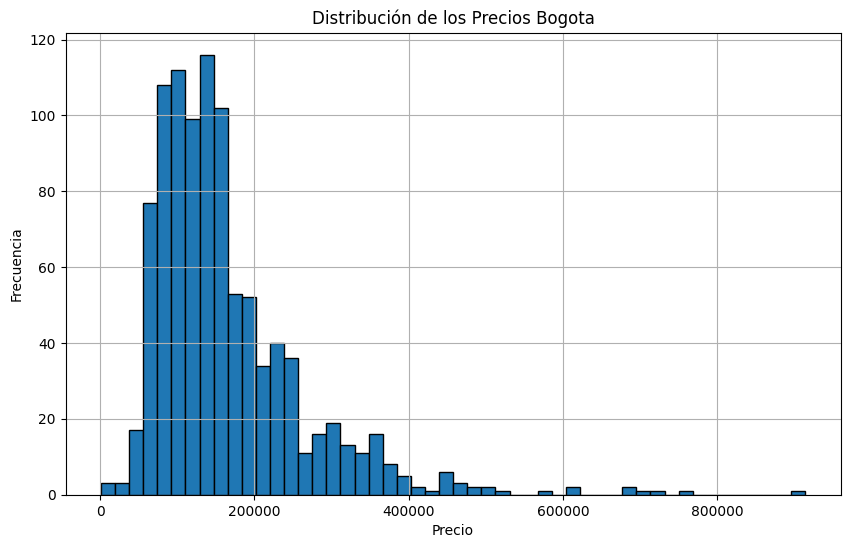

In [ ]:
# Graficar la distribución de los precios con un histograma
plt.figure(figsize=(10, 6))
plt.hist(data['Price'], bins=50, edgecolor='black')
plt.title('Distribución de los Precios Bogota')
plt.xlabel('Precio')
plt.ylabel('Frecuencia')
plt.grid(True)
plt.show()

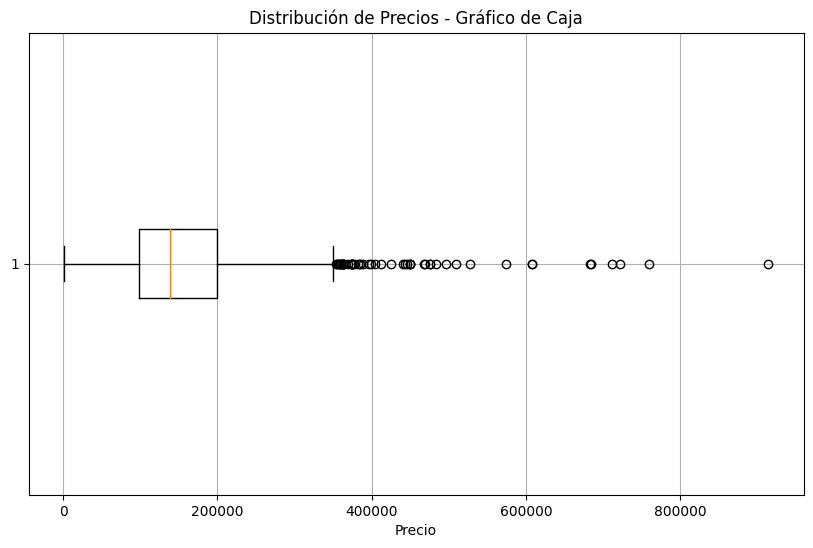

In [ ]:
# Crear un gráfico de caja para la columna 'Price'
plt.figure(figsize=(10, 6))
plt.boxplot(data['Price'].dropna(), vert=False)  # vert=False para un gráfico de caja horizontal
plt.title('Distribución de Precios - Gráfico de Caja')
plt.xlabel('Precio')
plt.grid(True)
plt.show()

In [ ]:
# Calculamos el primer y tercer cuartil
Q1 = data['Price'].quantile(0.25)
Q3 = data['Price'].quantile(0.75)
IQR = Q3 - Q1

# Definimos los límites para considerar un dato como atípico
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

# Filtramos los datos eliminando los atípicos
data_filtered = data[(data['Price'] >= lower_bound) & (data['Price'] <= upper_bound)]

# Calculamos la descripción estadística de la columna 'Price' sin atípicos
estadisticas_precio_filtradas = data_filtered['Price'].describe()

estadisticas_precio_filtradas


count       926.000000
mean     148285.872570
std       68609.683609
min        1047.000000
25%       97415.000000
50%      135000.000000
75%      185410.000000
max      350000.000000
Name: Price, dtype: float64

####4.1.2  Datos de hoteles Cartagena.

In [ ]:
data = pd.read_csv('/content/HotelesCartagena.csv',header=None)
data.head(10000)

,0,1,2,3,4,5,6,7
0,Hotel Image,Hotel Name,Hotel Location,Hotel Rating,Hotel Description,Additional Details,Available Dates,Price
1,https://cf2.bstatic.com/xdata/images/hotel/squ...,Luxurious Furnitured Apartment in Exclusive Ar...,"Marbella, Cartagena de Indias",NaN,Apartamento entero • 3 dormitorios • 2 salas d...,"Cancelación gratis, Sin pago por adelantado",Travel Sustainable Nivel 1,COP 198.460
2,https://cf2.bstatic.com/xdata/images/hotel/squ...,Charleston Santa Teresa Cartagena,"Centro, Cartagena de Indias","8,8\nFabuloso\n315 comentarios",Apartamento entero • 3 dormitorios • 2 salas d...,Cancelación gratis,Anuncio publicitario,COP 2.441.360
3,https://cf2.bstatic.com/xdata/images/hotel/squ...,"Beach, pool, playground - ideal vacation",Cartagena de Indias,NaN,Apartamento entero • 3 dormitorios • 2 salas d...,"Cancelación gratis, Sin pago por adelantado",Nuevo en Booking.com,COP 302.440
4,https://cf2.bstatic.com/xdata/images/hotel/squ...,Hotel Cartagena Airport,"Crespo, Cartagena de Indias","7,6\nBien\n1.524 comentarios",Apartamento entero • 3 dormitorios • 2 salas d...,"Cancelación gratis, Sin pago por adelantado",Travel Sustainable Nivel 2,COP 121.500
...,...,...,...,...,...,...,...,...
972,https://cf2.bstatic.com/xdata/images/hotel/squ...,CASA AQUARIUS HOUSE,Cartagena de Indias,"8,9\nFabuloso\n8 comentarios",Apartamento entero • 3 dormitorios • 2 baños •...,"Cancelación gratis, Sin pago por adelantado","vie, 17 nov - sáb, 18 nov",COP 227.500
973,https://cf2.bstatic.com/xdata/images/hotel/squ...,Apartamento amoblado en Manga Cartagena,"Manga, Cartagena de Indias",NaN,Apartamento entero • 3 dormitorios • 2 baños •...,"Cancelación gratis, Sin pago por adelantado","vie, 17 nov - sáb, 18 nov",COP 450.000
974,https://cf2.bstatic.com/xdata/images/hotel/squ...,Apartamento con ubicación estratégica,Cartagena de Indias,"8,6\nFabuloso\n9 comentarios",Apartamento entero • 3 dormitorios • 2 baños •...,NaN,"vie, 19 ene - sáb, 20 ene",COP 199.560
975,https://cf2.bstatic.com/xdata/images/hotel/squ...,"Edificio Cristoforo Colombo 404, Laguito","Laguito, Cartagena de Indias","9,1\nFantástico\n7 comentarios",Apartamento entero • 3 dormitorios • 2 baños •...,"Cancelación gratis, Sin pago por adelantado","vie, 24 nov - sáb, 25 nov",COP 300.000


In [ ]:
# La primera fila de datos contiene los nombres de las columnas, así que la estableceremos como tal.
data.columns = data.iloc[0]  # Establecer la primera fila como encabezado
data = data.drop(0)  # Eliminar la primera fila de datos que ahora es el encabezado

# Vamos a normalizar la columna de precios para convertirla en un valor numérico.
data['Price'] = data['Price'].str.extract(r'(\d+\.\d+|\d+)').replace('\.', '', regex=True).astype(float)

# Vamos a separar el rating de hotel y los comentarios, suponiendo que el rating es un número que puede tener decimales
data[['Hotel Rating', 'Rating Comments']] = data['Hotel Rating'].str.extract(r'(\d+\.\d+|\d+)?\s?(.*)')

# Convertimos la columna 'Hotel Rating' a un valor numérico
data['Hotel Rating'] = pd.to_numeric(data['Hotel Rating'], errors='coerce')

# Normalizamos la columna 'Available Dates' si es necesario y si contiene fechas en un formato reconocible por pandas
# data['Available Dates'] = pd.to_datetime(data['Available Dates'], errors='coerce')

# Ahora vamos a mostrar las primeras 10 filas para verificar que la normalización fue exitosa
data.head(1000)

,Hotel Image,Hotel Name,Hotel Location,Hotel Rating,Hotel Description,Additional Details,Available Dates,Price,Rating Comments
1,https://cf2.bstatic.com/xdata/images/hotel/squ...,Luxurious Furnitured Apartment in Exclusive Ar...,"Marbella, Cartagena de Indias",NaN,Apartamento entero • 3 dormitorios • 2 salas d...,"Cancelación gratis, Sin pago por adelantado",Travel Sustainable Nivel 1,198460.0,NaN
2,https://cf2.bstatic.com/xdata/images/hotel/squ...,Charleston Santa Teresa Cartagena,"Centro, Cartagena de Indias",8.0,Apartamento entero • 3 dormitorios • 2 salas d...,Cancelación gratis,Anuncio publicitario,2441.0,",8"
3,https://cf2.bstatic.com/xdata/images/hotel/squ...,"Beach, pool, playground - ideal vacation",Cartagena de Indias,NaN,Apartamento entero • 3 dormitorios • 2 salas d...,"Cancelación gratis, Sin pago por adelantado",Nuevo en Booking.com,302440.0,NaN
4,https://cf2.bstatic.com/xdata/images/hotel/squ...,Hotel Cartagena Airport,"Crespo, Cartagena de Indias",7.0,Apartamento entero • 3 dormitorios • 2 salas d...,"Cancelación gratis, Sin pago por adelantado",Travel Sustainable Nivel 2,121500.0,",6"
5,https://cf2.bstatic.com/xdata/images/hotel/squ...,Comodo y tranquilo,Cartagena de Indias,NaN,Apartamento entero • 3 dormitorios • 2 salas d...,"Cancelación gratis, Sin pago por adelantado",Nuevo en Booking.com,120000.0,NaN
...,...,...,...,...,...,...,...,...,...
972,https://cf2.bstatic.com/xdata/images/hotel/squ...,CASA AQUARIUS HOUSE,Cartagena de Indias,8.0,Apartamento entero • 3 dormitorios • 2 baños •...,"Cancelación gratis, Sin pago por adelantado","vie, 17 nov - sáb, 18 nov",227500.0,",9"
973,https://cf2.bstatic.com/xdata/images/hotel/squ...,Apartamento amoblado en Manga Cartagena,"Manga, Cartagena de Indias",NaN,Apartamento entero • 3 dormitorios • 2 baños •...,"Cancelación gratis, Sin pago por adelantado","vie, 17 nov - sáb, 18 nov",450000.0,NaN
974,https://cf2.bstatic.com/xdata/images/hotel/squ...,Apartamento con ubicación estratégica,Cartagena de Indias,8.0,Apartamento entero • 3 dormitorios • 2 baños •...,NaN,"vie, 19 ene - sáb, 20 ene",199560.0,",6"
975,https://cf2.bstatic.com/xdata/images/hotel/squ...,"Edificio Cristoforo Colombo 404, Laguito","Laguito, Cartagena de Indias",9.0,Apartamento entero • 3 dormitorios • 2 baños •...,"Cancelación gratis, Sin pago por adelantado","vie, 24 nov - sáb, 25 nov",300000.0,",1"


#####4.1.2.1 Medidas de centralidad y dispersion.

In [ ]:
# Calcular el precio promedio
precio_promedio = data['Price'].mean()

# Calcular estadísticas descriptivas adicionales para la columna 'Price'
estadisticas_precio = data['Price'].describe()

# Imprimir el precio promedio y las estadísticas
print(f"El precio promedio es: {precio_promedio}")
print(estadisticas_precio)

El precio promedio es: 296399.68954918033
count       976.000000
mean     296399.689549
std      215366.502247
min        1000.000000
25%      144500.000000
50%      238000.000000
75%      405000.000000
max      980000.000000
Name: Price, dtype: float64


#####4.1.2.2 Precios Hoteles.

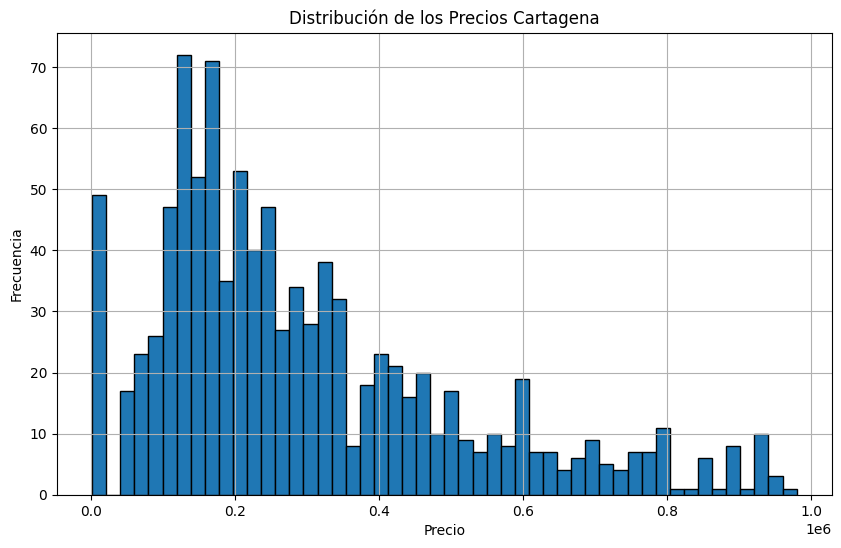

In [ ]:
# Graficar la distribución de los precios con un histograma
plt.figure(figsize=(10, 6))
plt.hist(data['Price'], bins=50, edgecolor='black')
plt.title('Distribución de los Precios Cartagena')
plt.xlabel('Precio')
plt.ylabel('Frecuencia')
plt.grid(True)
plt.show()

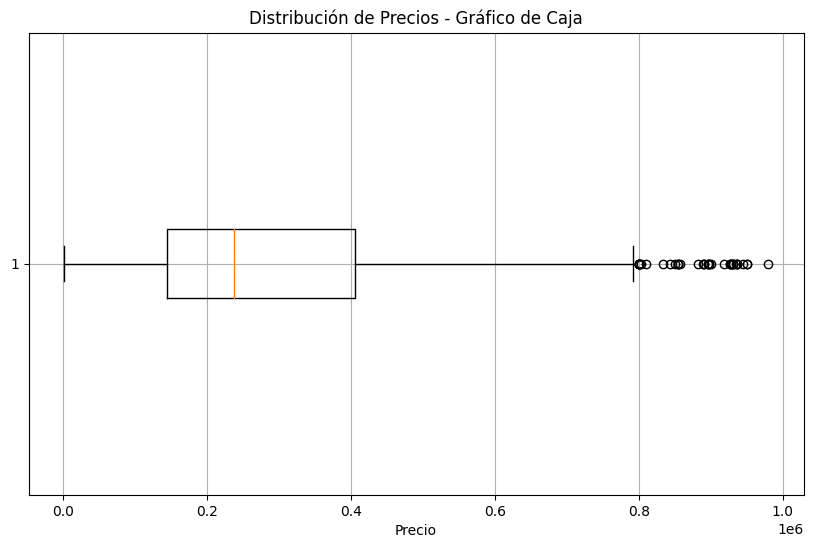

In [ ]:
# Crear un gráfico de caja para la columna 'Price'
plt.figure(figsize=(10, 6))
plt.boxplot(data['Price'].dropna(), vert=False)  # vert=False para un gráfico de caja horizontal
plt.title('Distribución de Precios - Gráfico de Caja')
plt.xlabel('Precio')
plt.grid(True)
plt.show()

In [ ]:
# Calculamos el primer y tercer cuartil
Q1 = data['Price'].quantile(0.25)
Q3 = data['Price'].quantile(0.75)
IQR = Q3 - Q1

# Definimos los límites para considerar un dato como atípico
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

# Filtramos los datos eliminando los atípicos
data_filtered = data[(data['Price'] >= lower_bound) & (data['Price'] <= upper_bound)]

# Calculamos la descripción estadística de la columna 'Price' sin atípicos
estadisticas_precio_filtradas = data_filtered['Price'].describe()

estadisticas_precio_filtradas

count       937.000000
mean     271967.723586
std      182330.638230
min        1000.000000
25%      138240.000000
50%      226800.000000
75%      378560.000000
max      791780.000000
Name: Price, dtype: float64

####4.1.3  Datos de hoteles en San andres

In [ ]:
import pandas as pd

data = pd.read_csv('/content/HotelesSanAndres.csv',header=None)
data.head(10000)

,0,1,2,3,4,5,6,7
0,Hotel Image,Hotel Name,Hotel Location,Hotel Rating,Hotel Description,Additional Details,Available Dates,Price
1,https://cf2.bstatic.com/xdata/images/hotel/squ...,Dreamer Beach Club,San Andrés,"8,6\nFabuloso\n1.788 comentarios",1 cama doble\nSolo queda 1 habitación a este p...,NaN,Travel Sustainable Nivel 3,COP 359.100
2,https://cf2.bstatic.com/xdata/images/hotel/squ...,Casa Hostel San Andres,San Andrés,"7,7\nBien\n473 comentarios",1 cama doble\nSolo queda 1 habitación a este p...,NaN,Travel Sustainable Nivel 2,COP 60.000
3,https://cf2.bstatic.com/xdata/images/hotel/squ...,The Nomadic Design Hostel,San Andrés,"9,1\nFantástico\n56 comentarios",1 cama doble\nSolo queda 1 habitación a este p...,Cancelación gratis,Travel Sustainable Nivel 2,COP 275.620
4,https://cf2.bstatic.com/xdata/images/hotel/squ...,In Di House of Reggae Boutique,San Andrés,"8,6\nFabuloso\n758 comentarios",1 cama doble\nSolo queda 1 habitación a este p...,NaN,Destacado,COP 393.760
...,...,...,...,...,...,...,...,...
321,https://cf2.bstatic.com/xdata/images/hotel/squ...,San Andres Ultd Inn RNT # 30017,San Andrés,10\nExcepcional\n2 comentarios,Apartamento entero • 1 dormitorio • 1 baño • 3...,Cancelación gratis,Travel Sustainable Nivel 2,COP 250.000
322,https://cf2.bstatic.com/xdata/images/hotel/squ...,Hospedaje Solymar Edificio Comodore apto 203,San Andrés,"8,3\nMuy bien\n31 comentarios",Apartamento entero • 1 dormitorio • 1 baño • 3...,NaN,"vie, 17 nov - sáb, 18 nov",COP 550.000
323,https://cf2.bstatic.com/xdata/images/hotel/squ...,Posada Amiel Forbes Apartament Casa 203,San Andrés,NaN,Apartamento entero • 1 dormitorio • 1 baño • 3...,"Cancelación gratis, Sin pago por adelantado",Nuevo en Booking.com,COP 471.760
324,https://cf2.bstatic.com/xdata/images/hotel/squ...,Apartamento Bay Point 303,San Andrés,"7,8\nBien\n5 comentarios",Apartamento entero • 1 dormitorio • 1 baño • 3...,NaN,"vie, 17 nov - sáb, 18 nov",COP 584.000


In [ ]:

# La primera fila de datos contiene los nombres de las columnas, así que la estableceremos como tal.
data.columns = data.iloc[0]  # Establecer la primera fila como encabezado
data = data.drop(0)  # Eliminar la primera fila de datos que ahora es el encabezado

# Vamos a normalizar la columna de precios para convertirla en un valor numérico.
data['Price'] = data['Price'].str.extract(r'(\d+\.\d+|\d+)').replace('\.', '', regex=True).astype(float)

# Vamos a separar el rating de hotel y los comentarios, suponiendo que el rating es un número que puede tener decimales
data[['Hotel Rating', 'Rating Comments']] = data['Hotel Rating'].str.extract(r'(\d+\.\d+|\d+)?\s?(.*)')

# Convertimos la columna 'Hotel Rating' a un valor numérico
data['Hotel Rating'] = pd.to_numeric(data['Hotel Rating'], errors='coerce')

# Normalizamos la columna 'Available Dates' si es necesario y si contiene fechas en un formato reconocible por pandas
# data['Available Dates'] = pd.to_datetime(data['Available Dates'], errors='coerce')

# Ahora vamos a mostrar las primeras 10 filas para verificar que la normalización fue exitosa
data.head(1000)

,Hotel Image,Hotel Name,Hotel Location,Hotel Rating,Hotel Description,Additional Details,Available Dates,Price,Rating Comments
1,https://cf2.bstatic.com/xdata/images/hotel/squ...,Dreamer Beach Club,San Andrés,8.0,1 cama doble\nSolo queda 1 habitación a este p...,NaN,Travel Sustainable Nivel 3,359100.0,",6"
2,https://cf2.bstatic.com/xdata/images/hotel/squ...,Casa Hostel San Andres,San Andrés,7.0,1 cama doble\nSolo queda 1 habitación a este p...,NaN,Travel Sustainable Nivel 2,60000.0,",7"
3,https://cf2.bstatic.com/xdata/images/hotel/squ...,The Nomadic Design Hostel,San Andrés,9.0,1 cama doble\nSolo queda 1 habitación a este p...,Cancelación gratis,Travel Sustainable Nivel 2,275620.0,",1"
4,https://cf2.bstatic.com/xdata/images/hotel/squ...,In Di House of Reggae Boutique,San Andrés,8.0,1 cama doble\nSolo queda 1 habitación a este p...,NaN,Destacado,393760.0,",6"
5,https://cf2.bstatic.com/xdata/images/hotel/squ...,The Rock House Eco,San Andrés,9.0,1 cama doble\nSolo queda 1 habitación a este p...,NaN,Travel Sustainable Nivel 2,154440.0,",1"
...,...,...,...,...,...,...,...,...,...
321,https://cf2.bstatic.com/xdata/images/hotel/squ...,San Andres Ultd Inn RNT # 30017,San Andrés,10.0,Apartamento entero • 1 dormitorio • 1 baño • 3...,Cancelación gratis,Travel Sustainable Nivel 2,250000.0,Excepcional
322,https://cf2.bstatic.com/xdata/images/hotel/squ...,Hospedaje Solymar Edificio Comodore apto 203,San Andrés,8.0,Apartamento entero • 1 dormitorio • 1 baño • 3...,NaN,"vie, 17 nov - sáb, 18 nov",550000.0,",3"
323,https://cf2.bstatic.com/xdata/images/hotel/squ...,Posada Amiel Forbes Apartament Casa 203,San Andrés,NaN,Apartamento entero • 1 dormitorio • 1 baño • 3...,"Cancelación gratis, Sin pago por adelantado",Nuevo en Booking.com,471760.0,NaN
324,https://cf2.bstatic.com/xdata/images/hotel/squ...,Apartamento Bay Point 303,San Andrés,7.0,Apartamento entero • 1 dormitorio • 1 baño • 3...,NaN,"vie, 17 nov - sáb, 18 nov",584000.0,",8"


#####4.1.3.1 Medidas de centralidad y dispersion

In [ ]:
# Calcular el precio promedio
precio_promedio = data['Price'].mean()

# Calcular estadísticas descriptivas adicionales para la columna 'Price'
estadisticas_precio = data['Price'].describe()

# Imprimir el precio promedio y las estadísticas
print(f"El precio promedio es: {precio_promedio}")
print(estadisticas_precio)

El precio promedio es: 300778.35076923075
count       325.000000
mean     300778.350769
std      200070.471222
min        1011.000000
25%      155000.000000
50%      232560.000000
75%      400000.000000
max      960000.000000
Name: Price, dtype: float64


#####4.1.3.2 Distribucion precios

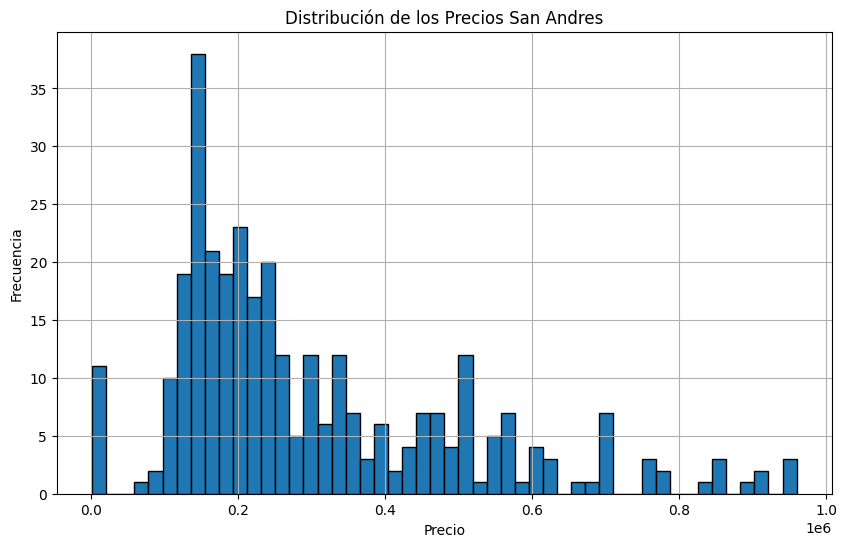

In [ ]:
# Graficar la distribución de los precios con un histograma
plt.figure(figsize=(10, 6))
plt.hist(data['Price'], bins=50, edgecolor='black')
plt.title('Distribución de los Precios San Andres')
plt.xlabel('Precio')
plt.ylabel('Frecuencia')
plt.grid(True)
plt.show()

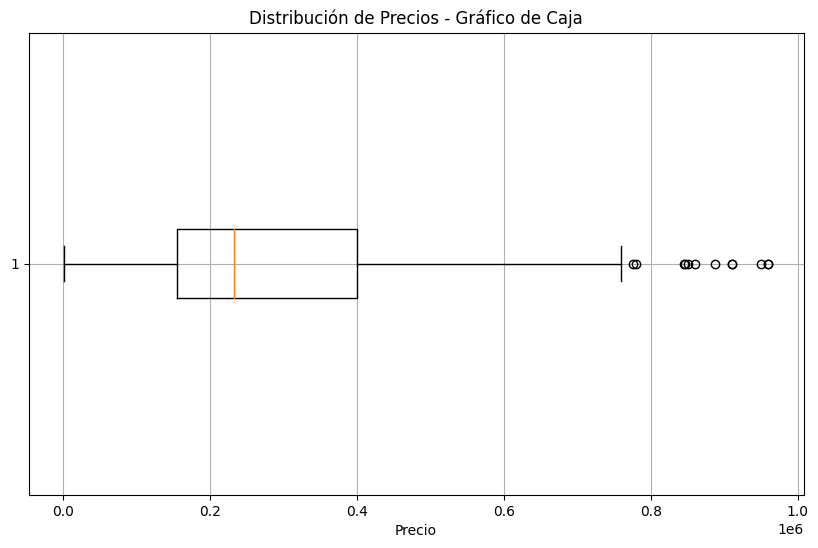

In [ ]:
# Crear un gráfico de caja para la columna 'Price'
plt.figure(figsize=(10, 6))
plt.boxplot(data['Price'].dropna(), vert=False)  # vert=False para un gráfico de caja horizontal
plt.title('Distribución de Precios - Gráfico de Caja')
plt.xlabel('Precio')
plt.grid(True)
plt.show()

In [ ]:
# Calculamos el primer y tercer cuartil
Q1 = data['Price'].quantile(0.25)
Q3 = data['Price'].quantile(0.75)
IQR = Q3 - Q1

# Definimos los límites para considerar un dato como atípico
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

# Filtramos los datos eliminando los atípicos
data_filtered = data[(data['Price'] >= lower_bound) & (data['Price'] <= upper_bound)]

# Calculamos la descripción estadística de la columna 'Price' sin atípicos
estadisticas_precio_filtradas = data_filtered['Price'].describe()

estadisticas_precio_filtradas

count       313.000000
mean     278648.894569
std      167694.434351
min        1011.000000
25%      153000.000000
50%      225000.000000
75%      364800.000000
max      760000.000000
Name: Price, dtype: float64

####4.1.4  Datos para hoteles Medellin

In [ ]:
import pandas as pd

data = pd.read_csv('/content/HotelesMedellin.csv',header=None)
data.head(10000)

,0,1,2,3,4,5,6,7
0,Hotel Image,Hotel Name,Hotel Location,Hotel Rating,Hotel Description,Additional Details,Available Dates,Price
1,https://cf2.bstatic.com/xdata/images/hotel/squ...,ibis Medellin,"El Poblado, Medellín","8,3\nMuy bien\n3.264 comentarios",1 cama doble grande\nCancelación gratis\nSin p...,"Cancelación gratis, Sin pago por adelantado",Travel Sustainable Nivel 2,COP 259.000
2,https://cf2.bstatic.com/xdata/images/hotel/squ...,Hotel Lexum Estadio,NaN,NaN,1 cama doble grande\nCancelación gratis\nSin p...,NaN,NaN,NaN
3,https://cf2.bstatic.com/xdata/images/hotel/squ...,NaN,NaN,NaN,1 cama doble grande\nCancelación gratis\nSin p...,NaN,NaN,NaN
4,https://cf2.bstatic.com/xdata/images/hotel/squ...,NaN,NaN,NaN,1 cama doble grande\nCancelación gratis\nSin p...,",",NaN,NaN
...,...,...,...,...,...,...,...,...
971,https://cf2.bstatic.com/xdata/images/hotel/squ...,201 APARTAMENTO ESTADIO y METRO EXCELENTE UBIC...,"Laureles - Estadio, Medellín","8,7\nFabuloso\n6 comentarios",Casa o chalet entero • 1 dormitorio • 1 baño •...,"Cancelación gratis, Sin pago por adelantado","vie, 8 dic - sáb, 9 dic",COP 180.000
972,https://cf2.bstatic.com/xdata/images/hotel/squ...,Casa cómoda en ubicación ideal,Medellín,"9,3\nFantástico\n3 comentarios",Casa o chalet entero • 1 dormitorio • 1 baño •...,"Cancelación gratis, Sin pago por adelantado","vie, 17 nov - sáb, 18 nov",COP 221.380
973,https://cf2.bstatic.com/xdata/images/hotel/squ...,OFIUITES ALFA 1,Medellín,10\nExcepcional\n3 comentarios,Casa o chalet entero • 1 dormitorio • 1 baño •...,"Cancelación gratis, Sin pago por adelantado","vie, 24 nov - sáb, 25 nov",COP 184.000
974,https://cf2.bstatic.com/xdata/images/hotel/squ...,"Habitación Privada en Apartamento, Conquistadores","Laureles - Estadio, Medellín",10\nExcepcional\n3 comentarios,Casa o chalet entero • 1 dormitorio • 1 baño •...,"Cancelación gratis, Sin pago por adelantado",Nuevo en Booking.com,COP 108.000


In [ ]:

# La primera fila de datos contiene los nombres de las columnas, así que la estableceremos como tal.
data.columns = data.iloc[0]  # Establecer la primera fila como encabezado
data = data.drop(0)  # Eliminar la primera fila de datos que ahora es el encabezado

# Vamos a normalizar la columna de precios para convertirla en un valor numérico.
data['Price'] = data['Price'].str.extract(r'(\d+\.\d+|\d+)').replace('\.', '', regex=True).astype(float)

# Vamos a separar el rating de hotel y los comentarios, suponiendo que el rating es un número que puede tener decimales
data[['Hotel Rating', 'Rating Comments']] = data['Hotel Rating'].str.extract(r'(\d+\.\d+|\d+)?\s?(.*)')

# Convertimos la columna 'Hotel Rating' a un valor numérico
data['Hotel Rating'] = pd.to_numeric(data['Hotel Rating'], errors='coerce')

# Normalizamos la columna 'Available Dates' si es necesario y si contiene fechas en un formato reconocible por pandas
# data['Available Dates'] = pd.to_datetime(data['Available Dates'], errors='coerce')

# Ahora vamos a mostrar las primeras 10 filas para verificar que la normalización fue exitosa
data.head(1000)

,Hotel Image,Hotel Name,Hotel Location,Hotel Rating,Hotel Description,Additional Details,Available Dates,Price,Rating Comments
1,https://cf2.bstatic.com/xdata/images/hotel/squ...,ibis Medellin,"El Poblado, Medellín",8.0,1 cama doble grande\nCancelación gratis\nSin p...,"Cancelación gratis, Sin pago por adelantado",Travel Sustainable Nivel 2,259000.0,",3"
2,https://cf2.bstatic.com/xdata/images/hotel/squ...,Hotel Lexum Estadio,NaN,NaN,1 cama doble grande\nCancelación gratis\nSin p...,NaN,NaN,NaN,NaN
3,https://cf2.bstatic.com/xdata/images/hotel/squ...,NaN,NaN,NaN,1 cama doble grande\nCancelación gratis\nSin p...,NaN,NaN,NaN,NaN
4,https://cf2.bstatic.com/xdata/images/hotel/squ...,NaN,NaN,NaN,1 cama doble grande\nCancelación gratis\nSin p...,",",NaN,NaN,NaN
5,https://cf2.bstatic.com/xdata/images/hotel/squ...,NaN,NaN,NaN,1 cama doble grande\nCancelación gratis\nSin p...,",",NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...
971,https://cf2.bstatic.com/xdata/images/hotel/squ...,201 APARTAMENTO ESTADIO y METRO EXCELENTE UBIC...,"Laureles - Estadio, Medellín",8.0,Casa o chalet entero • 1 dormitorio • 1 baño •...,"Cancelación gratis, Sin pago por adelantado","vie, 8 dic - sáb, 9 dic",180000.0,",7"
972,https://cf2.bstatic.com/xdata/images/hotel/squ...,Casa cómoda en ubicación ideal,Medellín,9.0,Casa o chalet entero • 1 dormitorio • 1 baño •...,"Cancelación gratis, Sin pago por adelantado","vie, 17 nov - sáb, 18 nov",221380.0,",3"
973,https://cf2.bstatic.com/xdata/images/hotel/squ...,OFIUITES ALFA 1,Medellín,10.0,Casa o chalet entero • 1 dormitorio • 1 baño •...,"Cancelación gratis, Sin pago por adelantado","vie, 24 nov - sáb, 25 nov",184000.0,Excepcional
974,https://cf2.bstatic.com/xdata/images/hotel/squ...,"Habitación Privada en Apartamento, Conquistadores","Laureles - Estadio, Medellín",10.0,Casa o chalet entero • 1 dormitorio • 1 baño •...,"Cancelación gratis, Sin pago por adelantado",Nuevo en Booking.com,108000.0,Excepcional


#####4.1.4.1 Medidas de centralidad y dispersion

In [ ]:
# Calcular el precio promedio
precio_promedio = data['Price'].mean()

# Calcular estadísticas descriptivas adicionales para la columna 'Price'
estadisticas_precio = data['Price'].describe()

# Imprimir el precio promedio y las estadísticas
print(f"El precio promedio es: {precio_promedio}")
print(estadisticas_precio)

El precio promedio es: 202949.02103049422
count       951.000000
mean     202949.021030
std      131335.898942
min        1000.000000
25%      110160.000000
50%      168000.000000
75%      250000.000000
max      852600.000000
Name: Price, dtype: float64


#####4.1.4.2 Distribucion precios

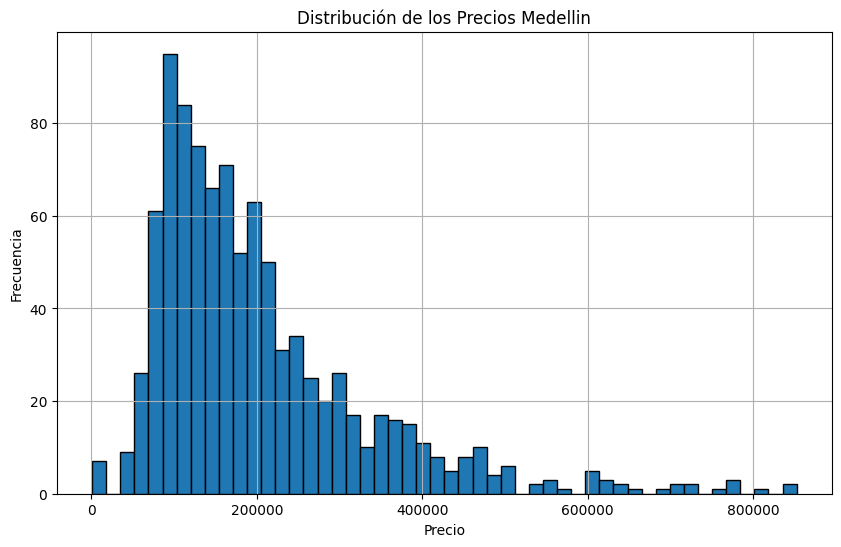

In [ ]:
# Graficar la distribución de los precios con un histograma
plt.figure(figsize=(10, 6))
plt.hist(data['Price'], bins=50, edgecolor='black')
plt.title('Distribución de los Precios Medellin')
plt.xlabel('Precio')
plt.ylabel('Frecuencia')
plt.grid(True)
plt.show()

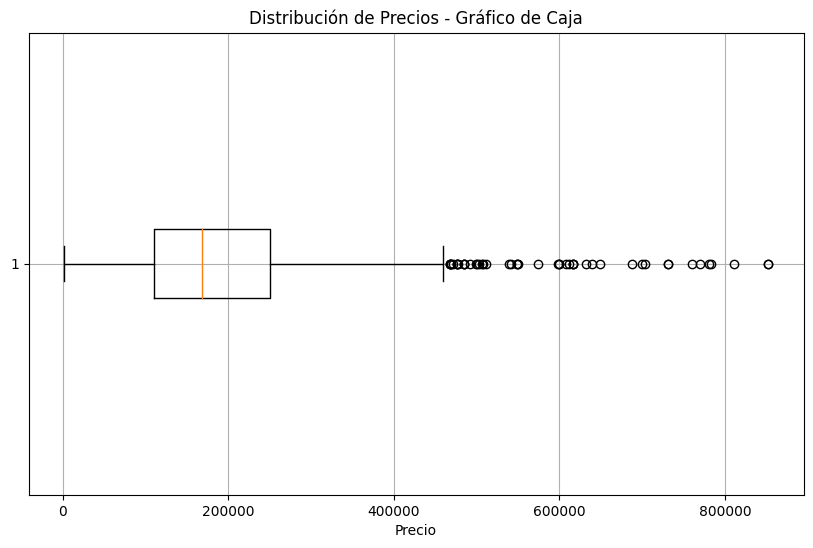

In [ ]:
# Crear un gráfico de caja para la columna 'Price'
plt.figure(figsize=(10, 6))
plt.boxplot(data['Price'].dropna(), vert=False)  # vert=False para un gráfico de caja horizontal
plt.title('Distribución de Precios - Gráfico de Caja')
plt.xlabel('Precio')
plt.grid(True)
plt.show()

In [ ]:
# Para eliminar los datos atípicos (outliers) y calcular la descripción estadística, primero definiremos qué se considera un dato atípico.
# Una forma común de definir un dato atípico es todo aquello que esté fuera del rango [Q1 - 1.5*IQR, Q3 + 1.5*IQR],
# donde Q1 es el primer cuartil, Q3 es el tercer cuartil e IQR es el rango intercuartílico (Q3 - Q1).

# Calculamos el primer y tercer cuartil
Q1 = data['Price'].quantile(0.25)
Q3 = data['Price'].quantile(0.75)
IQR = Q3 - Q1

# Definimos los límites para considerar un dato como atípico
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

# Filtramos los datos eliminando los atípicos
data_filtered = data[(data['Price'] >= lower_bound) & (data['Price'] <= upper_bound)]

# Calculamos la descripción estadística de la columna 'Price' sin atípicos
estadisticas_precio_filtradas = data_filtered['Price'].describe()

estadisticas_precio_filtradas


count       902.000000
mean     181885.586475
std       94083.840114
min        1000.000000
25%      110000.000000
50%      160520.000000
75%      229700.000000
max      459000.000000
Name: Price, dtype: float64

####4.1.5  Datos para hoteles Santa Marta

In [ ]:
import pandas as pd

data = pd.read_csv('/content/HotelesSantaMarta.csv',header=None)
data.head(10000)

,0,1,2,3,4,5,6,7
0,Hotel Image,Hotel Name,Hotel Location,Hotel Rating,Hotel Description,Additional Details,Available Dates,Price
1,https://cf.bstatic.com/xdata/images/hotel/squa...,Villa Eva cerca al parque Tayrona,Santa Marta,NaN,Villa entera • 3 dormitorios • 1 sala de estar...,"Cancelación gratis, Sin pago por adelantado","vie, 17 nov - sáb, 18 nov",COP 1.400.000
2,https://cf.bstatic.com/xdata/images/hotel/squa...,Hilton Santa Marta,"Bello Horizonte, Santa Marta","8,7\nFabuloso\n443 comentarios",Villa entera • 3 dormitorios • 1 sala de estar...,NaN,Anuncio publicitario,COP 652.160
3,https://cf.bstatic.com/xdata/images/hotel/squa...,Papiros,Santa Marta,NaN,Villa entera • 3 dormitorios • 1 sala de estar...,"Cancelación gratis, Sin pago por adelantado",Nuevo en Booking.com,COP 150.000
4,https://cf.bstatic.com/xdata/images/hotel/squa...,Hotel Parque de los Novios Inn,"Centro histórico, Santa Marta","8,0\nMuy bien\n880 comentarios",Villa entera • 3 dormitorios • 1 sala de estar...,"Cancelación gratis, Sin pago por adelantado",Oferta de finales de año,COP 160.000
...,...,...,...,...,...,...,...,...
847,https://cf.bstatic.com/xdata/images/hotel/squa...,Cabaña The Sunset,Santa Marta,"7,8\nBien\n55 comentarios",Apartamento entero • 2 dormitorios • 1 baño\n2...,NaN,"vie, 17 nov - sáb, 18 nov",COP 160.000
848,https://cf.bstatic.com/xdata/images/hotel/squa...,Yoal Hostel,Santa Marta,NaN,Apartamento entero • 2 dormitorios • 1 baño\n2...,NaN,Travel Sustainable Nivel 1,COP 140.000
849,https://cf.bstatic.com/xdata/images/hotel/squa...,"Casa, playa Bello Horizonte Santa Marta Colombia","Bello Horizonte, Santa Marta","8,3\nMuy bien\n10 comentarios",Apartamento entero • 2 dormitorios • 1 baño\n2...,"Cancelación gratis, Sin pago por adelantado","vie, 19 ene - sáb, 20 ene",COP 565.260
850,https://cf.bstatic.com/xdata/images/hotel/squa...,Samaria 203B - Bello horizonte,"Bello Horizonte, Santa Marta","9,0\nFantástico\n2 comentarios",Apartamento entero • 2 dormitorios • 1 baño\n2...,NaN,Travel Sustainable Nivel 1,COP 281.600


In [ ]:

# La primera fila de datos contiene los nombres de las columnas, así que la estableceremos como tal.
data.columns = data.iloc[0]  # Establecer la primera fila como encabezado
data = data.drop(0)  # Eliminar la primera fila de datos que ahora es el encabezado

# Vamos a normalizar la columna de precios para convertirla en un valor numérico.
data['Price'] = data['Price'].str.extract(r'(\d+\.\d+|\d+)').replace('\.', '', regex=True).astype(float)

# Vamos a separar el rating de hotel y los comentarios, suponiendo que el rating es un número que puede tener decimales
data[['Hotel Rating', 'Rating Comments']] = data['Hotel Rating'].str.extract(r'(\d+\.\d+|\d+)?\s?(.*)')

# Convertimos la columna 'Hotel Rating' a un valor numérico
data['Hotel Rating'] = pd.to_numeric(data['Hotel Rating'], errors='coerce')

# Normalizamos la columna 'Available Dates' si es necesario y si contiene fechas en un formato reconocible por pandas
# data['Available Dates'] = pd.to_datetime(data['Available Dates'], errors='coerce')

# Ahora vamos a mostrar las primeras 10 filas para verificar que la normalización fue exitosa
data.head(1000)

,Hotel Image,Hotel Name,Hotel Location,Hotel Rating,Hotel Description,Additional Details,Available Dates,Price,Rating Comments
1,https://cf.bstatic.com/xdata/images/hotel/squa...,Villa Eva cerca al parque Tayrona,Santa Marta,NaN,Villa entera • 3 dormitorios • 1 sala de estar...,"Cancelación gratis, Sin pago por adelantado","vie, 17 nov - sáb, 18 nov",1400.0,NaN
2,https://cf.bstatic.com/xdata/images/hotel/squa...,Hilton Santa Marta,"Bello Horizonte, Santa Marta",8.0,Villa entera • 3 dormitorios • 1 sala de estar...,NaN,Anuncio publicitario,652160.0,",7"
3,https://cf.bstatic.com/xdata/images/hotel/squa...,Papiros,Santa Marta,NaN,Villa entera • 3 dormitorios • 1 sala de estar...,"Cancelación gratis, Sin pago por adelantado",Nuevo en Booking.com,150000.0,NaN
4,https://cf.bstatic.com/xdata/images/hotel/squa...,Hotel Parque de los Novios Inn,"Centro histórico, Santa Marta",8.0,Villa entera • 3 dormitorios • 1 sala de estar...,"Cancelación gratis, Sin pago por adelantado",Oferta de finales de año,160000.0,",0"
5,https://cf.bstatic.com/xdata/images/hotel/squa...,Hotel Santorini Resort,"Bello Horizonte, Santa Marta",8.0,Villa entera • 3 dormitorios • 1 sala de estar...,"Cancelación gratis, Sin pago por adelantado",Travel Sustainable Nivel 1,294000.0,",0"
...,...,...,...,...,...,...,...,...,...
847,https://cf.bstatic.com/xdata/images/hotel/squa...,Cabaña The Sunset,Santa Marta,7.0,Apartamento entero • 2 dormitorios • 1 baño\n2...,NaN,"vie, 17 nov - sáb, 18 nov",160000.0,",8"
848,https://cf.bstatic.com/xdata/images/hotel/squa...,Yoal Hostel,Santa Marta,NaN,Apartamento entero • 2 dormitorios • 1 baño\n2...,NaN,Travel Sustainable Nivel 1,140000.0,NaN
849,https://cf.bstatic.com/xdata/images/hotel/squa...,"Casa, playa Bello Horizonte Santa Marta Colombia","Bello Horizonte, Santa Marta",8.0,Apartamento entero • 2 dormitorios • 1 baño\n2...,"Cancelación gratis, Sin pago por adelantado","vie, 19 ene - sáb, 20 ene",565260.0,",3"
850,https://cf.bstatic.com/xdata/images/hotel/squa...,Samaria 203B - Bello horizonte,"Bello Horizonte, Santa Marta",9.0,Apartamento entero • 2 dormitorios • 1 baño\n2...,NaN,Travel Sustainable Nivel 1,281600.0,",0"


#####4.1.5.1 Medidas de centralidad y dispersion

In [ ]:
# Calcular el precio promedio
precio_promedio = data['Price'].mean()

# Calcular estadísticas descriptivas adicionales para la columna 'Price'
estadisticas_precio = data['Price'].describe()

# Imprimir el precio promedio y las estadísticas
print(f"El precio promedio es: {precio_promedio}")
print(estadisticas_precio)

El precio promedio es: 235991.12808460635
count       851.000000
mean     235991.128085
std      182587.575954
min        1000.000000
25%      116020.000000
50%      180000.000000
75%      289320.000000
max      960000.000000
Name: Price, dtype: float64


#####4.1.5.2 Distribucion precios

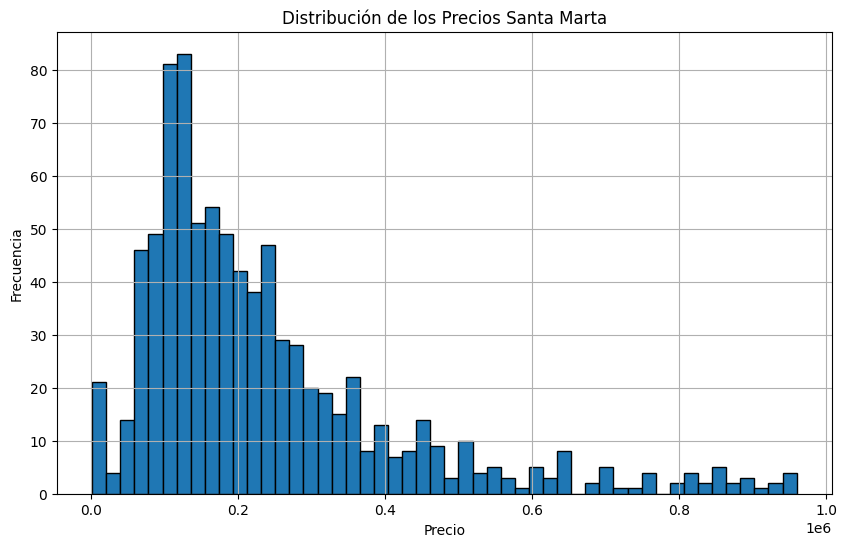

In [ ]:
# Graficar la distribución de los precios con un histograma
plt.figure(figsize=(10, 6))
plt.hist(data['Price'], bins=50, edgecolor='black')
plt.title('Distribución de los Precios Santa Marta')
plt.xlabel('Precio')
plt.ylabel('Frecuencia')
plt.grid(True)
plt.show()

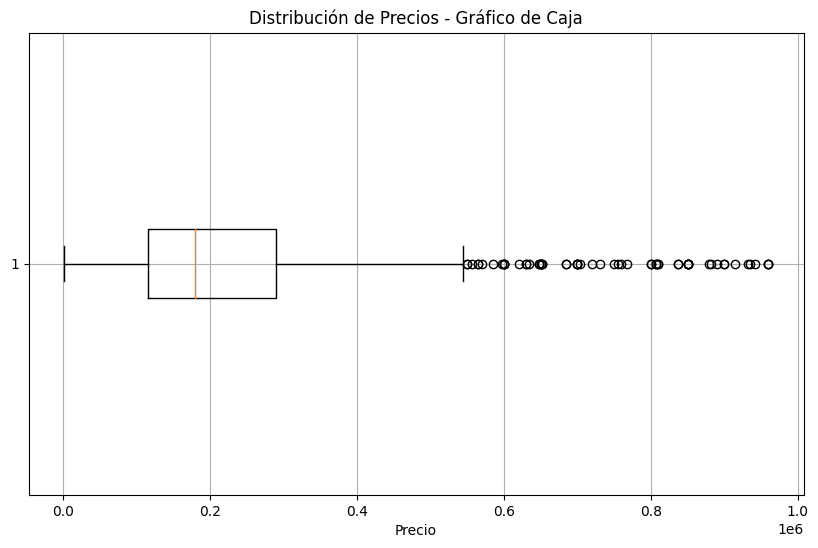

In [ ]:
# Crear un gráfico de caja para la columna 'Price'
plt.figure(figsize=(10, 6))
plt.boxplot(data['Price'].dropna(), vert=False)  # vert=False para un gráfico de caja horizontal
plt.title('Distribución de Precios - Gráfico de Caja')
plt.xlabel('Precio')
plt.grid(True)
plt.show()

In [ ]:
# Una forma común de definir un dato atípico es todo aquello que esté fuera del rango [Q1 - 1.5*IQR, Q3 + 1.5*IQR],
# donde Q1 es el primer cuartil, Q3 es el tercer cuartil e IQR es el rango intercuartílico (Q3 - Q1).

# Calculamos el primer y tercer cuartil
Q1 = data['Price'].quantile(0.25)
Q3 = data['Price'].quantile(0.75)
IQR = Q3 - Q1

# Definimos los límites para considerar un dato como atípico
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

# Filtramos los datos eliminando los atípicos
data_filtered = data[(data['Price'] >= lower_bound) & (data['Price'] <= upper_bound)]

# Calculamos la descripción estadística de la columna 'Price' sin atípicos
estadisticas_precio_filtradas = data_filtered['Price'].describe()

estadisticas_precio_filtradas


count       790.000000
mean     197028.696203
std      116210.234233
min        1000.000000
25%      112125.000000
50%      170000.000000
75%      255000.000000
max      544000.000000
Name: Price, dtype: float64

###4.2 Scraping Hoteles.com

In [ ]:
from selenium import webdriver
from selenium.webdriver.common.by import By
from selenium.webdriver.support.ui import WebDriverWait
from selenium.webdriver.support import expected_conditions as EC
from selenium.webdriver.common.keys import Keys
import time
import pandas as pd

URL = "https://co.hoteles.com/Hotel-Search?adults=2&chid=086f6ff7-7150-43ac-952e-69a125b8937f&children=&currency=COP&destination=Bogot%C3%A1%2C%20Distrito%20Capital%2C%20Colombia&eapid=3&endDate=2024-01-29&flexibility=7_DAY&langid=2058&latLong=4.710989%2C-74.07209&mapBounds=&mctc=5&mdpcid=HCOM-CO.META.TRIVAGO.CORESEARCH.HOTEL&mdpdtl=HTL.1813662.Bogot%C3%A1.los%3D1.losb%3D1.ttt%3D6.tttb%3D5.trv_bm%3D-1.pg%3D1.defdate%3D1.guests%3D2.guestsb%3D2.cpa%3D0.spa%3D0.device%3D-1.a2a%3D00.MOD%3D0&mpa=168100.00&mpd=COP&mpe=1698800846&mpm=24&pwaDialog=&rateplanid=385320050&regionId=653&rffrid=mdp.hcom.CO.011.387.02.42.kwrd%3D31ed8815-d36e-3dfd-9c94-281a67d9b351.wapa%3D272737.defdate%3D1.los%3D1.losb%3D1.ttt%3D6.tttb%3D5.bm%3D-1.pg%3D1.guests%3D2.guestsb%3D2.cpa%3D0.device%3D-1.a2a%3D00&semdtl=&sort=RECOMMENDED&startDate=2024-01-01&theme=&tpid=3127&trv_amenity=0&trv_curr=COP&trv_dp=168100&trv_price=0&trv_rating=0&trv_reference=31ed8815-d36e-3dfd-9c94-281a67d9b351&trv_star=0&useRewards=false&userIntent=&wapa4=1813662"  # Modifica esto con la URL correcta

driver = webdriver.Chrome()
driver.get(URL)

wait = WebDriverWait(driver, 30)  # Espera hasta 30 segundos
# Hacer clic en "Ver más" hasta que no esté presente o un número determinado de veces
clicks_limit = 10  # Número máximo de veces que se hará clic en "Ver más"
clicks_count = 0

# Lista para almacenar la información de los hoteles
hotels_data = []

# Presionar el botón "Ver más" varias veces para cargar más resultados
for _ in range(100):  #  rango hoteles
    try:
        show_more_button = driver.find_element(By.CSS_SELECTOR, 'button[data-stid="show-more-results"]')
        show_more_button.click()
        time.sleep(3)  # Esperar a que carguen los nuevos resultados
    except:
        break

# Obtener todos los contenedores de hoteles
hotel_containers = driver.find_elements(By.CSS_SELECTOR, "div.uitk-card-content-section")

for container in hotel_containers:
    hotel_info = {}

    try:
        hotel_info['Nombre'] = container.find_element(By.CSS_SELECTOR, "h3.uitk-heading.uitk-heading-5").text
    except:
        hotel_info['Nombre'] = None
    try:
        hotel_info['Ubicación'] = container.find_element(By.CSS_SELECTOR, "div.uitk-text.uitk-text-spacing-half").text
    except:
        hotel_info['Ubicación'] = None
    try:
        hotel_info['Precio original'] = container.find_element(By.CSS_SELECTOR, "del div.uitk-text.uitk-type-300").text
    except:
        hotel_info['Precio original'] = None
    try:
        hotel_info['Precio con descuento'] = container.find_element(By.CSS_SELECTOR, "div.uitk-text.uitk-type-500").text
    except:
        hotel_info['Precio con descuento'] = None
    try:
        hotel_info['Fechas de estancia'] = container.find_element(By.CSS_SELECTOR, "div.uitk-text.uitk-type-end.uitk-type-300").text
    except:
        hotel_info['Fechas de estancia'] = None

    try:
        hotel_info['Acumula sellos'] = container.find_element(By.CSS_SELECTOR, "span.uitk-text.uitk-type-300").text
    except:
        hotel_info['Acumula sellos'] = None

    try:
        hotel_info['Calificación'] = container.find_element(By.CSS_SELECTOR, "span.uitk-badge-base-text").text
    except:
        hotel_info['Calificación'] = None

    try:
        hotel_info['Tipo de calificación'] = container.find_element(By.CSS_SELECTOR, "div.uitk-text.uitk-type-200.uitk-type-medium").text
    except:
        hotel_info['Tipo de calificación'] = None

    try:
        hotel_info['Opiniones totales'] = container.find_element(By.CSS_SELECTOR, "div.uitk-text.uitk-type-200.uitk-type-regular").text
    except:
        hotel_info['Opiniones totales'] = None

    try:
        hotel_info['Facilidades'] = container.find_element(By.CSS_SELECTOR, "div.uitk-text.truncate-lines-2.uitk-type-200").text
    except:
        hotel_info['Facilidades'] = None

    hotels_data.append(hotel_info)

# Cerrar el navegador
driver.quit()

# Convertir la lista de diccionarios a un DataFrame de pandas
df = pd.DataFrame(hotels_data)

# Exportar a CSV
df.to_csv('hoteles_info.csv', index=False)

print("Información exportada a hoteles_info.csv")

df.head(10)

In [ ]:
data = pd.read_csv('/content/hoteles_info.csv',header=None)
data.head(10)

In [ ]:

# Definir los nombres de las columnas
column_names = ['Nombre', 'Ubicación', 'Precio original', 'Precio con descuento', 'Fechas de estancia',
                'Acumula sellos', 'Calificación', 'Tipo de calificación', 'Opiniones totales', 'Facilidades']
data.columns = column_names

# Eliminar filas con todos los valores NaN
data.dropna(how='all', inplace=True)

# Normalizar columnas de precios
data['Precio original'] = data['Precio original'].str.extract(r'(\d+\.\d+|\d+)')[0].str.replace('.', '', regex=True).astype(float)
data['Precio con descuento'] = data['Precio con descuento'].str.extract(r'(\d+\.\d+|\d+)')[0].str.replace('.', '', regex=True).astype(float)

# Normalizar fechas de estancia (puede requerir ajustes según el formato exacto de las fechas)
data['Fechas de estancia'] = data['Fechas de estancia'].str.extract(r'Del (.+?)\\n')

# Normalizar calificaciones
data['Calificación'] = data['Calificación'].str.extract(r'(\d+\.\d+|\d+)').astype(float)

# Separar 'Tipo de calificación' y 'Opiniones totales'
data['Tipo de calificación'] = data['Tipo de calificación'].str.extract(r'([A-Za-z]+)$')
data['Opiniones totales'] = data['Opiniones totales'].str.extract(r'(\d+)').astype(float)

# Verificar la normalización
print(data.head(10))

###4.3 Datos turismo internacional (Por desarrollar)

##5. Analisis de datos

###5.1 Medidas de centralidad y dispersion contabilidad

In [ ]:
# Convertimos los datos a un DataFrame
contabilidad = pd.DataFrame(contabilidad_data)

# Calculamos las medidas de centralidad y dispersión para la columna 'Monto'
media = contabilidad['Monto'].mean()
mediana = contabilidad['Monto'].median()
moda = contabilidad['Monto'].mode()[0]  # Moda puede retornar múltiples valores, tomamos el primero para simplificar
rango = contabilidad['Monto'].max() - contabilidad['Monto'].min()
varianza = contabilidad['Monto'].var()
desviacion_estandar = contabilidad['Monto'].std()

# Creamos un diccionario para almacenar los resultados
medidas = {
    "Media": media,
    "Mediana": mediana,
    "Moda": moda,
    "Rango": rango,
    "Varianza": varianza,
    "Desviación Estándar": desviacion_estandar
}

medidas

{'Media': 256761.65202506605,
 'Mediana': 53706.0,
 'Moda': 25000,
 'Rango': 7565381,
 'Varianza': 404612940917.9368,
 'Desviación Estándar': 636091.9280402297}

In [ ]:
# Convertimos la columna 'Fecha' a tipo datetime para facilitar el análisis
contabilidad['Fecha'] = pd.to_datetime(contabilidad['Fecha'])

# Separamos los ingresos de los egresos para calcular sus estadísticas descriptivas
ingresos = contabilidad[contabilidad['Tipo_transaccion'] == 'Ingreso']['Monto']
egresos = contabilidad[contabilidad['Tipo_transaccion'] == 'Egreso']['Monto']

# Calculamos medidas de centralidad y dispersión para ingresos y egresos
ingresos_descripcion = ingresos.describe()
egresos_descripcion = egresos.describe()

ingresos_descripcion, egresos_descripcion

(count    8.000000e+04
 mean     1.859830e+05
 std      4.819455e+05
 min      1.134800e+04
 25%      2.283600e+04
 50%      3.200000e+04
 75%      1.234690e+05
 max      4.181926e+06
 Name: Monto, dtype: float64,
 count    4.417000e+03
 mean     1.538693e+06
 std      1.338776e+06
 min      5.011700e+04
 25%      1.952310e+05
 50%      1.379416e+06
 75%      2.373505e+06
 max      7.576729e+06
 Name: Monto, dtype: float64)

###5.2 Ingreso y egresos

####5.2.1 Frecuencia ingresos y egresos del hotel.


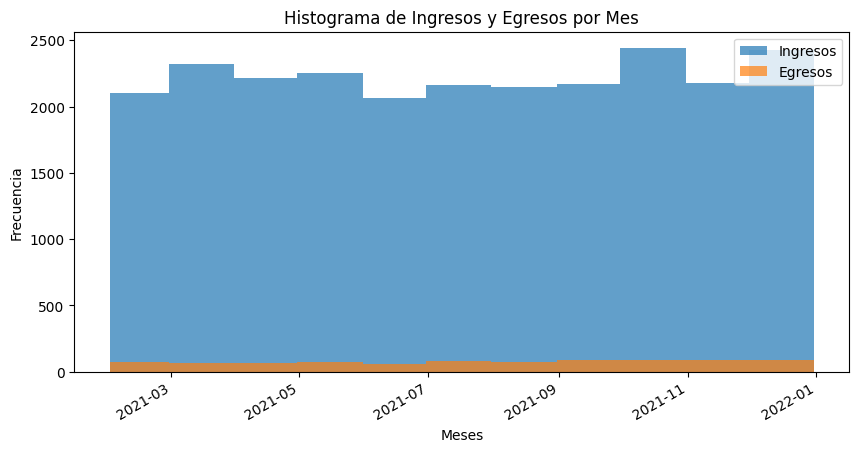

In [ ]:
import matplotlib.pyplot as plt

contabilidad['Fecha'] = pd.to_datetime(contabilidad['Fecha'])

# Creamos dos DataFrames separados para ingresos y egresos basados en el tipo de transacción
ingresos = contabilidad[contabilidad['Tipo_transaccion'] == 'Ingreso']
egresos = contabilidad[contabilidad['Tipo_transaccion'] == 'Egreso']

# Vamos a definir los intervalos de tiempo para los histogramas.
# Supondremos que queremos intervalos mensuales. Si las fechas son diarias y cubren varios meses,
# los bins se podrían definir como cada mes en el rango de fechas.
# Para este ejemplo, vamos a generar intervalos mensuales durante un año para el histograma.

# Definimos los bins para el histograma
bins = pd.date_range(start='2021-01-01', periods=12, freq='M')

# Creamos los histogramas para ingresos y egresos
plt.figure(figsize=(10, 5))

# Histograma para ingresos
plt.hist(ingresos['Fecha'], bins=bins, alpha=0.7, label='Ingresos')

# Histograma para egresos
plt.hist(egresos['Fecha'], bins=bins, alpha=0.7, label='Egresos')

# Añadimos título y etiquetas a los ejes
plt.title('Histograma de Ingresos y Egresos por Mes')
plt.xlabel('Meses')
plt.ylabel('Frecuencia')
plt.legend(loc='upper right')

# Mejoramos la visualización de las fechas en el eje x
plt.gcf().autofmt_xdate()

plt.show()


####5.2.2 Ingresos y gastos por mes



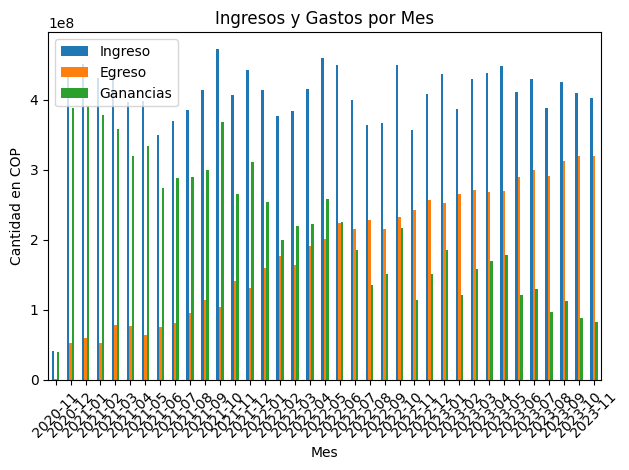

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Cargamos los datos de contabilidad desde el archivo guardado previamente
contabilidad = pd.DataFrame(contabilidad_data)

# Convertimos la columna 'Fecha' a datetime para poder extraer el mes
contabilidad['Fecha'] = pd.to_datetime(contabilidad['Fecha'])

# Agrupamos por mes y tipo de transacción, y luego sumamos los montos
contabilidad_mensual = contabilidad.groupby([contabilidad['Fecha'].dt.to_period('M'), 'Tipo_transaccion'])['Monto'].sum().unstack()

# Rellenamos los valores NaN con 0 ya que representa que no hubo movimiento en ese mes de ese tipo
contabilidad_mensual = contabilidad_mensual.fillna(0)

# Restamos los egresos a los ingresos para obtener las ganancias
contabilidad_mensual['Ganancias'] = contabilidad_mensual['Ingreso'] - contabilidad_mensual['Egreso']

# Graficamos
contabilidad_mensual[['Ingreso', 'Egreso', 'Ganancias']].plot(kind='bar', stacked=False)
plt.title('Ingresos y Gastos por Mes')
plt.xlabel('Mes')
plt.ylabel('Cantidad en COP')
plt.xticks(rotation=45)
plt.tight_layout()  # Ajusta automáticamente los parámetros de la subtrama para dar espacio a los elementos de la figura
plt.legend(loc='upper left')

# Mostramos la gráfica
plt.show()


####5.2.3 Egresos por categoria.


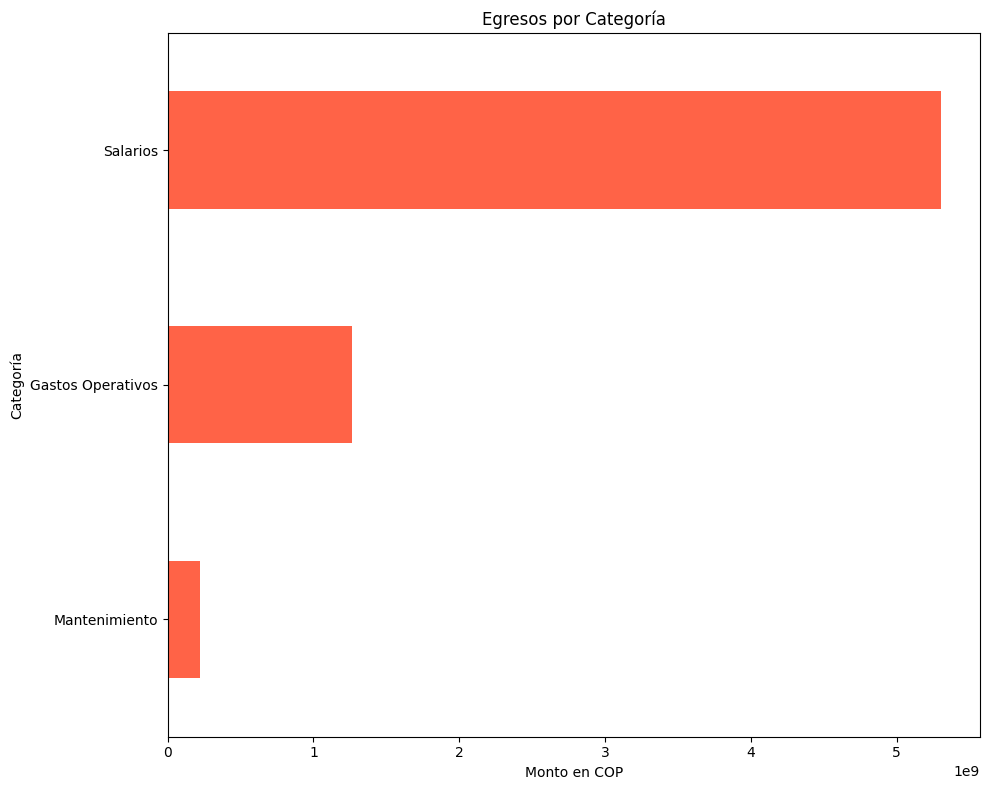

In [ ]:
import matplotlib.pyplot as plt

# Suponiendo que 'contabilidad' es el DataFrame que contiene los datos de contabilidad
# y que tenemos una columna 'Tipo_transaccion' que tiene valores "Ingreso" o "Egreso".

# Filtramos los egresos
egresos = contabilidad[contabilidad['Tipo_transaccion'] == 'Egreso']

# Agrupamos por 'Categoria' y sumamos los 'Monto'
egresos_por_categoria = egresos.groupby('Categoria')['Monto'].sum().sort_values()

# Creamos la gráfica de barras
plt.figure(figsize=(10,8))
egresos_por_categoria.plot(kind='barh', color='tomato')
plt.title('Egresos por Categoría')
plt.xlabel('Monto en COP')
plt.ylabel('Categoría')
plt.tight_layout()  # Ajustar automáticamente los parámetros de la subtrama
plt.show()


####5.2.4 Ingresos por categoria.


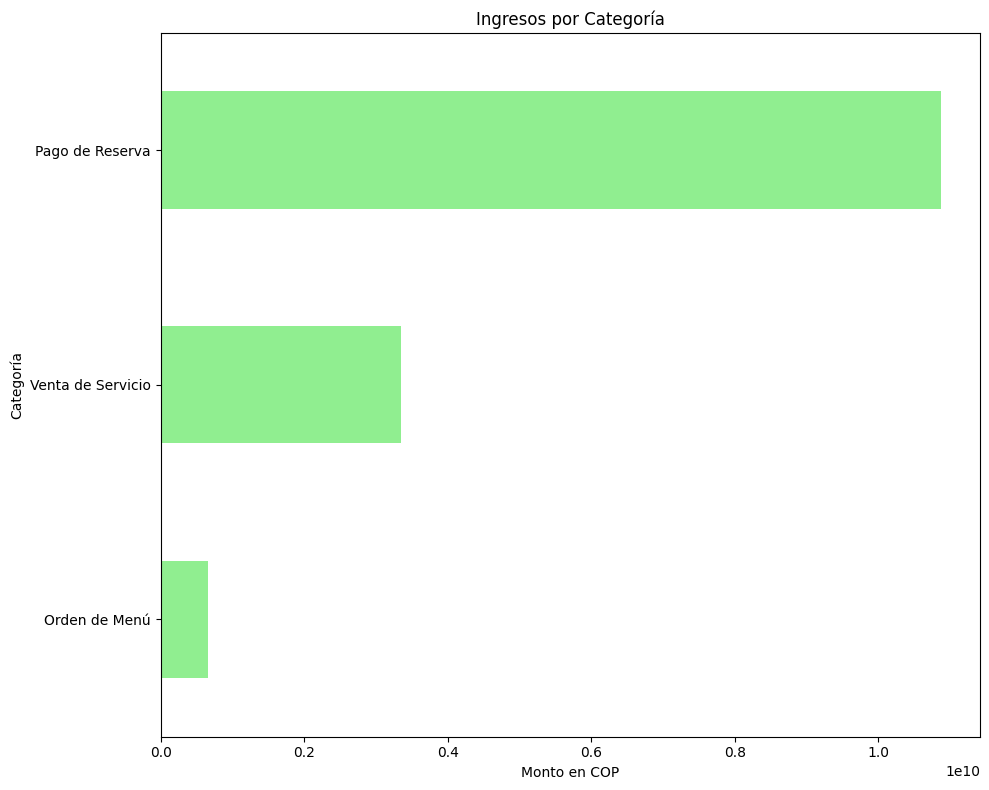

In [ ]:
# Asumiendo que 'contabilidad' es tu DataFrame que contiene los datos de contabilidad.
# Filtramos los ingresos
ingresos = contabilidad[contabilidad['Tipo_transaccion'] == 'Ingreso']

# Agrupamos por 'Categoria' y sumamos los 'Monto'
ingresos_por_categoria = ingresos.groupby('Categoria')['Monto'].sum().sort_values()

# Creamos la gráfica de barras
plt.figure(figsize=(10,8))
ingresos_por_categoria.plot(kind='barh', color='lightgreen')
plt.title('Ingresos por Categoría')
plt.xlabel('Monto en COP')
plt.ylabel('Categoría')
plt.tight_layout()  # Ajustar automáticamente los parámetros de la subtrama
plt.show()


####5.2.5 Salarios por cargo


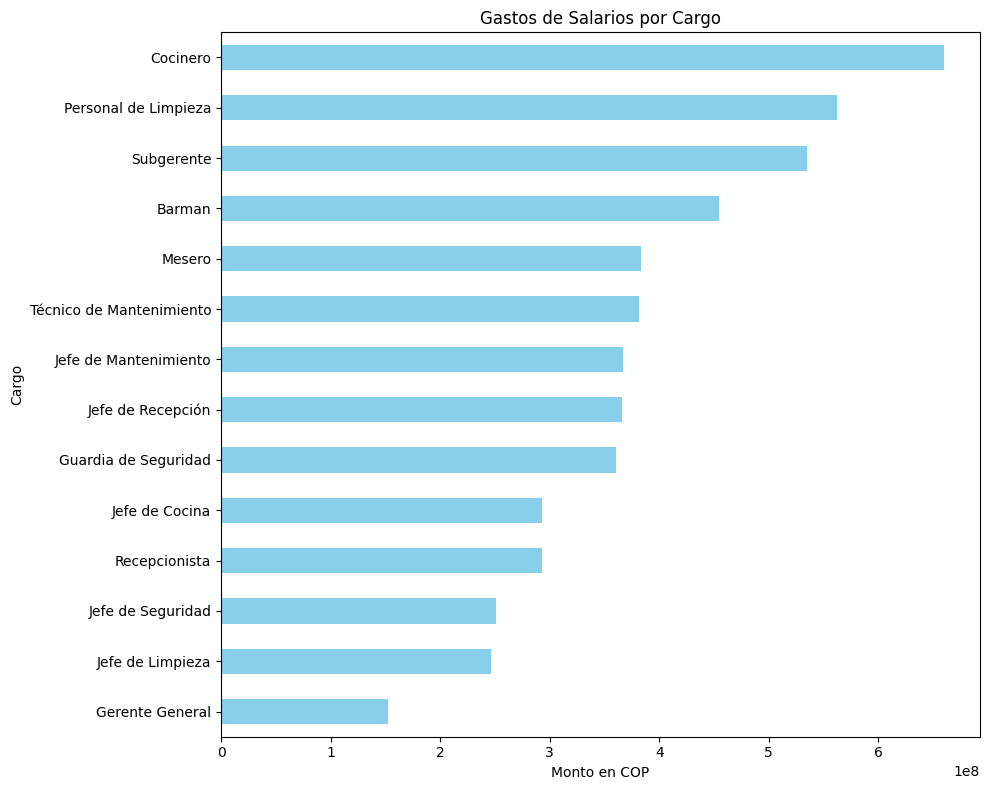

Puesto
Gerente General             152023263
Jefe de Limpieza            246079547
Jefe de Seguridad           251363328
Recepcionista               293066370
Jefe de Cocina              293375388
Guardia de Seguridad        361010174
Jefe de Recepción           365785905
Jefe de Mantenimiento       366534706
Técnico de Mantenimiento    381595182
Mesero                      382944324
Barman                      455015614
Subgerente                  534985055
Personal de Limpieza        562421413
Cocinero                    659854798
Name: Monto, dtype: int64


In [ ]:
salarios_con_cargos = pd.merge(salarios_empleados, cargos, on="Id_cargo")

# Agrupar por el nombre del puesto (Puesto) y sumar los salarios
gastos_por_cargo = salarios_con_cargos.groupby('Puesto')['Monto'].sum().sort_values()

# Crear la gráfica de barras
plt.figure(figsize=(10,8))
gastos_por_cargo.plot(kind='barh', color='skyblue')
plt.title('Gastos de Salarios por Cargo')
plt.xlabel('Monto en COP')
plt.ylabel('Cargo')
plt.tight_layout()
plt.show()

# Mostrar los resultados de la agrupación
print(gastos_por_cargo)


In [ ]:
empleados_count = empleados.groupby('Id_cargo').size()
empleados_por_cargo = cargos.set_index('Id_cargo').join(empleados_count.to_frame(name='Num_empleados'))
empleados_por_cargo = empleados_por_cargo[['Puesto', 'Num_empleados']].reset_index(drop=True)
empleados_por_cargo


,Puesto,Num_empleados
0,Gerente General,1
1,Subgerente,5
2,Jefe de Recepción,5
3,Recepcionista,10
4,Jefe de Mantenimiento,5
5,Técnico de Mantenimiento,10
6,Jefe de Limpieza,5
7,Personal de Limpieza,30
8,Jefe de Cocina,5
9,Cocinero,14


####5.2.7 Pago de salarios en un periodo de 3 años



<ipython-input-75-4fccbad72c4e>:6: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  salarios_por_fecha = salarios_empleados.groupby(salarios_empleados['Fecha_pago'].dt.to_period('M')).sum()


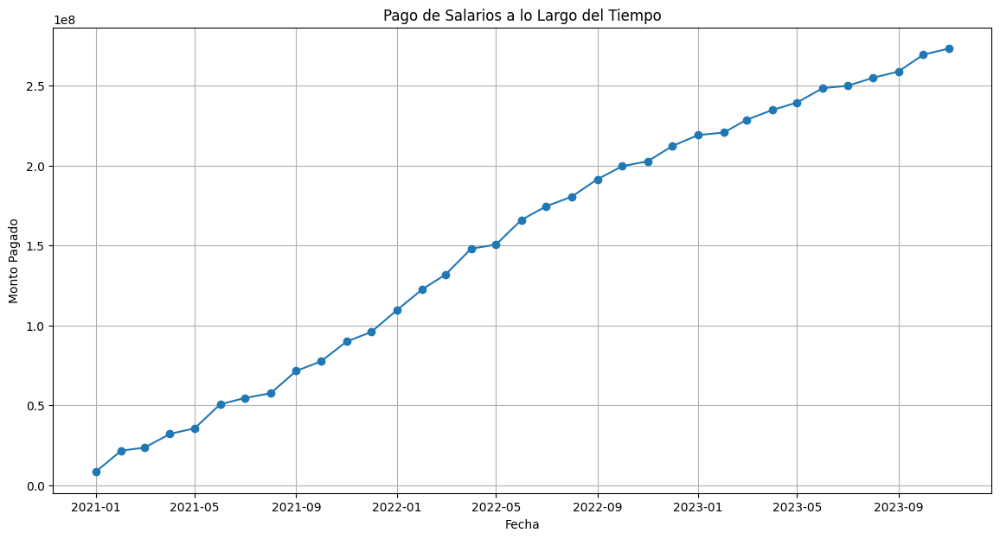

In [ ]:
# Suponiendo que salarios_empleados es tu DataFrame y ya contiene los datos necesarios
# Convertir la columna de fecha de string a datetime
salarios_empleados['Fecha_pago'] = pd.to_datetime(salarios_empleados['Fecha_pago'])

# Agrupar por fecha y sumar los salarios
salarios_por_fecha = salarios_empleados.groupby(salarios_empleados['Fecha_pago'].dt.to_period('M')).sum()

# Restablecer el índice para convertir las fechas de Period a DateTime
salarios_por_fecha = salarios_por_fecha.reset_index()

# Convertir la columna 'Fecha_pago' de nuevo a formato datetime para poder graficar
salarios_por_fecha['Fecha_pago'] = salarios_por_fecha['Fecha_pago'].dt.to_timestamp()

# Graficar
plt.figure(figsize=(14,7))
plt.plot(salarios_por_fecha['Fecha_pago'], salarios_por_fecha['Monto'], marker='o')
plt.title('Pago de Salarios a lo Largo del Tiempo')
plt.xlabel('Fecha')
plt.ylabel('Monto Pagado')
plt.grid(True)
plt.show()


####5.2.8 Numero de empleados en un periodo de 3 años


In [ ]:
empleados['fecha_contratacion'] = pd.to_datetime(empleados['fecha_contratacion'])

# Ahora crearemos una secuencia de fechas mensuales desde la fecha de contratación más antigua hasta la más reciente.
fecha_minima = empleados['fecha_contratacion'].min()
fecha_maxima = empleados['fecha_contratacion'].max()

# Generar la secuencia de fechas mensuales
rango_fechas = pd.date_range(start=fecha_minima, end=fecha_maxima, freq='M')

# Inicializar una lista para guardar el conteo de empleados por mes
empleados_por_mes = []

# Contar el número de empleados contratados antes de cada mes en la secuencia
for fecha in rango_fechas:
    conteo = empleados[empleados['fecha_contratacion'] <= fecha].shape[0]
    empleados_por_mes.append({'Mes': fecha, 'Numero_empleados': conteo})

# Convertir la lista a DataFrame
empleados_por_mes_df = pd.DataFrame(empleados_por_mes)

# Mostrar los primeros registros para verificar
empleados_por_mes_df.head(50)

,Mes,Numero_empleados
0,2020-12-31,4
1,2021-01-31,11
2,2021-02-28,12
3,2021-03-31,16
4,2021-04-30,18
5,2021-05-31,22
6,2021-06-30,23
7,2021-07-31,25
8,2021-08-31,32
9,2021-09-30,33


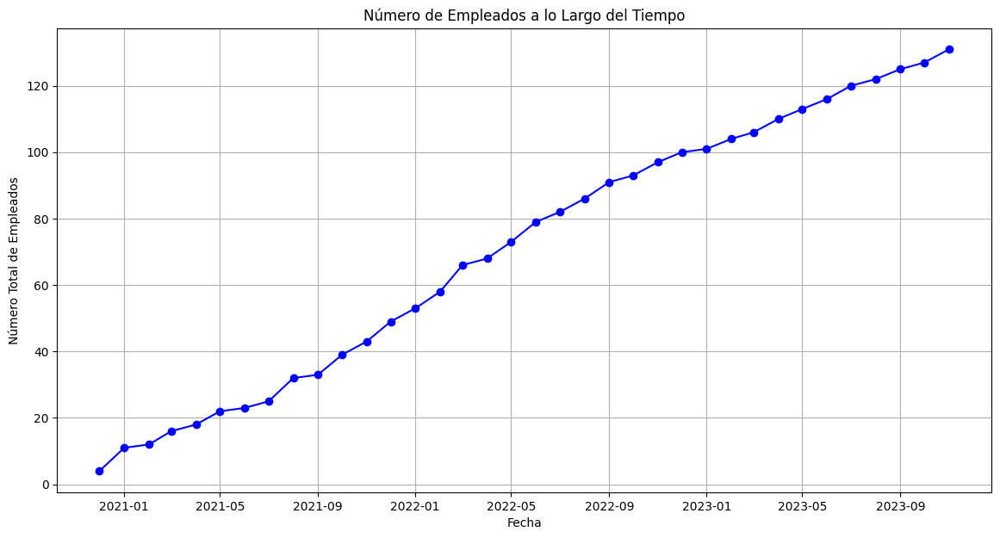

In [ ]:

# Intento de corrección: utilizar una simulación de fechas de contratación si no están disponibles.
try:
    # Verificamos si ya tenemos un dataframe 'empleados' de un paso anterior
    empleados_df = empleados  # Si ya existe, lo usamos
except NameError:
    # Si no existe, generamos fechas de contratación simuladas
    num_empleados = 100
    fechas_contratacion = pd.to_datetime(np.random.choice(pd.date_range(start='2020-01-01', end=datetime.today()), num_empleados))
    empleados_df = pd.DataFrame({
        'Dni_empleado': np.arange(1, num_empleados + 1),
        'fecha_contratacion': fechas_contratacion
    })

# Nos aseguramos de que las fechas estén en orden cronológico
empleados_df.sort_values(by='fecha_contratacion', inplace=True)

# Contamos el número de empleados contratados cada mes y acumulamos el total
empleados_por_mes = empleados_df.groupby(empleados_df['fecha_contratacion'].dt.to_period('M')).size().cumsum()

# Convertimos el índice a fecha para el gráfico
empleados_por_mes.index = empleados_por_mes.index.to_timestamp()

# Graficar el número de empleados a lo largo del tiempo
plt.figure(figsize=(14, 7))
plt.plot(empleados_por_mes.index, empleados_por_mes.values, marker='o', linestyle='-', color='b')
plt.title('Número de Empleados a lo Largo del Tiempo')
plt.xlabel('Fecha')
plt.ylabel('Número Total de Empleados')
plt.grid(True)
plt.show()


####5.2.9 Ordenes por menu.


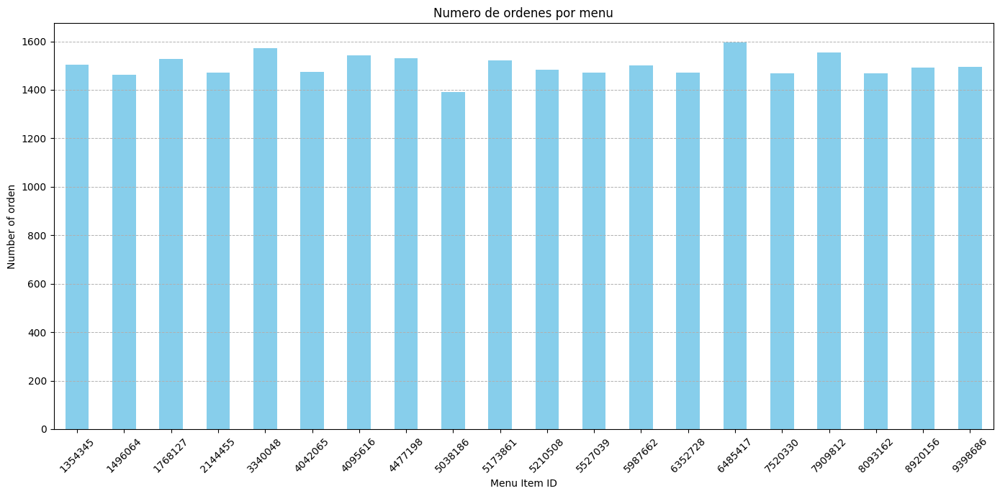

In [ ]:
# Calcula el numero de ordenes de menu por cada item del menu
order_counts = ordenes_menu['Id_menu'].value_counts().sort_index()

# Graficando
plt.figure(figsize=(14, 7))
order_counts.plot(kind='bar', color='skyblue')
plt.title('Numero de ordenes por menu')
plt.xlabel('Menu Item ID')
plt.ylabel('Number of orden')
plt.xticks(rotation=45)
plt.grid(axis='y', linestyle='--', linewidth=0.7)
plt.tight_layout()
plt.show()

In [ ]:
menu.head(30)

,Id_menu,descripcion,precio
0,4042065,Ensalada César,15000
1,8920156,Ensalada de pollo,17000
2,6485417,Sopa de lentejas,12000
3,6352728,Sopa de pollo,14000
4,5173861,Salmón a la parrilla,30000
5,4095616,Pollo a la parrilla,25000
6,1354345,Filete de res,32000
7,9398686,Espagueti a la boloñesa,18000
8,8093162,Pizza margarita,22000
9,2144455,Pizza de peperoni,24000


####5.2.10 Gastos operativos por categoria

In [ ]:
# Agrupamos los gastos operativos por descripción y sumamos los montos
gastos_operativos_clasificados = gastos_operativos.groupby('Descripcion')['Monto'].sum().reset_index()

# Ordenamos los gastos de mayor a menor
gastos_operativos_clasificados = gastos_operativos_clasificados.sort_values(by='Monto', ascending=False)

# Mostramos los resultados
gastos_operativos_clasificados.head(10)


,Descripcion,Monto
4,Pago de arrendamientos,145413401
7,Pago de servicios públicos,140503362
6,Pago de servicios de internet,136159664
0,Compra de insumos para cocina,135865734
2,Mantenimiento de piscina,134391460
1,Compra de mobiliario,125346718
3,Mantenimiento de áreas comunes,124580920
8,Publicidad y marketing,118902444
5,Pago de seguros,108906043
9,Renovación de licencias de software,97210569


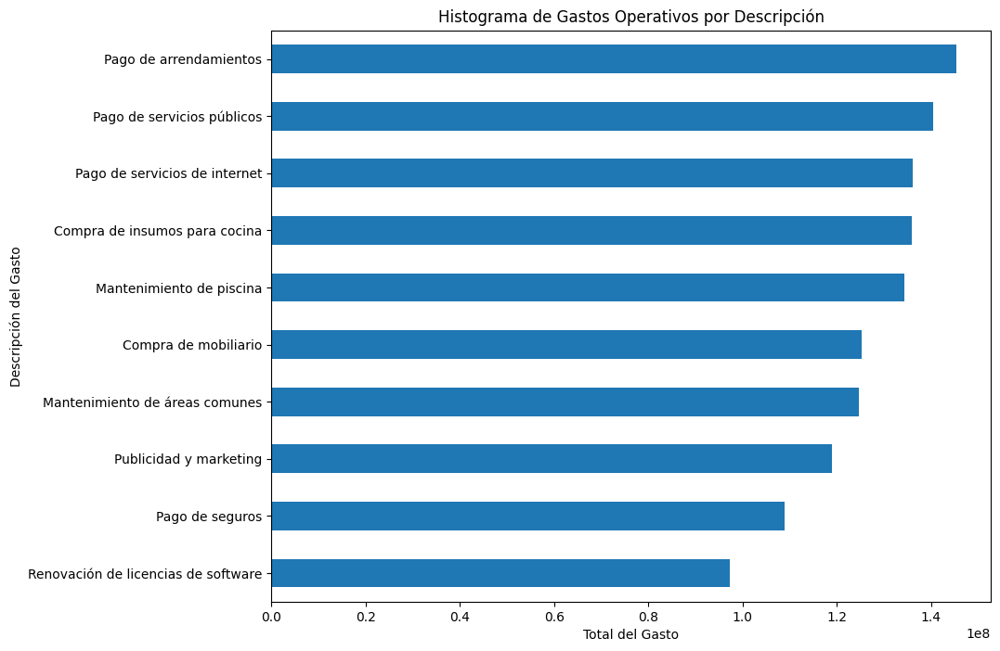

In [ ]:
# Primero, agrupamos los gastos operativos por 'Descripcion' y sumamos los montos
gastos_por_descripcion = gastos_operativos.groupby('Descripcion')['Monto'].sum().sort_values()

# Ahora, creamos el histograma
plt.figure(figsize=(10, 8))
gastos_por_descripcion.plot(kind='barh')
plt.xlabel('Total del Gasto')
plt.ylabel('Descripción del Gasto')
plt.title('Histograma de Gastos Operativos por Descripción')
plt.show()

####5.2.11 Numero de facturas por metodo de pago


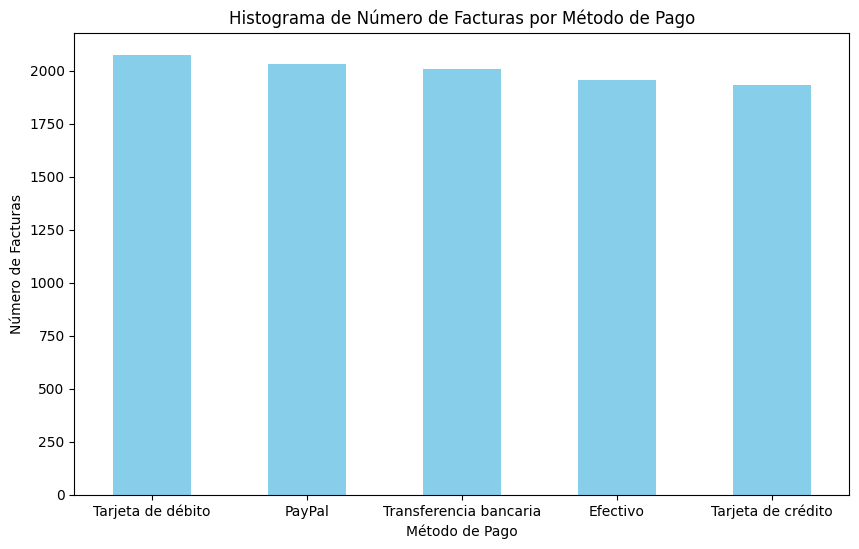

In [ ]:

# Vamos a generar el histograma con los datos que tenemos
plt.figure(figsize=(10, 6))
facturas_clientes['Metodo_pago'].value_counts().plot(kind='bar', color='skyblue')
plt.xlabel('Método de Pago')
plt.ylabel('Número de Facturas')
plt.title('Histograma de Número de Facturas por Método de Pago')
plt.xticks(rotation=0)  # Aseguramos que las etiquetas estén horizontales para mejor lectura
plt.show()


####5.2.12 Numero de facturas por sede.


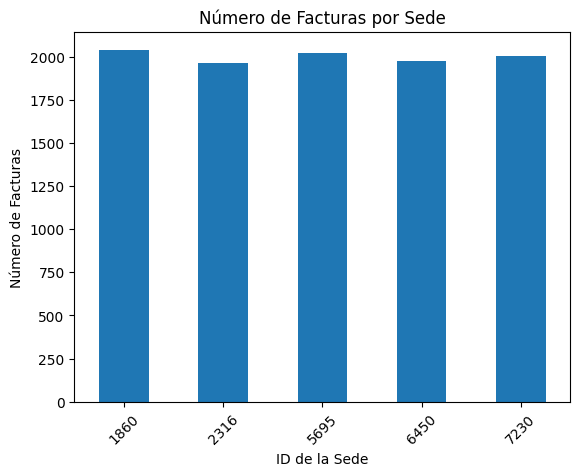

In [ ]:
# Paso 1: Unir 'facturas_clientes' con 'reservas'
facturas_con_reservas = pd.merge(facturas_clientes, reservas, on='Id_reserva')

# Paso 2: Unir el resultado anterior con 'habitaciones'
facturas_con_sedes = pd.merge(facturas_con_reservas, habitaciones, on='Id_habitacion')

# Paso 3: Contar las facturas por sede
facturas_por_sede = facturas_con_sedes.groupby('Id_sede').size()

# Paso 4: Visualizar el resultado en un gráfico de barras
facturas_por_sede.plot(kind='bar')
plt.title('Número de Facturas por Sede')
plt.xlabel('ID de la Sede')
plt.ylabel('Número de Facturas')
plt.xticks(rotation=45)
plt.show()

In [ ]:
sedes.head(10)

,Id_sede,Nombre,Direccion,Ciudad,Telefono,Email,Num_empleados
0,2316,Hernández-Gómez,"Cl. 75 # 1-4 Sur, 153113, Caldas, Boyacá",Cartagena,573166859050,ypinzon@lopez.org,25
1,5695,Vargas-Soto,"Cl. 51 # 9-4 Este, Apartamento 40, 185188, Flo...",Medellín,(+57)3206604746,carmen19@jaramillo-garcia.info,25
2,1860,"Ceballos, Ramos and Cruz","Cr. 158 # 31N-51, 762728, Versalles, Valle del...",Santa Marta,573235901290,marlenymelo@sanabria.info,26
3,6450,Obando-Gutiérrez,"Carrera 163 # 2X-68, 504357, Cumaral, Meta",San Andres,+576083356616,bluna@osorio.com,24
4,7230,"Luna, Pacheco and Sánchez","Carrera 159G Bis # 8-2, Apartamento 145, 50419...",Bogotá,3251401481,scontreras@camacho.net,25


####5.2.13 Egresos y ingresos por categoria.


In [ ]:
# Separar ingresos y egresos
ingresos = contabilidad[contabilidad['Tipo_transaccion'] == 'Ingreso']
egresos = contabilidad[contabilidad['Tipo_transaccion'] == 'Egreso']

# Sumar los montos por categoría
ingresos_por_categoria = ingresos.groupby('Categoria')['Monto'].sum().reset_index(name='Total_Ingresos')
egresos_por_categoria = egresos.groupby('Categoria')['Monto'].sum().reset_index(name='Total_Egresos')

# Unir los DataFrames de ingresos y egresos por categoría
finanzas_por_categoria = pd.merge(ingresos_por_categoria, egresos_por_categoria, on='Categoria', how='outer')

# Llenar los valores NaN con 0 ya que puede haber categorías con solo ingresos o solo egresos
finanzas_por_categoria.fillna(0, inplace=True)

# Visualizar el DataFrame
finanzas_por_categoria


,Categoria,Total_Ingresos,Total_Egresos
0,Orden de Menú,6.629080e+08,0.000000e+00
1,Pago de Reserva,1.087419e+10,0.000000e+00
2,Venta de Servicio,3.341545e+09,0.000000e+00
3,Gastos Operativos,0.000000e+00,1.267280e+09
4,Mantenimiento,0.000000e+00,2.230711e+08
5,Salarios,0.000000e+00,5.306055e+09


In [ ]:
# Correlación entre columnas de la matriz de datos
# ==============================================================================

def Tabular_corr_matrix(corr_mat):
    '''
    Esta función presenta en forma tabular
    la correlación entre pares de columnas eliminando los
    pares iguales
    '''
    corr_mat = corr_mat.stack().reset_index()
    corr_mat.columns = ['variable_1','variable_2','correlación']
    corr_mat = corr_mat.loc[corr_mat['variable_1'] != corr_mat['variable_2'], :]
    corr_mat = corr_mat.sort_values('correlación', ascending=False)

    return(corr_mat)
'''
Seleccionamos las columnas numéricas de la matriz con el fin de calcular
el coeficiente de correlación de Pearson entre ellas
'''
corr_matrix = finanzas_por_categoria.select_dtypes(include=['float64']).corr(method='pearson')
Tabular_corr_matrix(corr_matrix).head(8)

,variable_1,variable_2,correlación
1,Total_Ingresos,Total_Egresos,-0.371741
2,Total_Egresos,Total_Ingresos,-0.371741


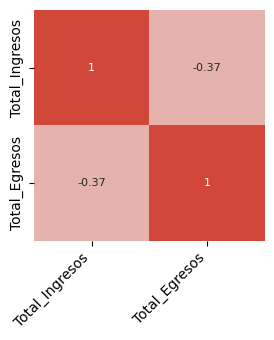

In [ ]:
# Mapa de "calor" para la matriz de correlaciones
# ==============================================================================
import seaborn as sns
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(3, 3))

sns.heatmap(
    corr_matrix,
    annot     = True,
    cbar      = False,
    annot_kws = {"size": 8},
    vmin      = -1,
    vmax      = 1,
    center    = 0,
    cmap      = sns.diverging_palette(15, 15, n=20),
    square    = True,
    ax        = ax
)

ax.set_xticklabels(
    ax.get_xticklabels(),
    rotation = 45,
    horizontalalignment = 'right',
)

ax.tick_params(labelsize = 10)

####5.2.14 Costo total de mantenimientos por mes.


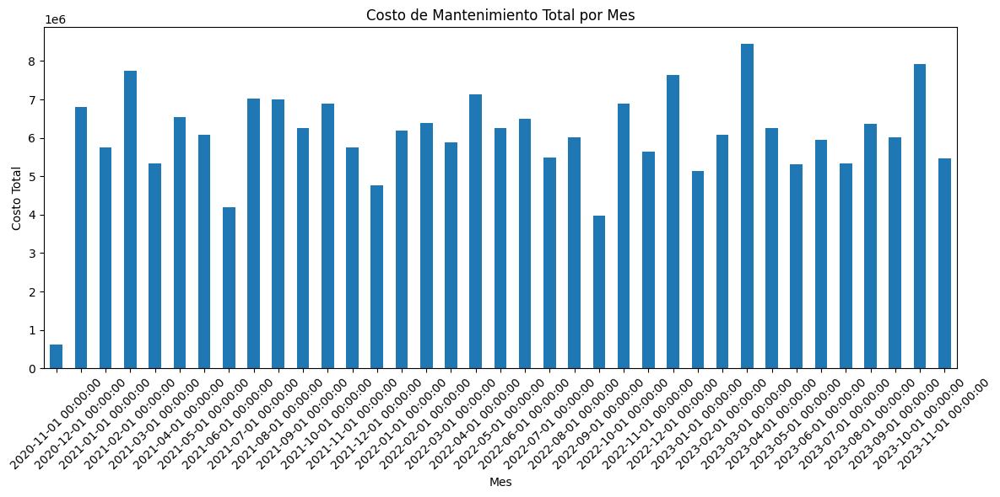

In [ ]:
# Convertir la columna 'Fecha' a datetime si aún no lo es
mantenimientos['Fecha'] = pd.to_datetime(mantenimientos['Fecha'])

# Agrupar por mes y sumar los costos
mantenimientos_por_mes = mantenimientos.groupby(mantenimientos['Fecha'].dt.to_period('M'))['Costo'].sum()

# Convertir el índice PeriodIndex a DateTimeIndex para el trazado
mantenimientos_por_mes.index = mantenimientos_por_mes.index.to_timestamp()

# Graficar
mantenimientos_por_mes.plot(kind='bar', figsize=(12, 6))
plt.title('Costo de Mantenimiento Total por Mes')
plt.xlabel('Mes')
plt.ylabel('Costo Total')
plt.xticks(rotation=45)  # Rota las etiquetas del eje x para una mejor visualización
plt.tight_layout()  # Ajusta automáticamente los parámetros de la subtrama
plt.show()

####5.2.15 Costo mantenimiento total por sede

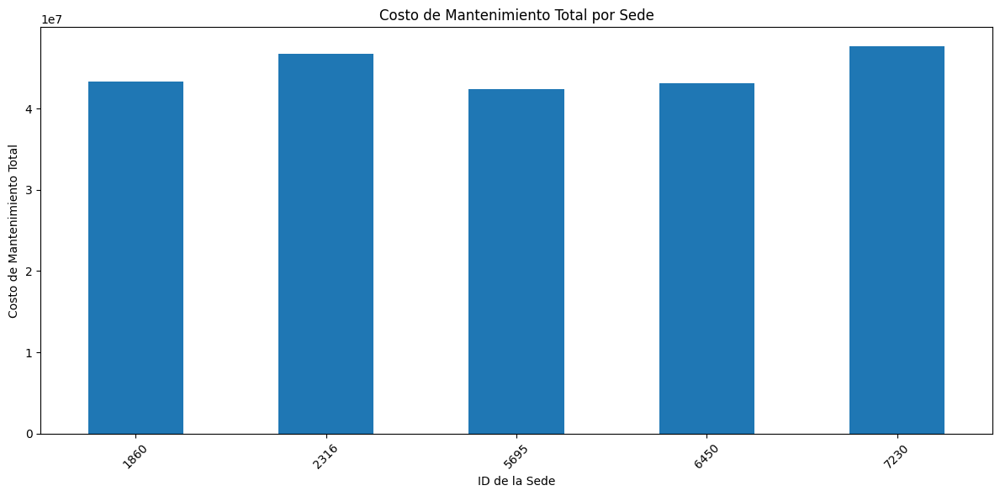

In [ ]:
# Unir el DataFrame de mantenimientos con el de habitaciones para obtener 'Id_sede'
mantenimientos_con_sede = pd.merge(mantenimientos, habitaciones, on='Id_habitacion')

# Agrupar por 'Id_sede' y sumar los costos de mantenimiento
costo_mantenimiento_por_sede = mantenimientos_con_sede.groupby('Id_sede')['Costo'].sum()

# Graficar el costo total de mantenimiento por sede
costo_mantenimiento_por_sede.plot(kind='bar', figsize=(12, 6))
plt.title('Costo de Mantenimiento Total por Sede')
plt.xlabel('ID de la Sede')
plt.ylabel('Costo de Mantenimiento Total')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [ ]:
sedes.head(10)

,Id_sede,Nombre,Direccion,Ciudad,Telefono,Email,Num_empleados
0,2316,Hernández-Gómez,"Cl. 75 # 1-4 Sur, 153113, Caldas, Boyacá",Cartagena,573166859050,ypinzon@lopez.org,25
1,5695,Vargas-Soto,"Cl. 51 # 9-4 Este, Apartamento 40, 185188, Flo...",Medellín,(+57)3206604746,carmen19@jaramillo-garcia.info,25
2,1860,"Ceballos, Ramos and Cruz","Cr. 158 # 31N-51, 762728, Versalles, Valle del...",Santa Marta,573235901290,marlenymelo@sanabria.info,26
3,6450,Obando-Gutiérrez,"Carrera 163 # 2X-68, 504357, Cumaral, Meta",San Andres,+576083356616,bluna@osorio.com,24
4,7230,"Luna, Pacheco and Sánchez","Carrera 159G Bis # 8-2, Apartamento 145, 50419...",Bogotá,3251401481,scontreras@camacho.net,25


#####5.2.15.1 Costo de mantenimiento por sede en el tiempo.

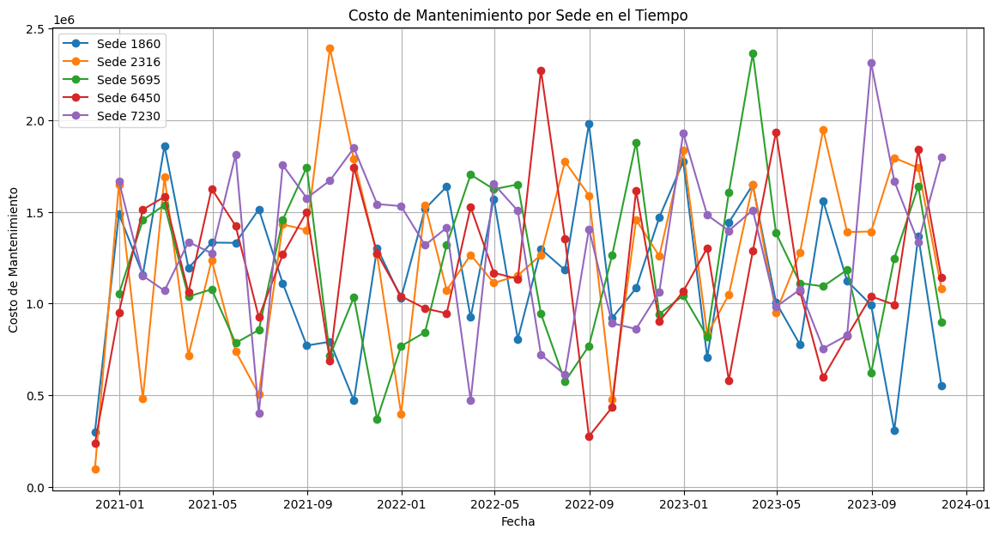

In [ ]:
# Primero, necesitaríamos unir los mantenimientos con las habitaciones para obtener el Id_sede
mantenimientos_con_sede = pd.merge(mantenimientos, habitaciones, on='Id_habitacion')

# Convertir la columna 'Fecha' al tipo datetime si aún no lo es.
mantenimientos_con_sede['Fecha'] = pd.to_datetime(mantenimientos_con_sede['Fecha'])

# Agrupar por 'Id_sede' y 'Fecha' y sumar los costos de mantenimiento
mantenimientos_por_sede_fecha = mantenimientos_con_sede.groupby(['Id_sede', pd.Grouper(key='Fecha', freq='M')])['Costo'].sum().reset_index()

# Crear una gráfica de línea para cada sede
plt.figure(figsize=(14, 7))

for sede in mantenimientos_por_sede_fecha['Id_sede'].unique():
    sede_data = mantenimientos_por_sede_fecha[mantenimientos_por_sede_fecha['Id_sede'] == sede]
    plt.plot(sede_data['Fecha'], sede_data['Costo'], marker='o', label=f'Sede {sede}')

plt.title('Costo de Mantenimiento por Sede en el Tiempo')
plt.xlabel('Fecha')
plt.ylabel('Costo de Mantenimiento')
plt.legend()
plt.grid(True)
plt.show()

#####5.2.15.2 Ingresos por sede en el tiempo.

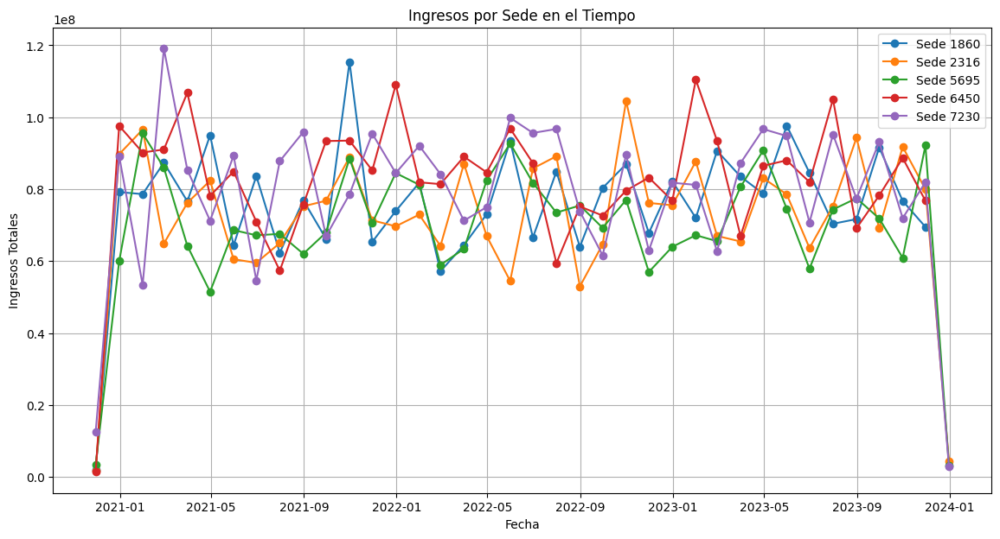

In [ ]:
# Unimos 'reservas' con 'habitaciones' para obtener 'Id_sede' en 'reservas'
reservas_con_sede = pd.merge(reservas, habitaciones, on='Id_habitacion')

# Unimos el resultado anterior con 'facturas_clientes' para obtener los ingresos
reservas_facturas = pd.merge(reservas_con_sede, facturas_clientes, on='Id_reserva')

# Convertimos la columna 'Fecha' a datetime
reservas_facturas['Fecha'] = pd.to_datetime(reservas_facturas['Fecha'])

# Agrupamos por 'Id_sede' y 'Fecha', y sumamos los montos de las facturas para obtener los ingresos
ingresos_por_sede_fecha = reservas_facturas.groupby(['Id_sede', pd.Grouper(key='Fecha', freq='M')])['Monto_total'].sum().reset_index()

# Creamos la gráfica de ingresos por sede en el tiempo
plt.figure(figsize=(14, 7))

# Dibujamos una línea para cada sede
for sede in ingresos_por_sede_fecha['Id_sede'].unique():
    sede_ingresos = ingresos_por_sede_fecha[ingresos_por_sede_fecha['Id_sede'] == sede]
    plt.plot(sede_ingresos['Fecha'], sede_ingresos['Monto_total'], marker='o', label=f'Sede {sede}')

plt.title('Ingresos por Sede en el Tiempo')
plt.xlabel('Fecha')
plt.ylabel('Ingresos Totales')
plt.legend()
plt.grid(True)
plt.show()

In [ ]:
sedes.head(10)

,Id_sede,Nombre,Direccion,Ciudad,Telefono,Email,Num_empleados
0,2316,Hernández-Gómez,"Cl. 75 # 1-4 Sur, 153113, Caldas, Boyacá",Cartagena,573166859050,ypinzon@lopez.org,25
1,5695,Vargas-Soto,"Cl. 51 # 9-4 Este, Apartamento 40, 185188, Flo...",Medellín,(+57)3206604746,carmen19@jaramillo-garcia.info,25
2,1860,"Ceballos, Ramos and Cruz","Cr. 158 # 31N-51, 762728, Versalles, Valle del...",Santa Marta,573235901290,marlenymelo@sanabria.info,26
3,6450,Obando-Gutiérrez,"Carrera 163 # 2X-68, 504357, Cumaral, Meta",San Andres,+576083356616,bluna@osorio.com,24
4,7230,"Luna, Pacheco and Sánchez","Carrera 159G Bis # 8-2, Apartamento 145, 50419...",Bogotá,3251401481,scontreras@camacho.net,25


######5.2.15.2.1 Ingresos por sede en un 1 año (2020-2023)

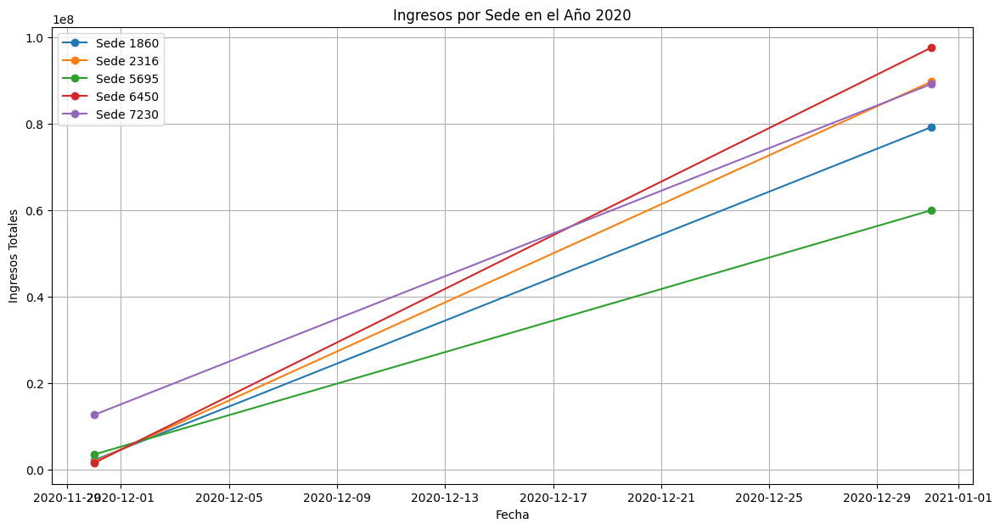

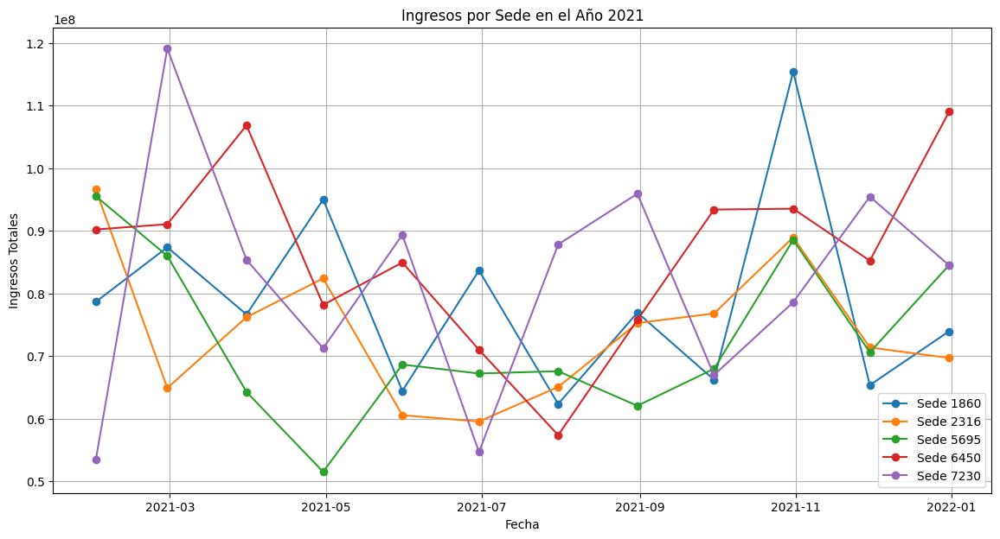

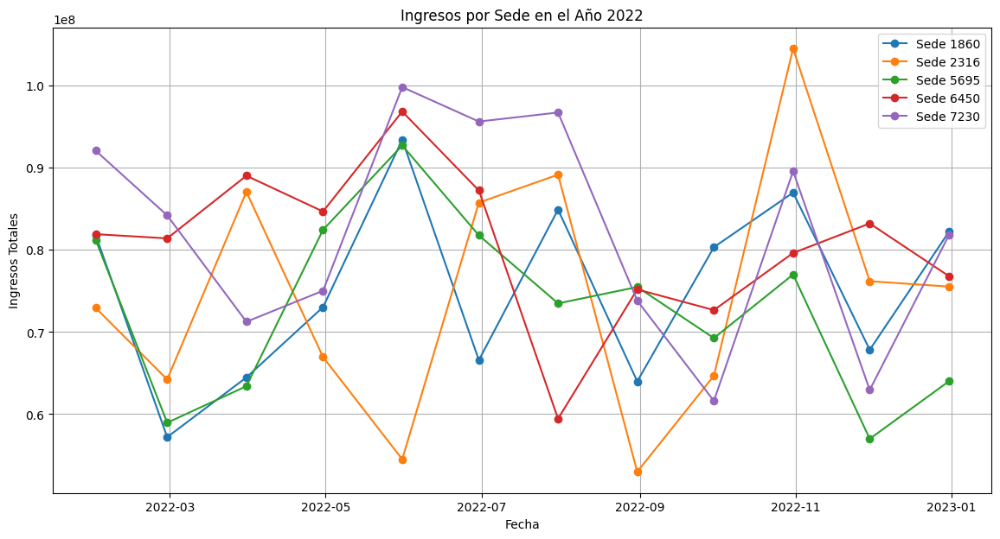

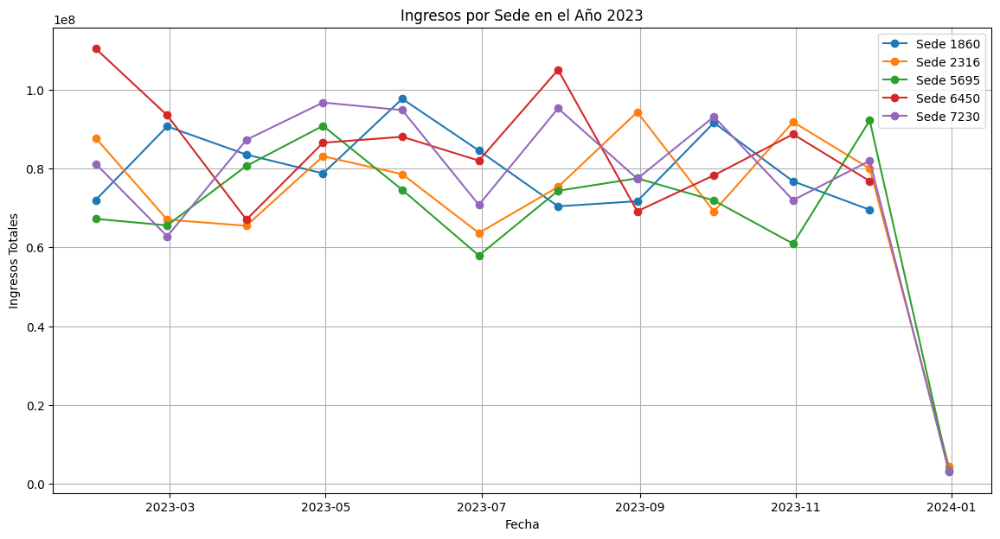

In [ ]:

# Unimos 'reservas' con 'habitaciones' para obtener 'Id_sede' en 'reservas'
reservas_con_sede = pd.merge(reservas, habitaciones, on='Id_habitacion')

# Unimos el resultado anterior con 'facturas_clientes' para obtener los ingresos
reservas_facturas = pd.merge(reservas_con_sede, facturas_clientes, on='Id_reserva')

# Convertimos la columna 'Fecha' a datetime
reservas_facturas['Fecha'] = pd.to_datetime(reservas_facturas['Fecha'])

# Encontrar el rango de años para los que tenemos datos
años = reservas_facturas['Fecha'].dt.year.unique()

# Crear un gráfico para cada año dentro del rango
for año in sorted(años):
    # Filtrar los datos para el año actual
    df_año = reservas_facturas[reservas_facturas['Fecha'].dt.year == año]

    # Agrupar por 'Id_sede' y 'Fecha', y sumamos los montos de las facturas para obtener los ingresos
    ingresos_por_sede_año = df_año.groupby(['Id_sede', pd.Grouper(key='Fecha', freq='M')])['Monto_total'].sum().reset_index()

    # Crear la gráfica de ingresos por sede para el año actual
    plt.figure(figsize=(14, 7))
    for sede in ingresos_por_sede_año['Id_sede'].unique():
        datos_sede = ingresos_por_sede_año[ingresos_por_sede_año['Id_sede'] == sede]
        plt.plot(datos_sede['Fecha'], datos_sede['Monto_total'], marker='o', label=f'Sede {sede}')

    plt.title(f'Ingresos por Sede en el Año {año}')
    plt.xlabel('Fecha')
    plt.ylabel('Ingresos Totales')
    plt.legend()
    plt.grid(True)
    plt.show()

Aca surge una idea y es que dados un conjunto de datos reales de un hotel se podrian emplear metodos para intentar buscar la funcion aproxima la periodicidad de la cantidad de ingresos por año o en el tiempo buscando asi patrones

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.fft import fft

# Supongamos que 'ingresos_por_sede_fecha' es nuestro DataFrame que ya contiene los ingresos por fecha para cada sede.
# Elegimos una sede en particular, por ejemplo, sede con 'Id_sede' igual a 'A'.

# Filtramos los datos para la sede 'A'
sede_a_data = ingresos_por_sede_fecha[ingresos_por_sede_fecha['Id_sede'] == 'A']

# Aseguramos que los datos estén ordenados por fecha y no falten fechas en la serie temporal
sede_a_data = sede_a_data.set_index('Fecha').asfreq('M').fillna(method='ffill')

# Aplicamos la Transformada de Fourier a los ingresos de la sede 'A'
frecuencias = fft(sede_a_data['Monto_total'].values)

# Calculamos las magnitudes de las frecuencias y la frecuencia correspondiente
magnitudes = np.abs(frecuencias)
frecuencia = np.fft.fftfreq(len(magnitudes), d=1)  # 'd' es el intervalo de tiempo entre muestras, 1 mes en este caso.

# Graficamos el espectro de frecuencia
plt.figure(figsize=(14, 7))
plt.stem(frecuencia, magnitudes)
plt.title('Espectro de Frecuencia de Ingresos para la Sede A')
plt.xlabel('Frecuencia (1/mes)')
plt.ylabel('Magnitud')
plt.grid(True)
plt.show()

# La interpretación de este espectro requerirá conocimientos adicionales de análisis de series temporales.


##6. Modelos de clasificacion.


###6.1 Arboles de clasificacion

In [ ]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, accuracy_score


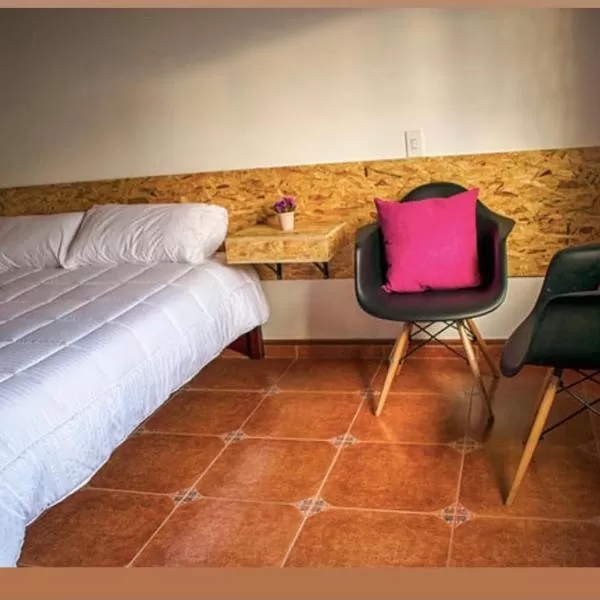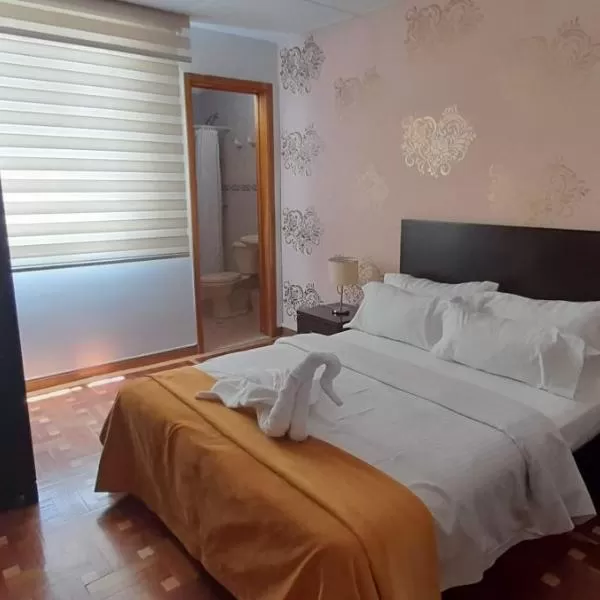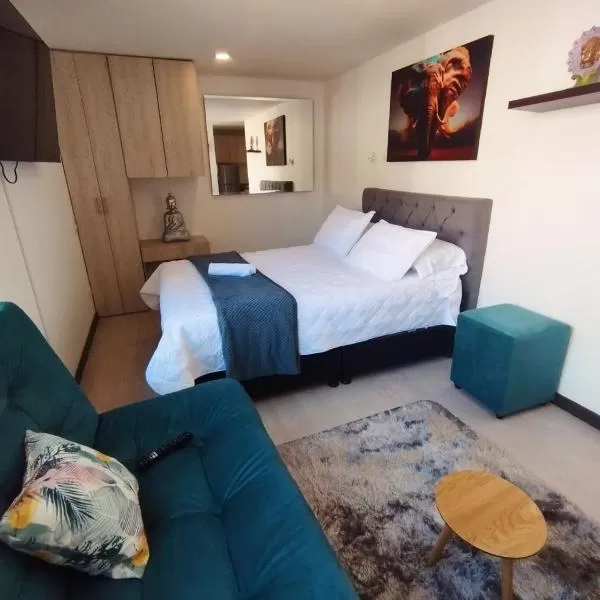

###6.2 Modelo de clasificacion de imagenes (TensorFlow y Keras)

**Hipotesis: Existe una correlacion entre el precio de la habitacion y la imagen que tienen para promocionarla.**

In [ ]:
# Asumiendo que las imágenes están en una carpeta llamada 'imagenes_hoteles' y tienen formato .jpg
data['image_path'] = data['indice'].apply(lambda x: f'ruta/a/imagenes_hoteles/hotel_{x}.jpg')

In [ ]:
from sklearn.model_selection import train_test_split

train_data, test_data = train_test_split(data, test_size=0.2, random_state=42)
train_data, val_data = train_test_split(train_data, test_size=0.25, random_state=42)  # 0.25 x 0.8 = 0.2


In [ ]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# Asumiendo un tamaño estándar para las imágenes
tamaño_imagen = (256, 256)
tamaño_lote = 32

train_datagen = ImageDataGenerator(rescale=1./255, ...)
val_datagen = ImageDataGenerator(rescale=1./255)

train_generator = train_datagen.flow_from_dataframe(
    train_data,
    x_col='image_path',
    y_col='label',  #
    target_size=tamaño_imagen,
    batch_size=tamaño_lote,
    class_mode='raw'  # o 'categorical'
)

val_generator = val_datagen.flow_from_dataframe(
    val_data,
    x_col='image_path',
    y_col='label',
    target_size=tamaño_imagen,
    batch_size=tamaño_lote,
    class_mode='raw'
)


In [ ]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout
num_categorias = 4

# Definir la arquitectura del modelo
modelo = Sequential([
    Conv2D(32, (3, 3), activation='relu', input_shape=(tamaño_imagen[0], tamaño_imagen[1], 3)),
    MaxPooling2D(2, 2),
    Conv2D(64, (3, 3), activation='relu'),
    MaxPooling2D(2, 2),
    Flatten(),
    Dense(128, activation='relu'),
    Dense(num_categorias, activation='softmax')  # softmax para clasificación categórica
])

# Compilar el modelo
modelo.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])


In [ ]:
# Entrenar el modelo
historial = modelo.fit(
    train_generator,
    validation_data=val_generator,
    epochs=10,  # Ajustar según sea necesario
    batch_size=tamaño_lote
)


In [ ]:
# Evaluar el modelo
resultados = modelo.evaluate(val_generator)
print(f"Pérdida de validación: {resultados[0]}, Métrica de validación (MAE): {resultados[1]}")


Hasta el momento se ha desarrollado el diseño, desarrollo de la base de datos , generacion de datos y un conjunto de consultas en sql, todo esto con el fin de simular el hipotetico estado de un negocio de hoteles, bajo ciertas reglas que en principio seran definidas por los propietarios, pero que en este caso se eligieron bajo ciertas suposiciones, es decir , puede que un negocio no necesite abarcar tantas tablas o por el contrario sean insuficientes para las espectativas del propietario, sin embargo proporciona una estructura que intenta cubrir varios aspectos relevantes en la dinamica de este tipo de negocio. Otro de nuestros objetivos es poder enriquecer nuestra base de datos o por lo menos orientar parte de las decisiones que se vallan a tomar basandonos en compararaciones con datos que se encuentran en la web usando metodos de automatizacion para obtener todos esos datos que son publicos en las paginas web, en este caso se uso selenium para automatizar la recopilacion de datos usando el navegador,como se observo en el codigo de la seccion de scraping, se obtuvo los hoteles que brindaban servicios para cierto tipo de fechas, en general este metodo sirve para enriquecer la base con datos directos de los competidores y usando reiteradamente en intervalos de tiempo podria proporcionar los suficientes datos para evaluar los comportamientos del mercado.  

Ya asociada la cuenta de drive, se procede almacenar a guardar la direccion de las carpetas, los datos de entrenamiento y validacion se encuentran previamente clasificados, por cada clase de raza se guarda la direccion de la carpeta

In [ ]:

# Directorios donde se encuentran almacenadas las imagenenes de entrenamiento clasificadas
Entrenam_baja_dir = os.path.join('/content/drive/MyDrive/Data/Entrenamiento/baja')

Entrenam_media_dir = os.path.join('/content/drive/MyDrive/Data/Entrenamiento/media')

Entrenam_alta_dir = os.path.join('/content/drive/MyDrive/Data/Entrenamiento/alta')

#  Directorios donde se encuentran almacenadas de imagenes de verificacion
validacion_baja_dir = os.path.join('/content/drive/MyDrive/Data/Validacion/baja')

validacion_media_dir = os.path.join('/content/drive/MyDrive/Data/Validacion/media')

validacion_alta_dir = os.path.join('/content/drive/MyDrive/Data/Validacion/alta')


Posteriormente, se accede a las imagenes en las direcciones guardadas estas se alojan en un arreglo y de esta forma es que se accedera a ellas en el momento de pasarla por las capas convolucionales


In [ ]:
#
Entrenam_labrador=os.listdir(Entrenam_baja_dir)
Entrenam_beagle=os.listdir(Entrenam_media_dir)
Entrenam_basset=os.listdir(Entrenam_alta_dir)
print(Entrenam_basset)

['n02088238_9933.jpg', 'n02088238_9717.jpg', 'n02088238_2822.jpg', 'n02088238_9257.jpg', 'n02088238_6708.jpg', 'n02088238_2879.jpg', 'n02088238_9947.jpg', 'n02088238_9324.jpg', 'n02088238_9718.jpg', 'n02088238_490.jpg', 'n02088238_9267.jpg', 'n02088238_2217.jpg', 'n02088238_9626.jpg', 'n02088238_6988.jpg', 'n02088238_9789.jpg', 'n02088238_6017.jpg', 'n02088238_305.jpg', 'n02088238_6012.jpg', 'n02088238_8140.jpg', 'n02088238_9797.jpg', 'n02088238_2009.jpg', 'n02088238_4182.jpg', 'n02088238_6707.jpg', 'n02088238_7131.jpg', 'n02088238_517.jpg', 'n02088238_9787.jpg', 'n02088238_3066.jpg', 'n02088238_664.jpg', 'n02088238_3359.jpg', 'n02088238_8480.jpg', 'n02088238_8839.jpg', 'n02088238_658.jpg', 'n02088238_1261.jpg', 'n02088238_9986.jpg', 'n02088238_9015.jpg', 'n02088238_9635.jpg', 'n02088238_1944.jpg', 'n02088238_7232.jpg', 'n02088238_6812.jpg', 'n02088238_9815.jpg', 'n02088238_9529.jpg', 'n02088238_9600.jpg', 'n02088238_9960.jpg', 'n02088238_9419.jpg', 'n02088238_665.jpg', 'n02088238_4365

La siguiente funcion es la que crea la red convolucional llamando la libreria tensorflow y keras de tal forma que se define una secuencia  de capas compuesta por un conjunto convoluciones, para cada una de las convolucion se hace uso de tf.keras.layer.conv2d que es un funcion que acepta como paramentros el numero de filtros que se haran por cada imagen en la primera capa de las convoluciones que seran de tamaño 3x3 y que en su primera capa aceptara imagenes de tamaño 500x500 pixeles con tres tipos de entradas (red,green,blue) en esta convolucion se obtendran 16 filtros. Luego de esto se hace un pooling con el fin de reducir el tamaño de las imagenes y conservar los aspectos mas relevantes de esta, para ello se llama la funcion tf.keras.layers.maxPooling2D de tamaño 2x2.

Para cada convolucion se ajusta el numero filtros que tendra y la funcion de activacion "relu" que transforma los valores introducidos anulando los valores negativos y dejando los positivos tal y como entran.

Esta red consiste de 3 convoluciones y 3 maxpooling las cuales van modificando y extrayendo las caracteristicas que mas destacan,posteriormente se hace uso del comando Fflatten el cual toma el arreglo correspondiente a la imagen y lo pasa a una dimension es decir lo vuelve un n-vector se crea una capa de 512 neuronas y para la ultima capa el 3 corresponde al numero de clases y la funcion de activacion softmax la cual asignara un valor de probabilidad entre 0 y 1 ,es decir, softmax asigna probabilidades decimales a cada clase en un caso de clases múltiples. Esas probabilidades decimales deben sumar 1.0. Esta restricción adicional permite que el entrenamiento converja más rápido.




In [ ]:
model = tf.keras.models.Sequential([
    # Dentro de la red neouronal convolucional se ajustan los datos a un tamaño de entrada especifico con 3 colores with 3 bytes color
    # La primera convolucion de tamaño 3x3 y un maxpoolin 2x2
    tf.keras.layers.Conv2D(16, (3,3), activation='relu', input_shape=(500, 500, 3)),
    tf.keras.layers.MaxPooling2D(2, 2),
    # Segunda Convolucion
    tf.keras.layers.Conv2D(32, (3,3), activation='relu'),
    tf.keras.layers.MaxPooling2D(2,2),
    # Tercera Convolucion
    tf.keras.layers.Conv2D(64, (3,3), activation='relu'),
    tf.keras.layers.MaxPooling2D(2,2),
    # Cuarta convolucion
    #tf.keras.layers.Conv2D(64, (3,3), activation='relu'),
    #tf.keras.layers.MaxPooling2D(2,2),
    # Quinta convolucion
    #tf.keras.layers.Conv2D(64, (3,3), activation='relu'),
    #tf.keras.layers.MaxPooling2D(2,2),
    # Linealizando los arreglos de cada imagen
    tf.keras.layers.Flatten(),
    # 512 Capas de neuronas
    tf.keras.layers.Dense(512, activation='relu'),
    # Se define el numero de clases a clasificar , con la funcion de activacion softmax
    tf.keras.layers.Dense(3, activation='softmax')
])
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 498, 498, 16)      448       
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 249, 249, 16)      0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 247, 247, 32)      4640      
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 123, 123, 32)      0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 121, 121, 64)      18496     
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 60, 60, 64)        0         
_________________________________________________________________
flatten (Flatten)            (None, 230400)            0

La siguiente funcion compila el modelo de neuronal antes definido con una funcion de perdida categorical_croosentropy mide las desviaciones que existen entre las distintas clases, el optimizador que en este caso es la funcion RMSprop (raíz cuadrada media), es una medida de precisión calculada como la raíz cuadrada media de los residuos. Se entiende como residuos la diferencia entre el valor previsto (correcto) y el valor real obtenido. Por ultimo se define una forma de medir la cantidad de valores que el modelo ha acertado dicha medida es la exactitud (accuracy) que mide el porcentaje de casos que el modelo ha acertado

In [ ]:
from tensorflow.keras.optimizers import RMSprop

model.compile(loss='categorical_crossentropy',
              optimizer=RMSprop(lr=0.001),
              metrics=['accuracy'])

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/optimizer_v2/optimizer_v2.py:375: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  "The `lr` argument is deprecated, use `learning_rate` instead.")



Antes de entrenar el sistema es necesario que todas las imagenes posean el mismo tamaño y definir el batch_size que viene siendo el paquete de imagenes con el cual por cada epoch que suceda en el entrenamiento va a ser el resultado de analizar  ese numero de imagenes.


In [ ]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# Normalizando las imagenes 1./255
generadordatentrena = ImageDataGenerator(rescale=1/255,shear_range=0.3,zoom_range=0.3,horizontal_flip=True)
generadordatvalid = ImageDataGenerator(rescale=1/255)

# Flujo de entrenamiento en paquetes(Bach_size) de 25 imagenes
GeneradorEntrenam = generadordatentrena.flow_from_directory(
        '/content/drive/MyDrive/Data/Entrenamiento',  # Fuente con imagenes de entremanimento
        target_size=(500, 500),  # Reajusta las imagenes para que tengan una entrada de  500*500
        batch_size=25,
        class_mode='categorical')

# El flujo de imagenes de validacion a traves de la red neuronal va a ser en grupos de 8 imagenes
GeneradorValidac = generadordatvalid.flow_from_directory(
        '/content/drive/MyDrive/Data/Validacion',  # This is the source directory for training images
        target_size=(500, 500),  # All images will be resized to 300x300
        batch_size=8,
        class_mode='categorical')

Found 370 images belonging to 3 classes.
Found 171 images belonging to 3 classes.


Creadas las carpetas anteriores ahora se procede a entrenar el modelo llamando el objeto fit que acepta como parametro la carpeta en donde se encuentran alojadas las imagenes de entrenamiento, se realizaran 8 pasos por cada epoch,
la variable epoch se usa para definir el numero de veces que el sistema determinara los valores de perdida y certeza.


In [ ]:
history = model.fit(
      GeneradorEntrenam,
      steps_per_epoch=8,
      epochs=15,
      verbose=1,
      validation_data = GeneradorValidac,
      validation_steps=8)

Epoch 1/15
8/8 [==============================] - 93s 11s/step - loss: 22.4872 - accuracy: 0.3050 - val_loss: 1.1029 - val_accuracy: 0.3750
Epoch 2/15
8/8 [==============================] - 78s 10s/step - loss: 1.0987 - accuracy: 0.4154 - val_loss: 1.0935 - val_accuracy: 0.3438
Epoch 3/15
8/8 [==============================] - 66s 8s/step - loss: 1.0974 - accuracy: 0.3744 - val_loss: 1.2371 - val_accuracy: 0.1562
Epoch 4/15
8/8 [==============================] - 63s 8s/step - loss: 1.1330 - accuracy: 0.3949 - val_loss: 1.1322 - val_accuracy: 0.3594
Epoch 5/15
8/8 [==============================] - 63s 8s/step - loss: 1.0693 - accuracy: 0.4700 - val_loss: 1.1006 - val_accuracy: 0.3125
Epoch 6/15
8/8 [==============================] - 62s 8s/step - loss: 1.0806 - accuracy: 0.4513 - val_loss: 1.1353 - val_accuracy: 0.3438
Epoch 7/15
8/8 [==============================] - 61s 8s/step - loss: 1.0397 - accuracy: 0.4667 - val_loss: 1.2425 - val_accuracy: 0.2500
Epoch 8/15
8/8 [===============

Entrenado ya el modelo es posible obtener las representacion de las imagenes procesadas con convoluciones y maxpooling a traves de la red neuronal en este codigo destaca como los bordes se vuelven una herramienta fundamental para los sistemas de reconocimiento de imagenes , puesto que estos definen las fronteras las formas que se puedan presentar en una imagen ademas de las sombras que determinan la profundidad de esta,en particular estas lineas toma de manera aleatoria una imagen de las carpetas que contienen las razas de perros

In [ ]:
import numpy as np
import random
from tensorflow.keras.preprocessing.image import img_to_array, load_img
#
Capas_intermedias = [layer.output for layer in model.layers[1:]]
#
visualizacion_model = tf.keras.models.Model(inputs = model.input, outputs = Capas_intermedias)
#
baja_img = [os.path.join(Entrenam_baja_dir, f) for f in Entrenam_baja]
media_img = [os.path.join(Entrenam_media_dir, f) for f in Entrenam_media]
alta_img = [os.path.join(Entrenam_alta_dir, f) for f in Entrenam_alta]
img_dir = random.choice(baja_img + media_img+alta_img)

img = load_img(img_dir, target_size=(500, 500))  # Cargando las imagenes
x = img_to_array(img)  # Convierte la imagen en un arreglo
x = x.reshape((1,) + x.shape)
# Normaliza la imagen
x /= 255
Filtros = visualizacion_model.predict(x)
NombreCapas = [layer.name for layer in model.layers[1:]]

# El siguiente codigo muestra las imagenes y su procesamiento a traves de la red neuronal
for NomCapa, filtro in zip(NombreCapas, Filtros):
  if len(filtro.shape) == 4:
    n_filtro = filtro.shape[-1]
    size = filtro.shape[1]
    display_grid = np.zeros((size, size * n_filtro))
    for i in range(n_filtro):
      x = filtro[0, :, :, i]
      x -= x.mean()
      x /= x.std()
      x *= 64
      x += 128
      x = np.clip(x, 0, 255).astype('uint8')
      display_grid[:, i * size : (i + 1) * size] = x
    escala = 300. / n_filtro
    plt.figure(figsize=(escala * n_filtro, escala))
    plt.title(NomCapa)
    plt.grid(False)
    plt.imshow(display_grid, aspect='auto', cmap='viridis')


NameError: ignored

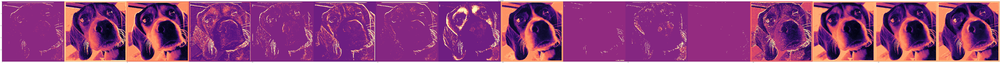

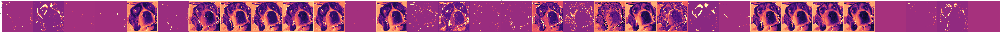

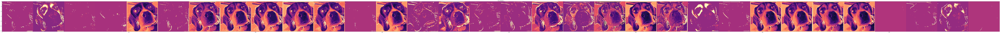

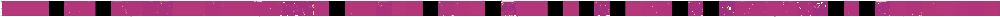

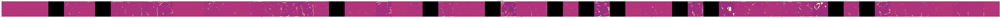

In [ ]:
for NomCapa, filtro in zip(NombreCapas, Filtros):
  if len(filtro.shape) == 4:
    n_filtro = filtro.shape[-1]
    size = filtro.shape[1]
    display_grid = np.zeros((size, size * n_filtro))
    for i in range(n_filtro):
      x = filtro[0, :, :, i]
      x -= x.mean()
      x /= x.std()
      x *= 64
      x += 128
      x = np.clip(x, 0, 255).astype('uint8')
      display_grid[:, i * size : (i + 1) * size] = x
    escala = 300. / n_filtro
    plt.figure(figsize=(escala * n_filtro, escala))
    plt.title(NomCapa)
    plt.grid(False)
    plt.imshow(display_grid, aspect='auto', cmap='magma')

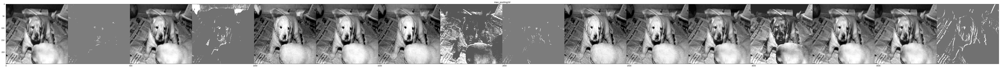

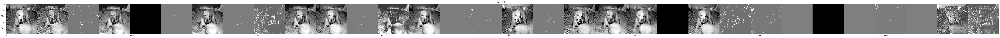

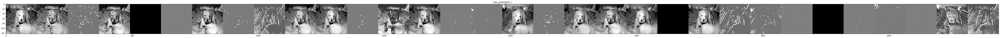

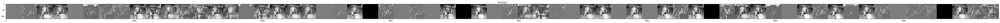

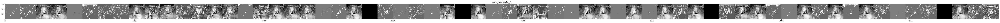

In [ ]:
for NomCapa, filtro in zip(NombreCapas, Filtros):
  if len(filtro.shape) == 4:
    n_filtro = filtro.shape[-1]
    size = filtro.shape[1]
    display_grid = np.zeros((size, size * n_filtro))
    for i in range(n_filtro):
      x = filtro[0, :, :, i]
      x -= x.mean()
      x /= x.std()
      x *= 64
      x += 128
      x = np.clip(x, 0, 255).astype('uint8')
      display_grid[:, i * size : (i + 1) * size] = x
    escala = 300. / n_filtro
    plt.figure(figsize=(escala * n_filtro, escala))
    plt.title(NomCapa)
    plt.grid(False)
    plt.imshow(display_grid, aspect='auto', cmap='gray')

Y entrenado el modelo se puede cargar una imagen al modelo para esperar la clasificacion de la imagen, retornando un arreglo que posee las probabilidades que parecidos hay entre la imagen y cada una de las razas, se imprime por pantalla

In [ ]:
import numpy as np
from google.colab import files
from keras.preprocessing import image

uploaded = files.upload()

for fn in uploaded.keys():# predicting images
  path = '/content/' + fn
  img = image.load_img(path, target_size=(500, 500))
  x = image.img_to_array(img)
  x = np.expand_dims(x, axis=0)

  classes = model.predict(x, batch_size=10)
  resultado=classes[0]
  respuesta=np.argmax(resultado)
  print(resultado)
  print(respuesta)
  if respuesta == 0 :
    print("alta")
  elif respuesta == 1 :
    print("media")
  elif respuesta == 2:
    print("baja")
Capas_intermedias = [layer.output for layer in model.layers[1:]]
visualizacion_model = tf.keras.models.Model(inputs = model.input, outputs = Capas_intermedias)
img_dir = path
img = load_img(img_dir, target_size=(500, 500))  # Cargando las imagenes
x = img_to_array(img)  # Convierte la imagen en un arreglo
x = x.reshape((1,) + x.shape)
# Normaliza la imagen
x /= 255
Filtros = visualizacion_model.predict(x)
NombreCapas = [layer.name for layer in model.layers[1:]]
# El siguiente codigo muestra las imagenes y su procesamiento a traves de la red neuronal
for NomCapa, filtro in zip(NombreCapas, Filtros):
  if len(filtro.shape) == 4:
    n_filtro = filtro.shape[-1]
    size = filtro.shape[1]
    display_grid = np.zeros((size, size * n_filtro))
    for i in range(n_filtro):
      x = filtro[0, :, :, i]
      x -= x.mean()
      x /= x.std()
      x *= 64
      x += 128
      x = np.clip(x, 0, 255).astype('uint8')
      display_grid[:, i * size : (i + 1) * size] = x
    escala = 300. / n_filtro
    plt.figure(figsize=(escala * n_filtro, escala))
    plt.title(NomCapa)
    plt.grid(False)
    plt.imshow(display_grid, aspect='auto', cmap='viridis')


TypeError: ignored

# Conclusiones.

Hasta el momento se ha desarrollado el diseño, desarrollo de la base de datos , generacion de datos y un conjunto de consultas en sql, todo esto con el fin de simular el hipotetico estado de un negocio de hoteles, bajo ciertas reglas que en principio seran definidas por los propietarios, pero que en este caso se eligieron bajo ciertas suposiciones, es decir , puede que un negocio no necesite abarcar tantas tablas o por el contrario sean insuficientes para las espectativas del propietario, sin embargo proporciona una estructura que intenta cubrir varios aspectos relevantes en la dinamica de este tipo de negocio. Otro de nuestros objetivos es poder enriquecer nuestra base de datos o por lo menos orientar parte de las decisiones que se vallan a tomar basandonos en compararaciones con datos que se encuentran en la web usando metodos de automatizacion para obtener todos esos datos que son publicos en las paginas web, en este caso se uso selenium para automatizar la recopilacion de datos usando el navegador,como se observo en el codigo de la seccion de scraping, se obtuvo los hoteles que brindaban servicios para cierto tipo de fechas, en general este metodo sirve para enriquecer la base con datos directos de los competidores y usando reiteradamente en intervalos de tiempo podria proporcionar los suficientes datos para evaluar los comportamientos del mercado.  